# GUC NETW 1003 Kmeans Assginmnet

Objective: exercise is to learn how to use build and use  kmeans clustering algortrithm    

At the end of this lab you will be able to
> 1. Build and run a K-means algorithm.
> 2. Know how to evalute K-means Algorithm
> 2. Understand the effect of the parmeters ont he perfromance of the algorithm .
> 3. Understand the effect of distance.

## 1. Wirte K means function

import required libraries

In [ ]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt
from sklearn.datasets import make_blobs
from sklearn.datasets import make_moons
from scipy.stats import pearsonr


> ### 1.1. Code for the distance function

write a function to calculate the distance between a set of cluster centroids and all the data points

Cluster_Distances = GUC_Distance ( Cluster_Centroids, Data_points, Distance_Type)
* The function shoud be able to handel data points with any number of features and any number of points
* The function should be able to handle any K number of cluster centroids
* To inrease speed do that in matrix format using numpy
* This should produce a matrix with rows equal to data points columns equal K
* You should be able to calculate different types of Distance. In this assginmnet you are required to implement the following two
    - Ecluidian distance
    - Pearson correlation distance
  

In [ ]:
def GUC_Distance ( Cluster_Centroids, Data_points, Distance_Type ):
## write code here for the Distance function here #
    """
    Calculate distances between cluster centroids and data points.

    Parameters:
    Cluster_Centroids (numpy.ndarray): Array of cluster centroids with shape (K, num_features).
    Data_points (numpy.ndarray): Array of data points with shape (num_points, num_features).
    Distance_Type (str): Type of distance to calculate. Either 'euclidean' or 'pearson'.

    Returns:
    numpy.ndarray: Matrix of distances with shape (num_points, K).
    """

    num_points = Data_points.shape[0]
    num_clusters = Cluster_Centroids.shape[0]
    print(num_clusters)
    # if Cluster_Centroids.ndim == 1:
    #     # If it is a 1D array, convert it to a 2D array with a single row
    #     Cluster_Centroids = Cluster_Centroids.reshape(1, -1)

    if Distance_Type == 'euclidean':
        # Calculate Euclidean distances
        Cluster_Distance = np.sqrt(np.sum((Data_points[:, np.newaxis, :] - Cluster_Centroids) ** 2, axis=2))
    elif Distance_Type == 'pearson':
        Cluster_Distance = np.zeros((num_points,num_clusters))
        for i in range(num_clusters):
          current_centroid = Cluster_Centroids[i]
          # print('CUREEENNNNNTTTT INDEXXXXX : ', i)
          # print('CURENTT CENTOIDDDDDD :::', current_centroid)
          data_mean = np.mean(Data_points, axis=0)
          centroid_mean = np.mean(Cluster_Centroids, axis = 0)
          data_centered = Data_points - data_mean
          centroid_centered = current_centroid - centroid_mean
          numerator = np.sum(data_centered * centroid_centered.transpose(), axis=1 )
          cluster_std = np.sqrt(np.sum(centroid_centered ** 2))
          data_std = np.sqrt(np.sum(data_centered ** 2 ))
          denominator = data_std*cluster_std
          # print( 'DATAAAA denominator SHAPEEEE :::: ',denominator.shape)
          # print('CLUSTER denominator SHAPEEEE ::::: ', denominator)
          r = numerator/denominator
          Cluster_Distance[:, i] = np.transpose(1 - r)
          # print('EL MAFROUDDD YKOUN KEDA :::', 1-r)
          # print( 'DATAAAA OUT SHAPEEEE :::: ',Cluster_Distance[:, i].shape)
          # print('CLUSTER OUT SHAPEEEE ::::: ', Cluster_Distance)
        # # Calculate Pearson correlation distances
        # # Cluster_Distance = np.zeros((num_points, num_clusters))
        # # for i in range(num_points):
        # #     for j in range(num_clusters):
        # #         Cluster_Distance[i, j] = 1 - pearsonr(Data_points[i], Cluster_Centroids[j])
        # print('Data Points: ', Data_points)
        # print('Cluster Centroids: ', Cluster_Centroids)
        # data_mean = np.mean(Data_points)
        # centroid_mean = np.mean(Cluster_Centroids)
        # # data_mean = np.mean(Data_points, axis=1, keepdims=True)
        # # centroid_mean = np.mean(Cluster_Centroids, axis=1 , keepdims=True)
        # data_centered = Data_points - data_mean
        # centroid_centered = Cluster_Centroids - centroid_mean
        # numerator = np.sum(data_centered * centroid_centered.transpose(), axis =  2)
        # # numerator = np.sum(data_centered[:, np.newaxis, :] * centroid_centered, axis=2)
        # data_std = np.sqrt(np.sum((data_centered)**2))
        # cluster_std = np.sqrt(np.sum((centroid_centered)**2, axis = 1))
        # # data_std = np.std(Data_points, keepdims=True)
        # # cluster_std = np.std(Cluster_Centroids, keepdims=True)
        # denominator = (data_std * cluster_std)
        # print('data std', data_std )
        # print('centroid std', cluster_std)
        # print('data_centerd' , data_centered)
        # print('centroid_centerd', centroid_centered)
        # Cluster_Distance = 1-(numerator / denominator)
    else:
        raise ValueError("Distance_Type should be either 'euclidean' or 'pearson'.")

    return Cluster_Distance


> ### 1.2. Code for K means function

> Loop until a stopping condition

> > in the loop do the following
> > 1. Cluster Assginmnet
> > > * Use the GUC_Distance to calculate between each cluster head and all the points
> > > * Find the value and index of the minimum distance  for each row.
> > > * for each point in the row use the index of the minmum distance to represent the cluster Centroid that this point will belong to.
> > > * Calculate and record the mean square distance for each cluster  
> > > * Use the mean square distances to calculate a stopping condition (e.g the sum of mean distances)
> > 2. Updtate Centroids  
> > > * Update the value for the cluster heads by calculating the mean value for the points in each cluster
> > >  * Calculate the Cluster Metric (Distortion Function)
> > > > a number indicating the how good the clusters are . An example cluster metric is the  (sum of squared error between each point and its cluster center)

In [ ]:
def GUC_Kmean ( Data_points, Number_of_Clusters,  Distance_Type ):

    np.random.seed(45)
    centroids_indices = np.random.choice(len(Data_points), Number_of_Clusters, replace=False)
    Cluster_Centroids = Data_points[centroids_indices]

    prev_cluster_distances = np.inf
    epsilon = 1e-4
    i = 0
    while True:
        i+=1
        distances = GUC_Distance(Cluster_Centroids, Data_points, Distance_Type)
        closest_cluster_indices = np.array(np.argmin(distances, axis=1))
        num_zeros=np.zeros((len(closest_cluster_indices)- Number_of_Clusters, len(Data_points[0])))
        Centroids= Cluster_Centroids
        Centroids = np.concatenate((Centroids, num_zeros), axis = 0)
        km=[]
        km.append(closest_cluster_indices)
        km.append(Centroids)

        col = ['labels_','cluster_centers_']
        km = ListWithColumns(km,col)

        Cluster_Metric = 0

        data_length = len(Data_points)
        for i in range ( data_length) :

            Cluster_Metric += abs(distances[i][closest_cluster_indices[i]])


        Final_Cluster_Distance = Cluster_Metric
        if abs(prev_cluster_distances - Final_Cluster_Distance) < epsilon:
            break
        prev_cluster_distances = Final_Cluster_Distance

        for i in range(Number_of_Clusters):
            print("mean of centroid : ", i, " is : ", np.mean(Data_points[closest_cluster_indices == i]))
            Cluster_Centroids[i] = np.mean(Data_points[closest_cluster_indices == i], axis=0)

    display_cluster(Data_points,Number_of_Clusters, km)
    return [ Final_Cluster_Distance , Cluster_Metric ]

## 2. Display Results

* below is a an example fuction that displayes Clusters in 2D

* You need to change the function so that is can display an n dimension data in the form of pairs of subplot 2D figures

* The function is a helper function that is originaly be found in
https://www.coursera.org/learn/ibm-unsupervised-learning/


In [ ]:
import numpy as np, pandas as pd, seaborn as sns, matplotlib.pyplot as plt

> #### 2.1. helper Display function

In [ ]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X, num_clusters, km):
    fig, ax = plt.subplots(len(X[0]),len(X[0]), figsize=(6*len(X[0]), 6*len(X[0])))
    color = ['b', 'r', 'g', 'c', 'm', 'y', 'k', 'violet', 'aqua', 'pink']  #List colors
    alpha = 0.5
    category = pd.DataFrame(color)
    s = 20
    if num_clusters == 0:
        plt.scatter(X[:,0],X[:,1],c = color[0],alpha = alpha,s = s)
    else:
      for i in range(num_clusters):
        for m in range(len(X[0])):
          for n in range(len(X[0])):
            ax[m,n].scatter(X[km.labels_==i,m],X[km.labels_==i,n], c = color[i])
            ax[m,n].scatter(km.cluster_centers_[i,m],km.cluster_centers_[i,n], c= color[i], marker='x' )
        fig.show()



In [ ]:
class ListWithColumns:
    def __init__(self, data, column_names):
        self.data = data
        self.column_names = column_names
        self.column_dict = {name: i for i, name in enumerate(column_names)}

    def __getattr__(self, name):
        if name in self.column_names:
            column_index = self.column_dict[name]
            return self.data[column_index]
        else:
            raise AttributeError(f"'ListWithColumns' object has no attribute '{name}'")

# Example data and column names
data = [[1, 'John', 25],
        [2, 'Jane', 30],
        [3, 'Doe', 35]]
column_names = ['ID', 'Name', 'Age']

# Create a ListWithColumns object
list_with_columns = ListWithColumns(data, column_names)

# Access columns using dot notation
print(list_with_columns.ID)   # Access the 'ID' column
print(list_with_columns.Name) # Access the 'Name' column
print(list_with_columns.Age)  # Access the 'Age' column


[1, 'John', 25]
[2, 'Jane', 30]
[3, 'Doe', 35]


> #### 2.2. Example 1 : Circular Data Gen and display

* below is an example of how to use the funciton
  *  prepare the figure size and background
   > * this part can be replaced by a number of subplots
  
  * Produce a data set that represent the x and y o coordinates of a circle
   > * this part can be replaced by data that you import froma file
  
  * Data is displayed
   > * to display the data only it is assumed that the number of clusters is zero which is the default of the fuction

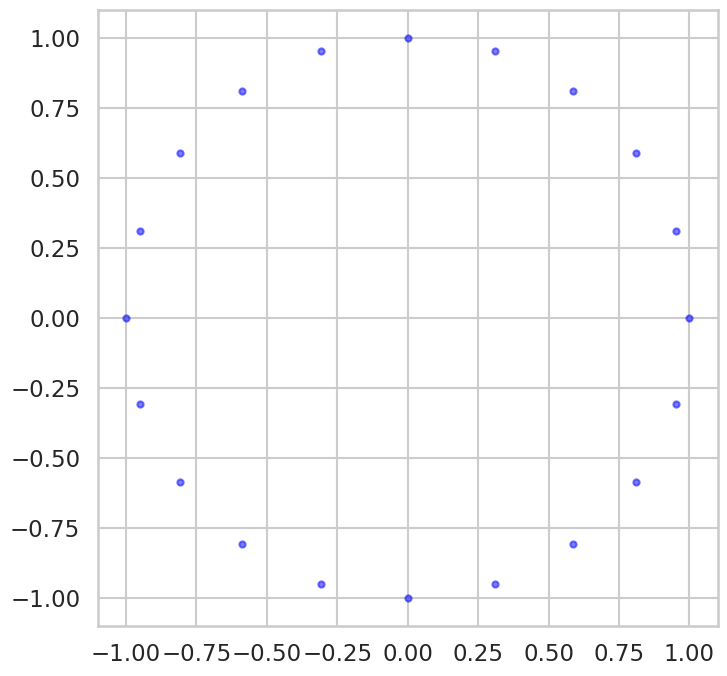

In [ ]:
# prepare the figure sise and background
# this part can be replaced by a number of subplots
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")
# Produce a data set that represent the x and y o coordinates of a circle
# this part can be replaced by data that you import froma file
angle = np.linspace(0,2*np.pi,20, endpoint = False)
X = np.append([np.cos(angle)],[np.sin(angle)],0).transpose()
# Data is displayed
# to display the data only it is assumed that the number of clusters is zero which is the default of the fuction
display_cluster(X)

> #### 2.3. Example 2 : Multi blob Data Gen and display

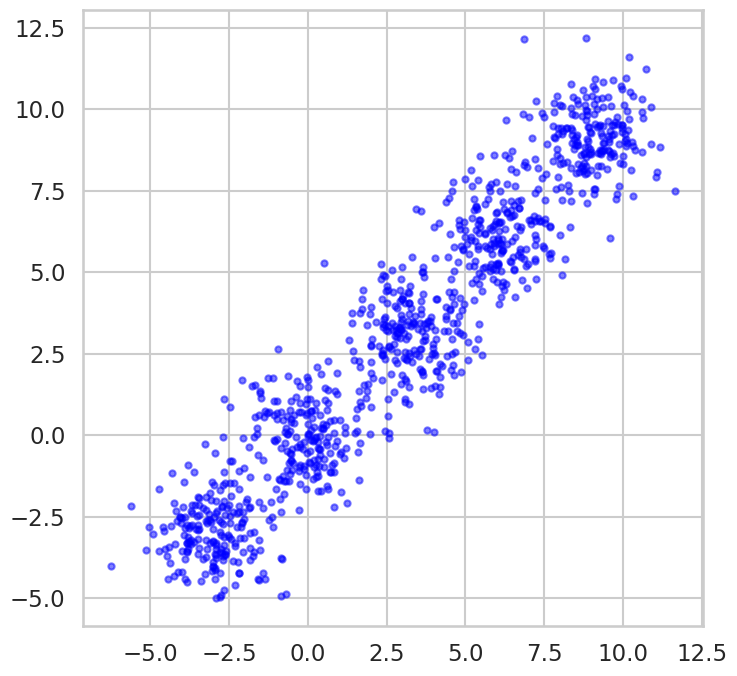

In [ ]:
n_samples = 1000
n_bins = 4
centers = [(-3, -3), (0, 0), (3, 3), (6, 6), (9,9)]
X, y = make_blobs(n_samples=n_samples, n_features=2, cluster_std=1.0,
                  centers=centers, shuffle=False, random_state=42)
display_cluster(X)


#### 2.3. Example 3 : moons Data Gen and display

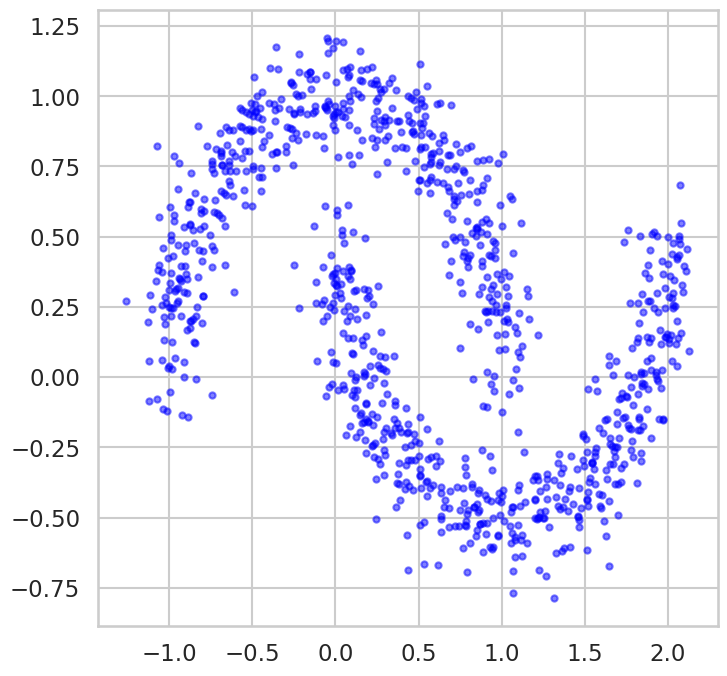

In [ ]:
n_samples = 1000
X, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)
display_cluster(X)

## 3. Testing the GUC_Kmean function on Simple 2D
1. Apply the GUC_Kmean fucntion to 2D Data provided by example 1, Example 2 and Example 3
2. Try a varing number of cluster centriods that range from 2 to 10 clusters on each set
3. Display your results.
4. plot the Cluster perfromance Metric versus the number of clusters
4. Change the distance function and repeat the above steps

2
mean of centroid :  0  is :  -0.13968022466674201
mean of centroid :  1  is :  0.139680224666742
2
mean of centroid :  0  is :  -0.13968022466674201
mean of centroid :  1  is :  0.139680224666742
2
Final Cluster Distance: 14.483478712220357
Cluster Metric: 14.483478712220357
3
mean of centroid :  0  is :  -0.3158548752503088
mean of centroid :  1  is :  -0.3904180968340978
mean of centroid :  2  is :  0.5110639236673578
3
mean of centroid :  0  is :  -0.2612054112383943
mean of centroid :  1  is :  -0.35824293993814416
mean of centroid :  2  is :  0.568270788328232
3
mean of centroid :  0  is :  -0.2612054112383943
mean of centroid :  1  is :  -0.35824293993814416
mean of centroid :  2  is :  0.568270788328232
3
Final Cluster Distance: 10.195414207920459
Cluster Metric: 10.195414207920459
4
mean of centroid :  0  is :  -0.4068369661375106
mean of centroid :  1  is :  -0.3904180968340978
mean of centroid :  2  is :  0.3105452106671133
mean of centroid :  3  is :  0.5796492530496041
4


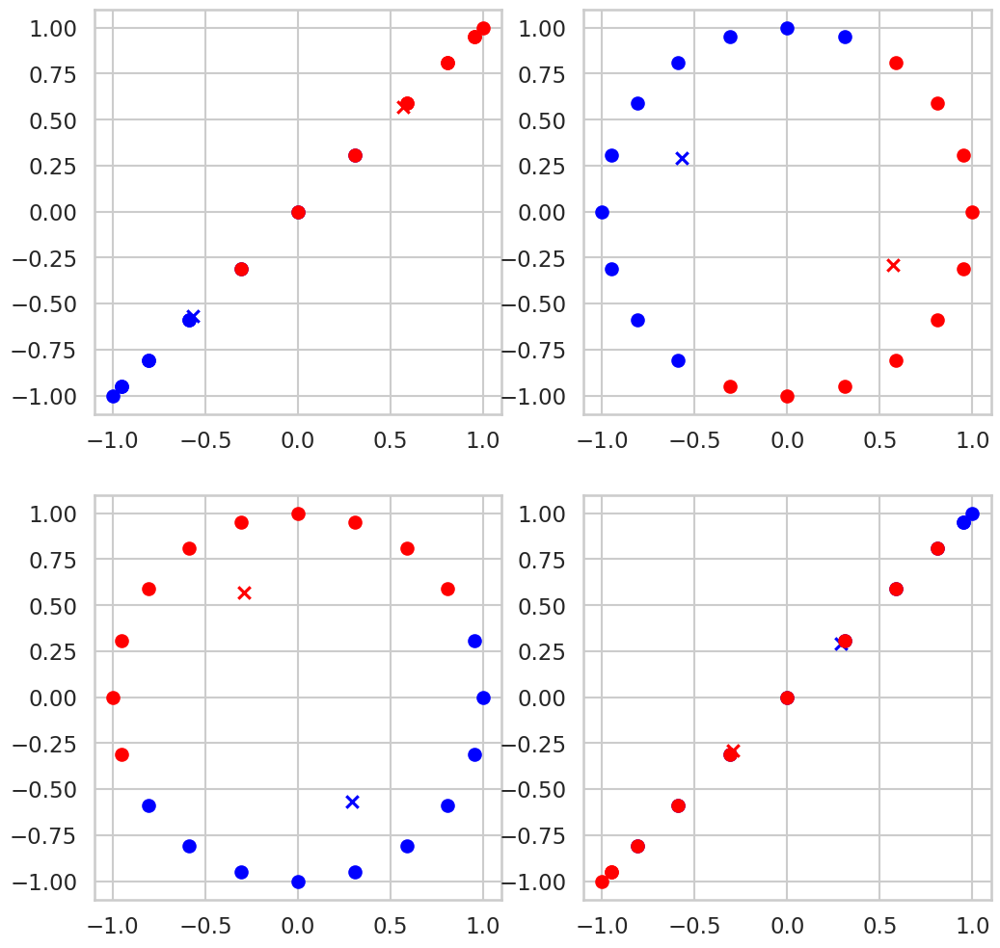

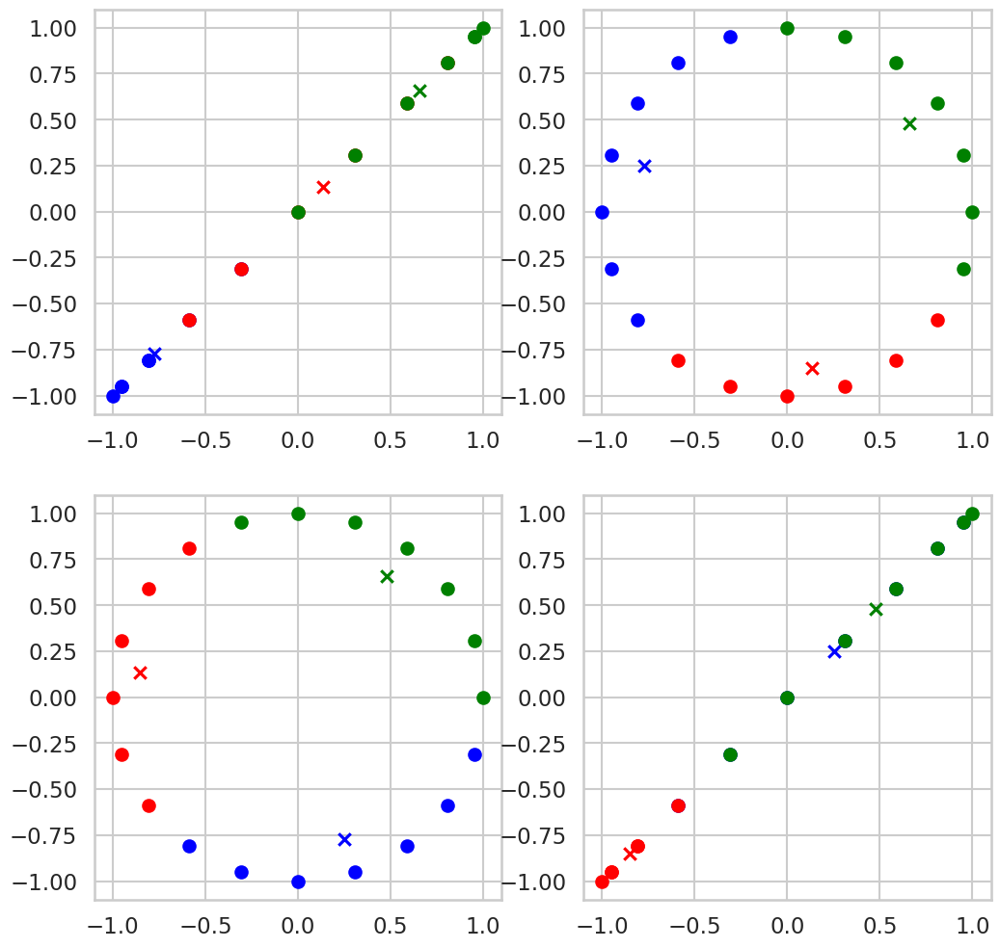

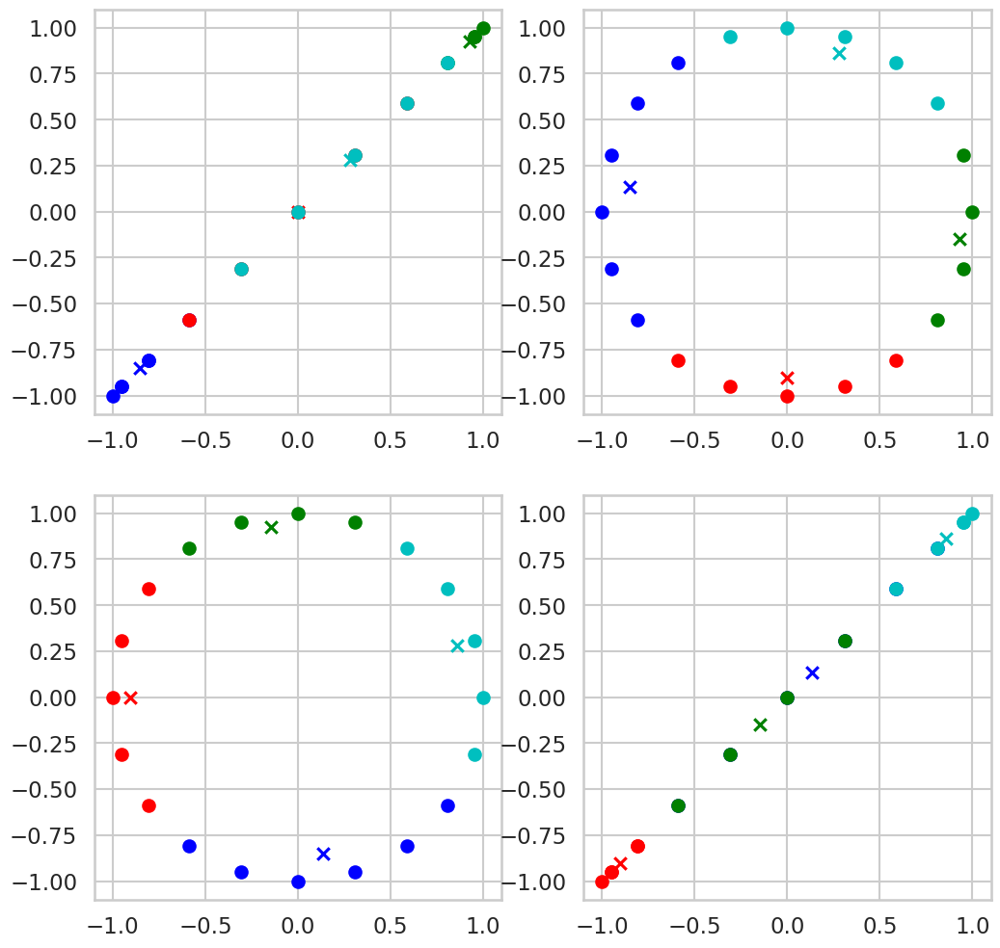

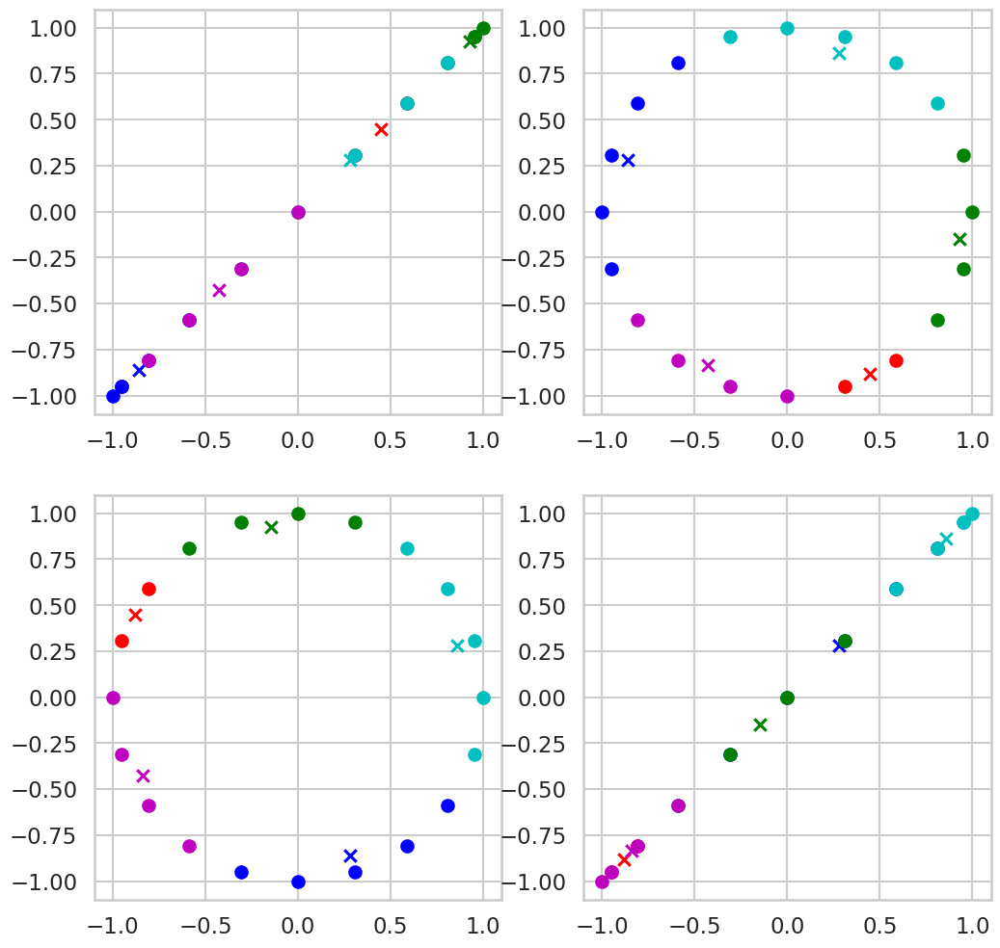

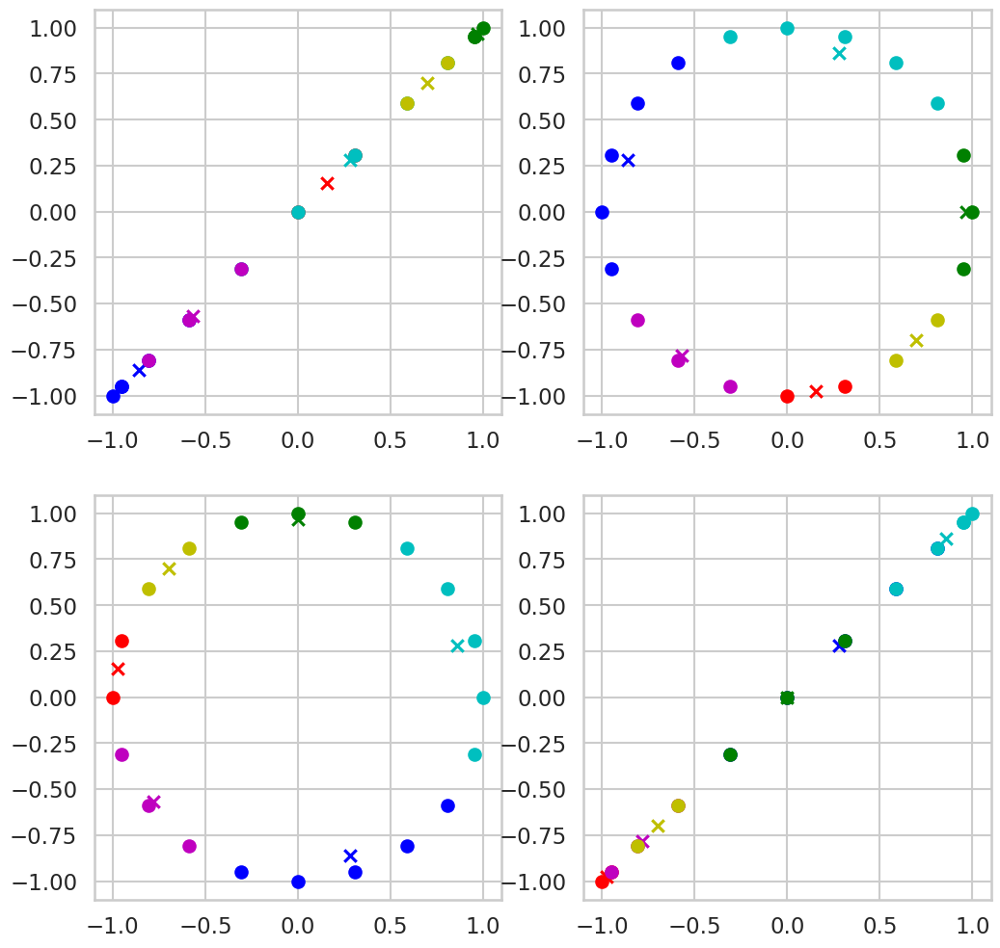

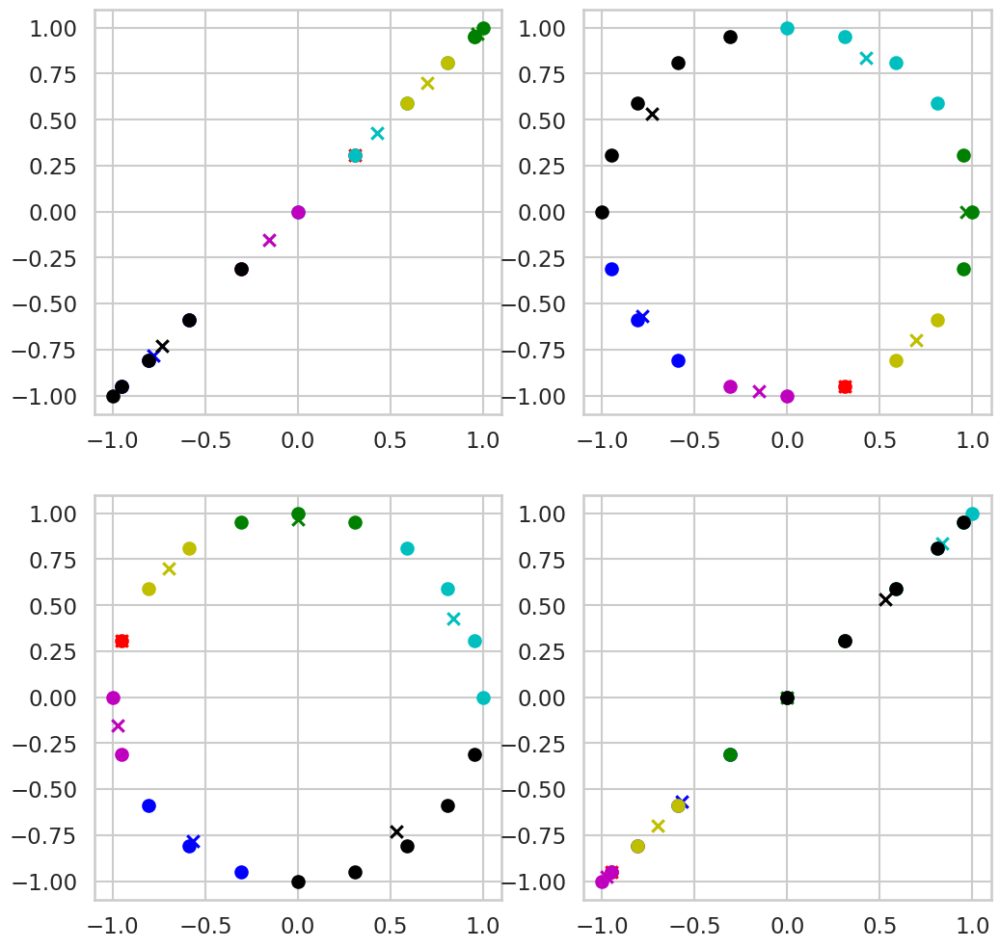

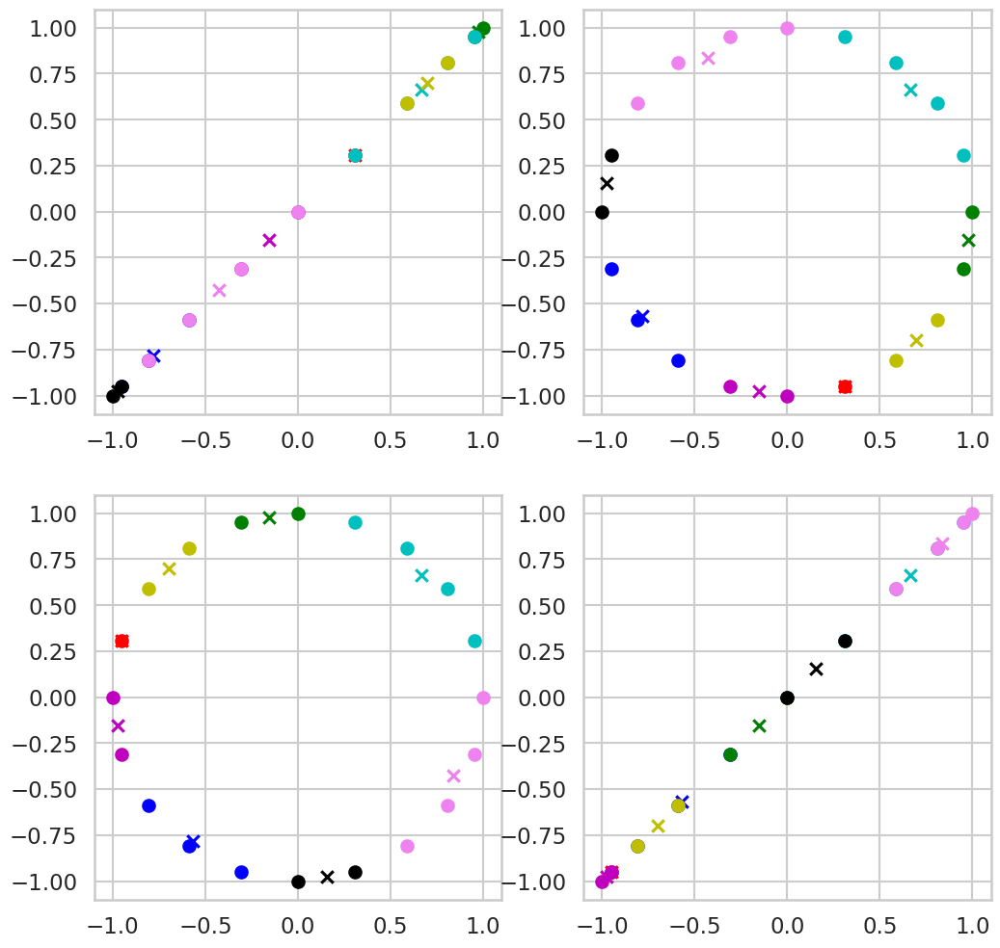

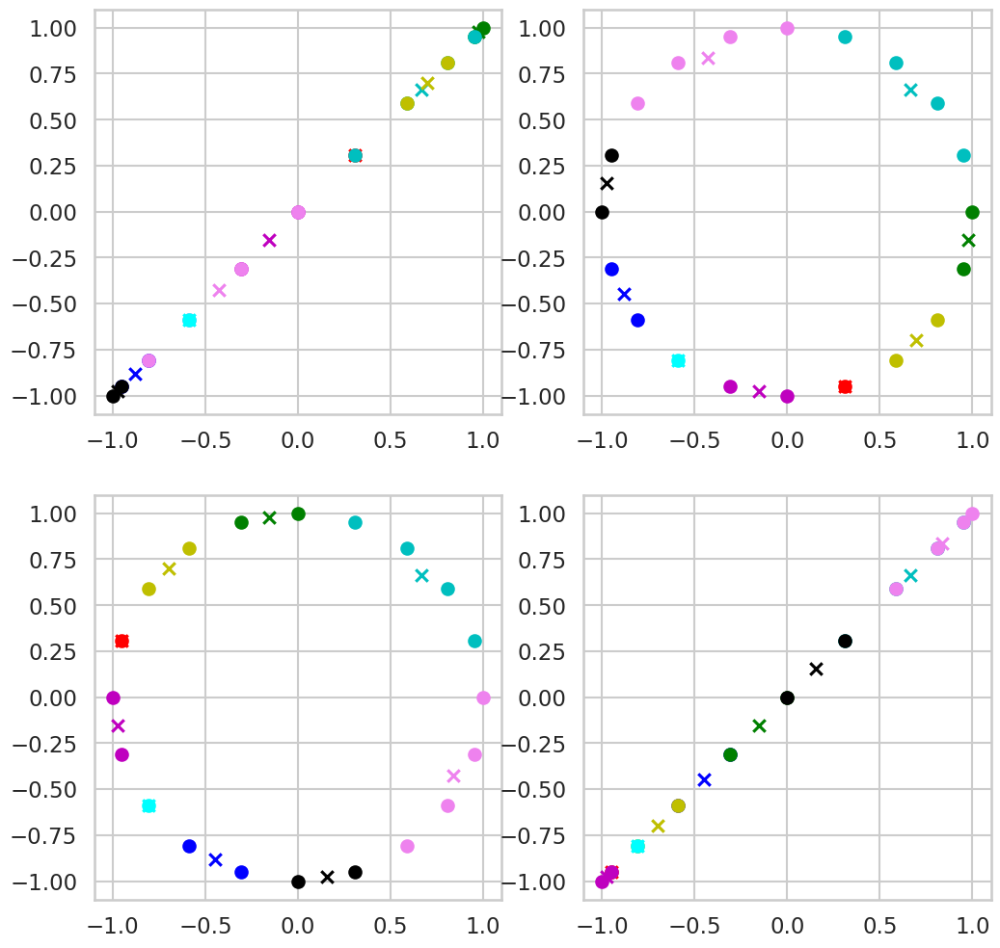

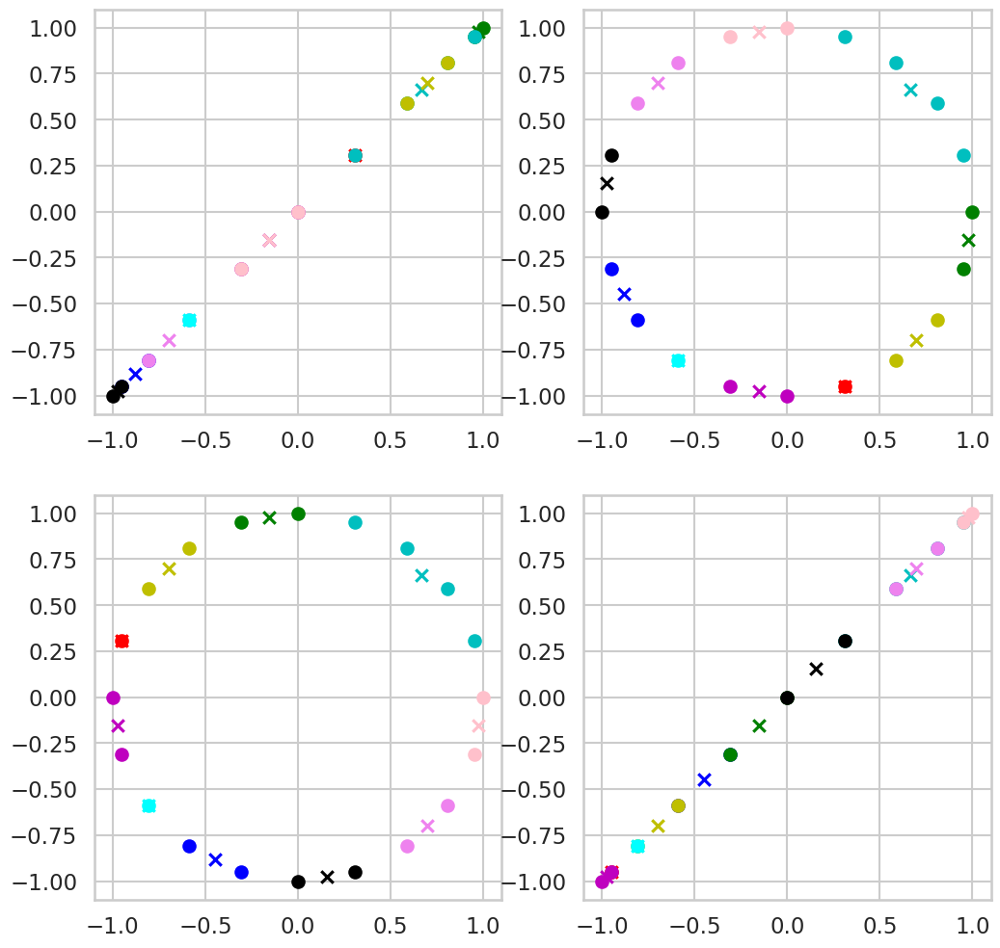

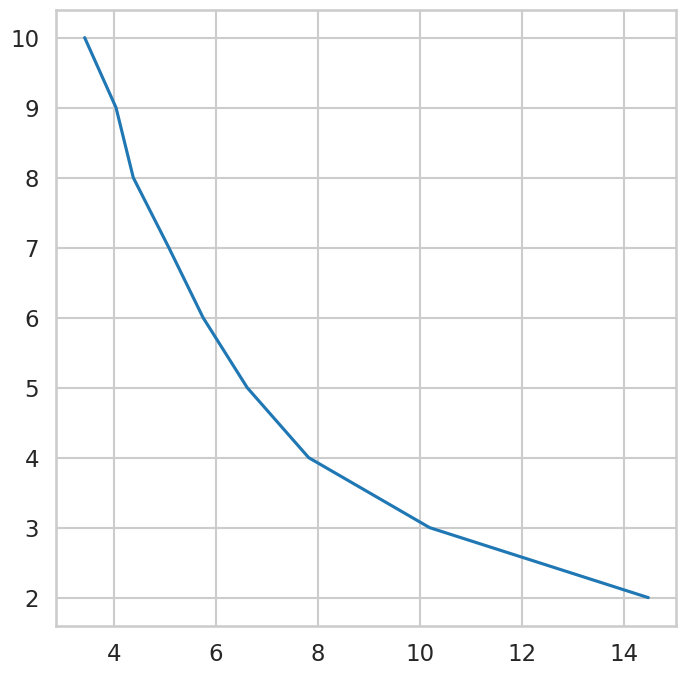

In [ ]:
# prepare the figure sise and background
# this part can be replaced by a number of subplots
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")
# Produce a data set that represent the x and y o coordinates of a circle
# this part can be replaced by data that you import froma file
angle = np.linspace(0,2*np.pi,20, endpoint = False)
X = np.append([np.cos(angle)],[np.sin(angle)],0).transpose()
# Data is displayed
# to display the data only it is assumed that the number of clusters is zero which is the default of the fuction
distances=[]
a = [j for j in range (2,11)]
for i in range (2, 11):
  Number_of_Clusters = i
  Distance_Type = 'euclidean'
  Final_Cluster_Distance, Cluster_Metric = GUC_Kmean(X, Number_of_Clusters, Distance_Type)
  print("Final Cluster Distance:", Final_Cluster_Distance)
  print("Cluster Metric:", Cluster_Metric)
  distances.append(Final_Cluster_Distance)
  #display_cluster(X,Number_of_Clusters)
plt.figure()
plt.plot(distances,a)



2
mean of centroid :  0  is :  -0.18425809109113367
mean of centroid :  1  is :  0.22520433355583006
2
Final Cluster Distance: 17.17640448402887
Cluster Metric: 17.17640448402887
3
mean of centroid :  0  is :  -0.3158548752503088
mean of centroid :  1  is :  -0.29021130325903083
mean of centroid :  2  is :  0.568270788328232
3
mean of centroid :  0  is :  -0.2612054112383943
mean of centroid :  1  is :  -0.2612054112383945
mean of centroid :  2  is :  0.6094792928895869
3
mean of centroid :  0  is :  -0.2612054112383943
mean of centroid :  1  is :  -0.2612054112383945
mean of centroid :  2  is :  0.6094792928895869
3
Final Cluster Distance: 16.29884735647696
Cluster Metric: 16.29884735647696
4
mean of centroid :  0  is :  -0.4520147021340201
mean of centroid :  1  is :  -0.4520147021340204
mean of centroid :  2  is :  0.3904180968340976
mean of centroid :  3  is :  0.49307910566730184
4
mean of centroid :  0  is :  -0.4520147021340201
mean of centroid :  1  is :  -0.4520147021340204
me

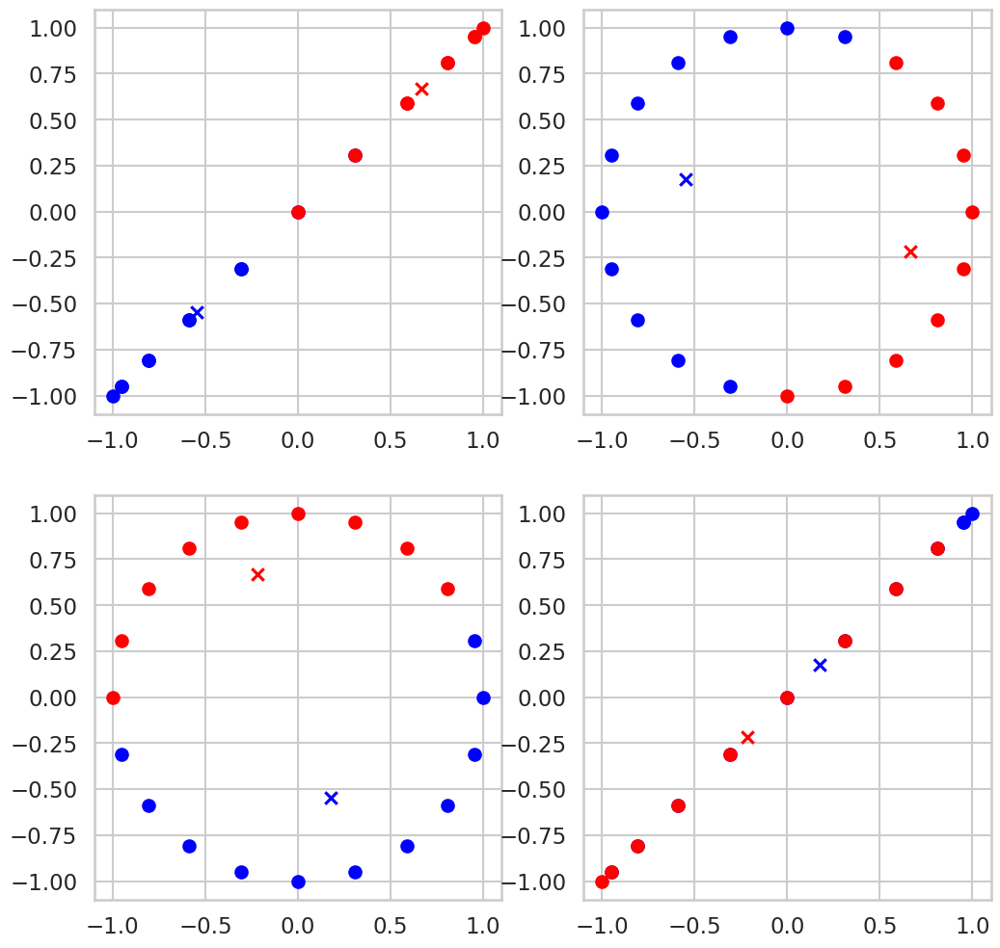

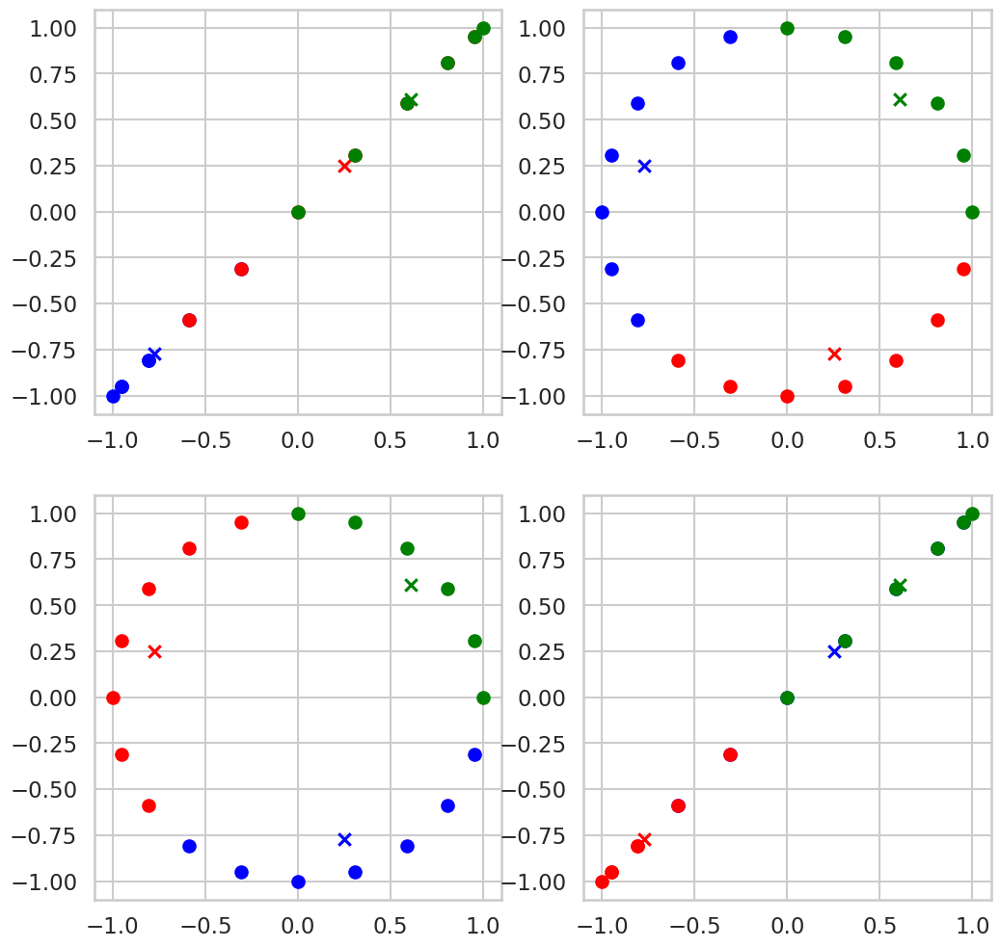

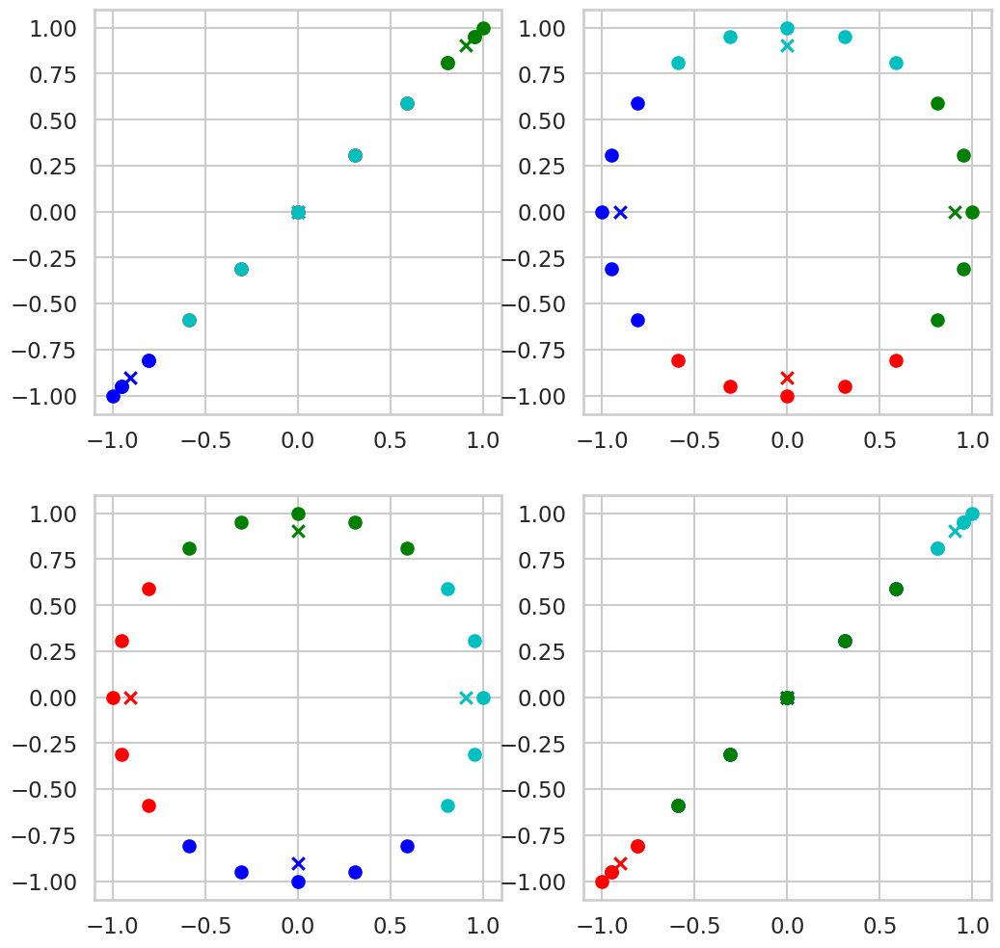

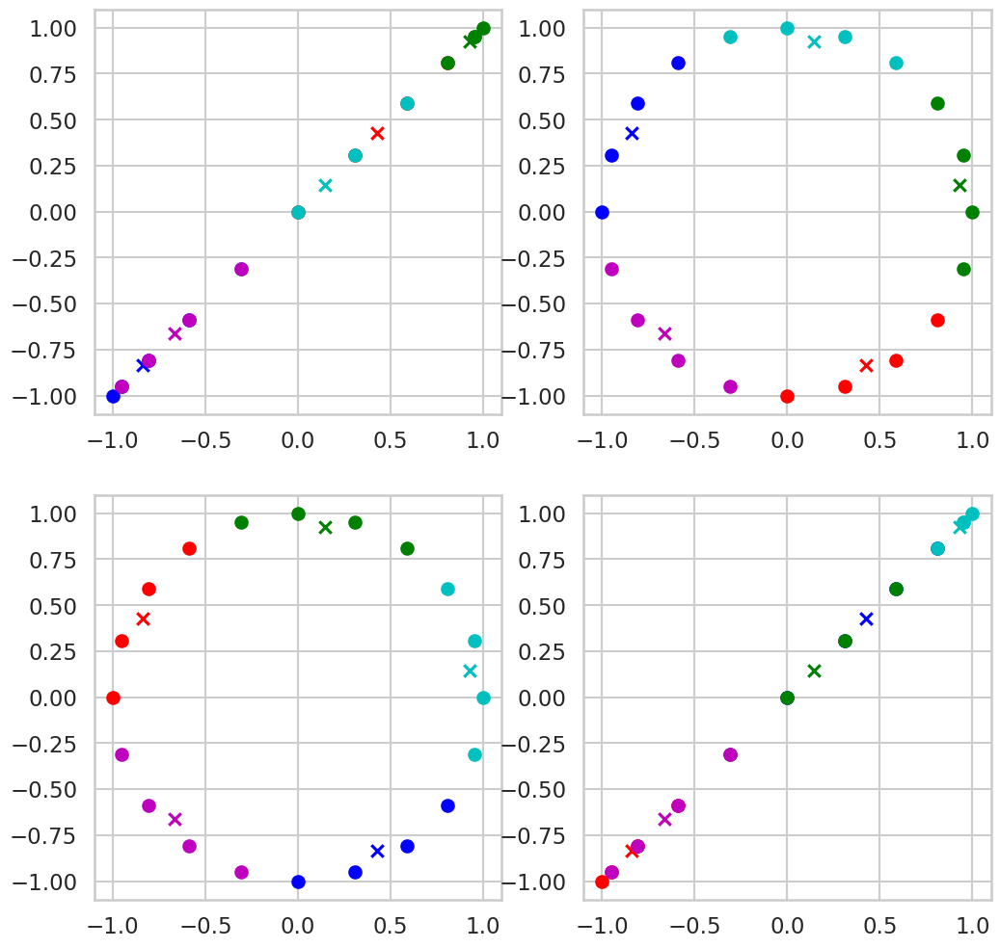

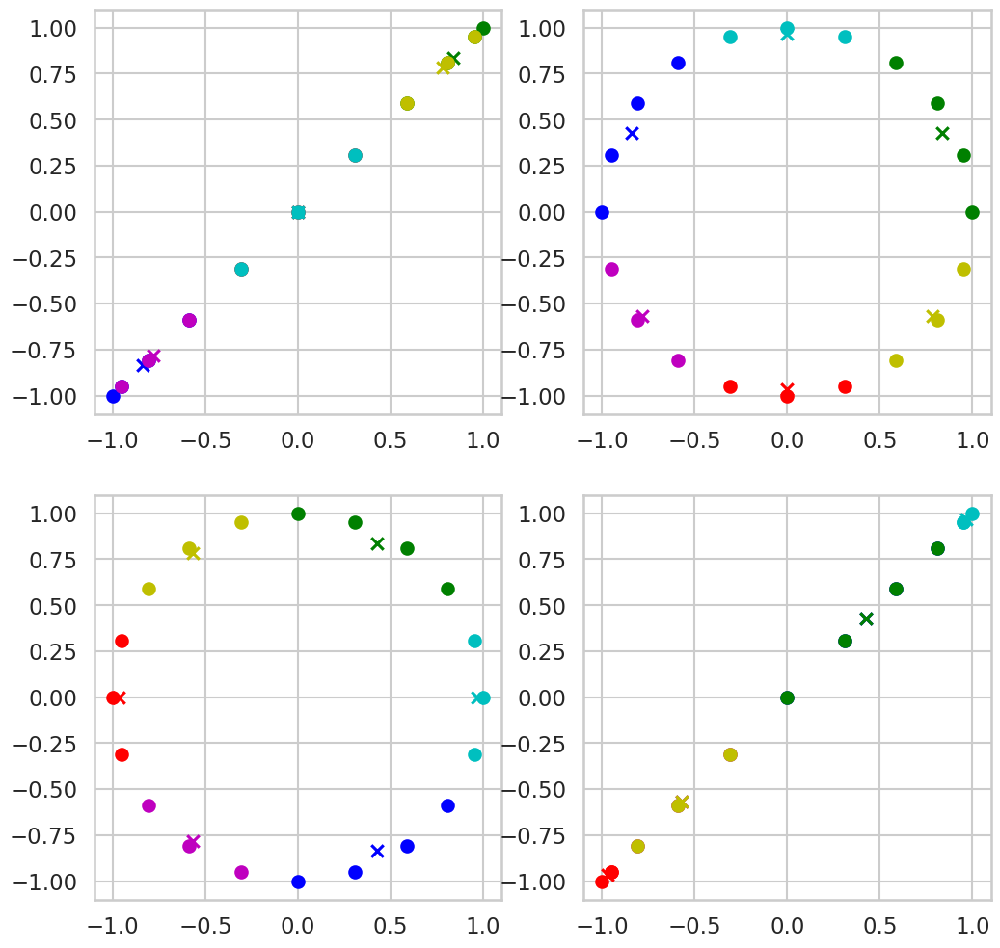

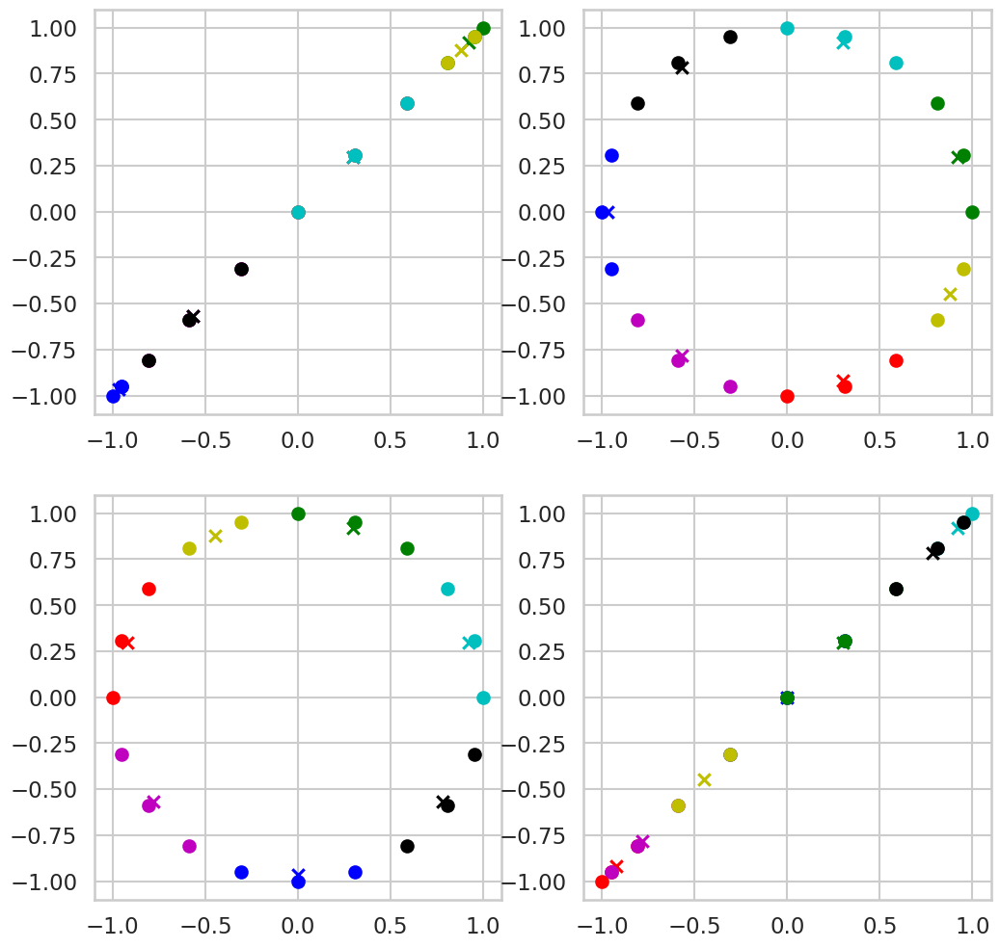

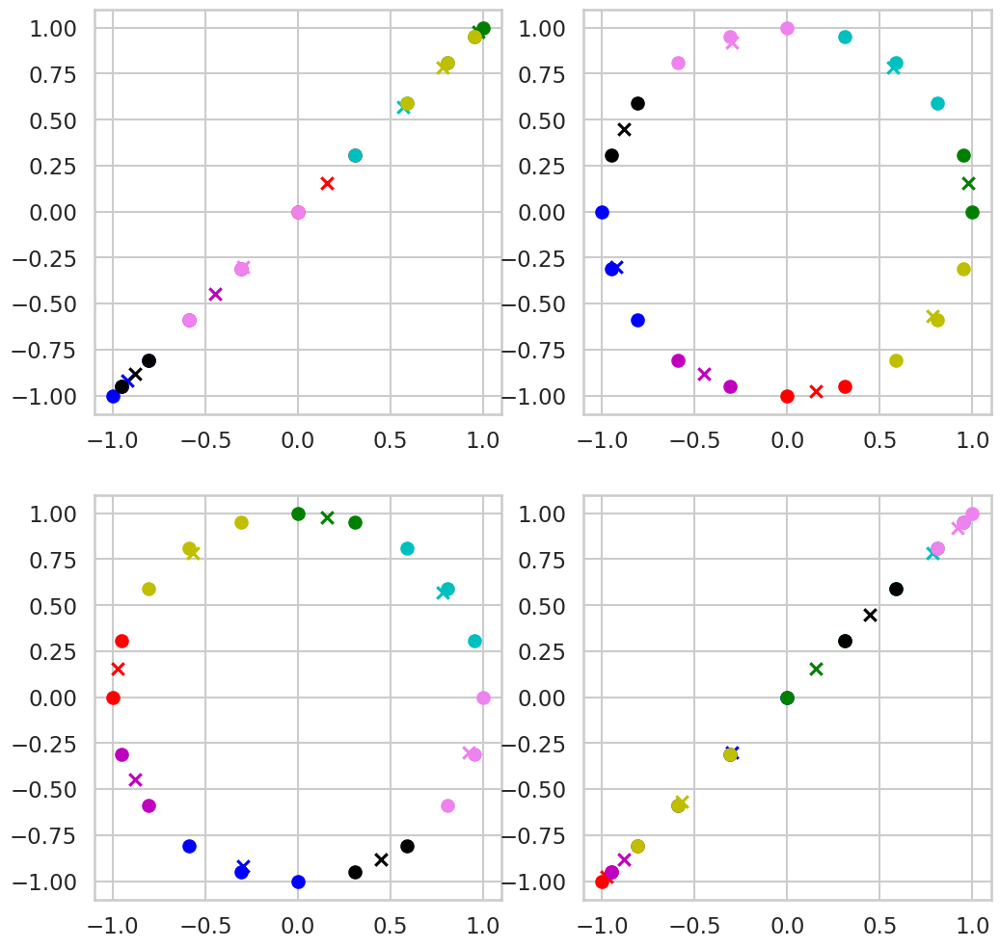

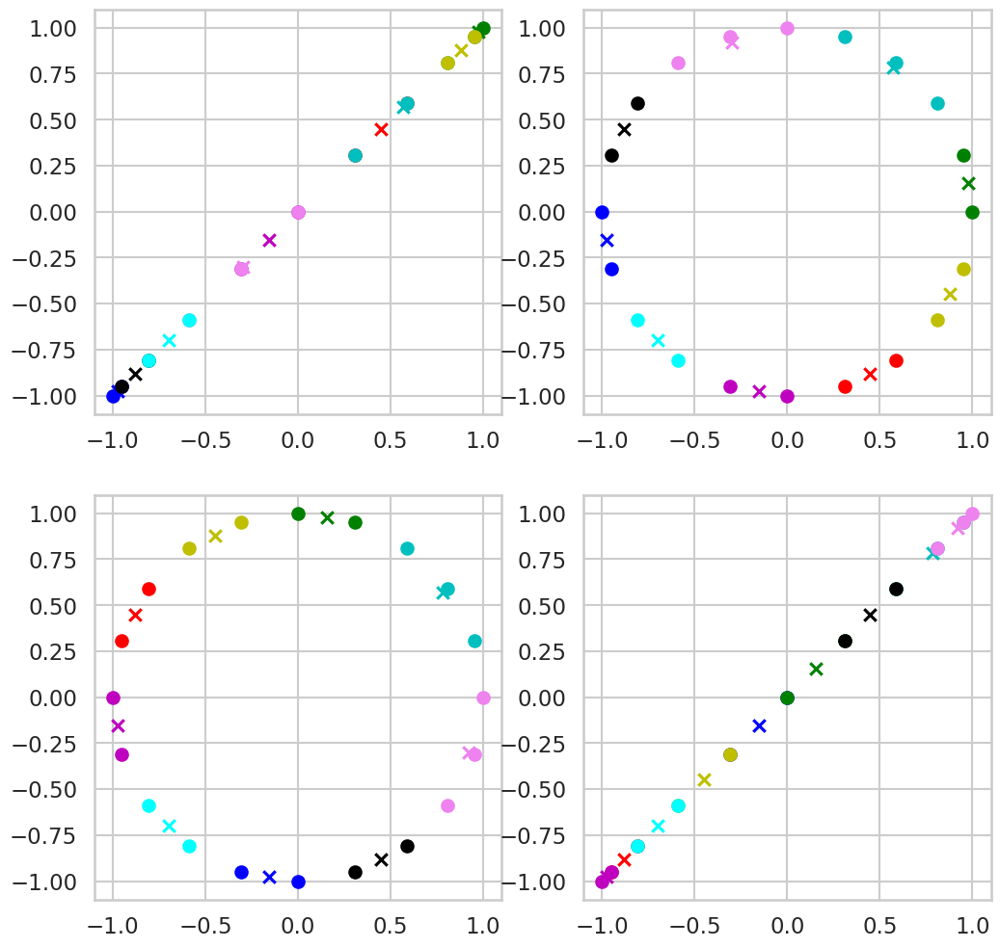

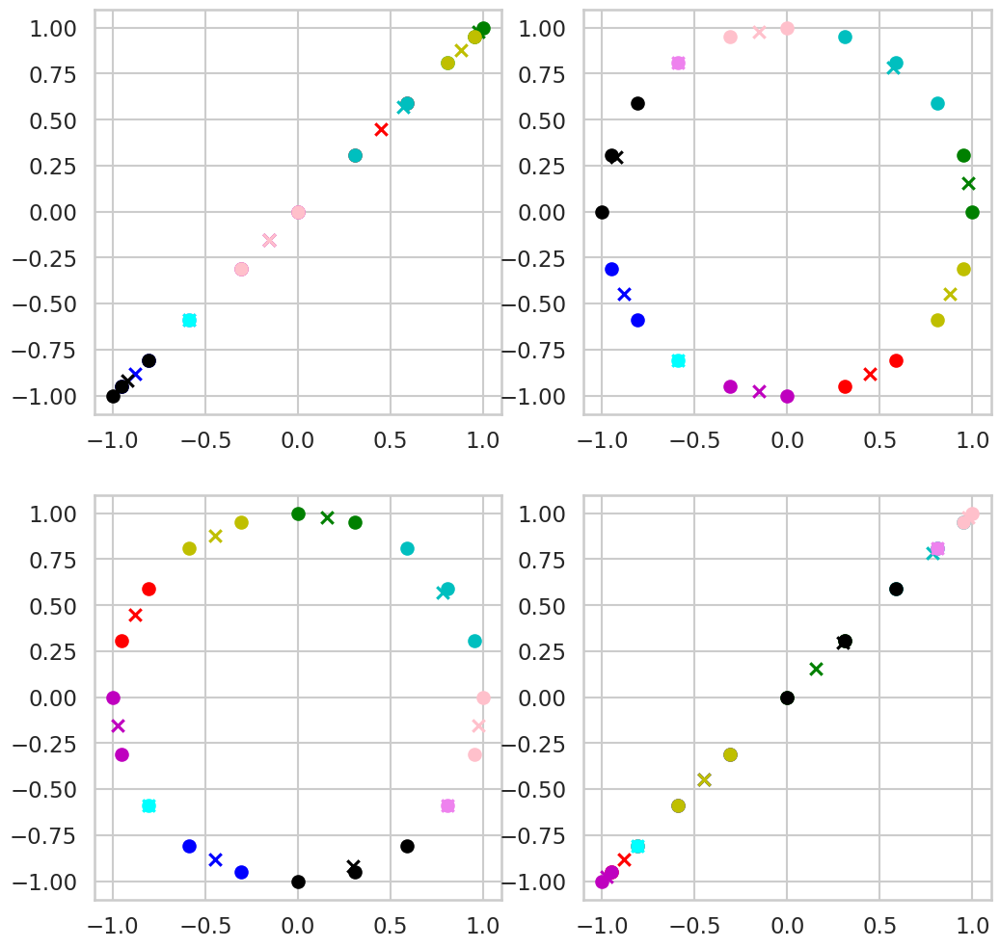

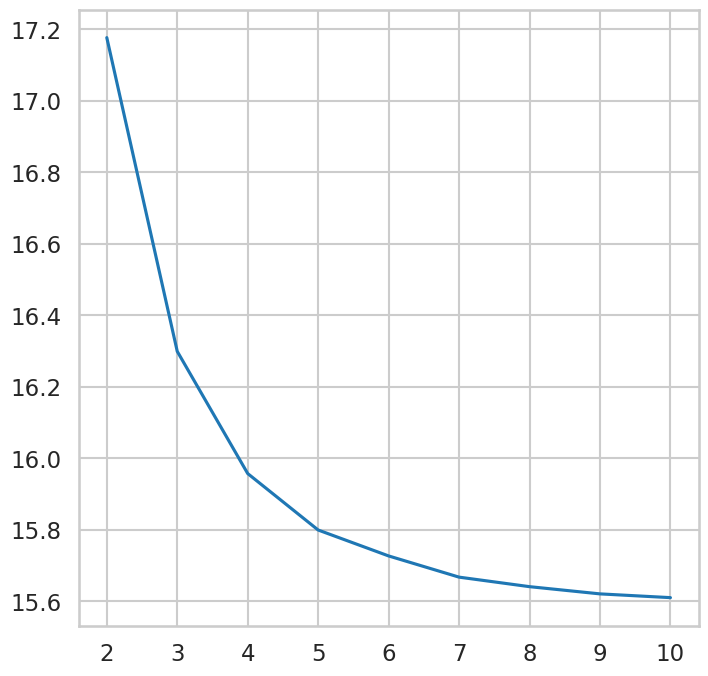

In [ ]:
# prepare the figure sise and background
# this part can be replaced by a number of subplots
plt.rcParams['figure.figsize'] = [8,8]
sns.set_style("whitegrid")
sns.set_context("talk")
# Produce a data set that represent the x and y o coordinates of a circle
# this part can be replaced by data that you import froma file
angle = np.linspace(0,2*np.pi,20, endpoint = False)
X = np.append([np.cos(angle)],[np.sin(angle)],0).transpose()
# Data is displayed
# to display the data only it is assumed that the number of clusters is zero which is the default of the fuction
distances=[]
a = [j for j in range (2,11)]
for i in range (2, 11):
  Number_of_Clusters = i
  Distance_Type = 'pearson'
  Final_Cluster_Distance, Cluster_Metric = GUC_Kmean(X, Number_of_Clusters, Distance_Type)
  print("Final Cluster Distance:", Final_Cluster_Distance)
  print("Cluster Metric:", Cluster_Metric)
  distances.append(Final_Cluster_Distance)
  #display_cluster(X,Number_of_Clusters)
plt.figure()
plt.plot(a,distances)


2
mean of centroid :  0  is :  6.9543176808715055
mean of centroid :  1  is :  -0.5060516594639239
2
mean of centroid :  0  is :  6.822357299701546
mean of centroid :  1  is :  -0.6426094061597287
2
mean of centroid :  0  is :  6.742170419580112
mean of centroid :  1  is :  -0.7266907380852844
2
mean of centroid :  0  is :  6.670475983021227
mean of centroid :  1  is :  -0.8045587313818374
2
mean of centroid :  0  is :  6.586214151135108
mean of centroid :  1  is :  -0.9003186281447393
2
mean of centroid :  0  is :  6.51722622719142
mean of centroid :  1  is :  -0.9820007288683632
2
mean of centroid :  0  is :  6.449307465471467
mean of centroid :  1  is :  -1.0655342981835576
2
mean of centroid :  0  is :  6.402231427127269
mean of centroid :  1  is :  -1.1250046280106873
2
mean of centroid :  0  is :  6.37544243126548
mean of centroid :  1  is :  -1.1593048192542919
2
mean of centroid :  0  is :  6.36206229702321
mean of centroid :  1  is :  -1.1765244086301305
2
mean of centroid :  

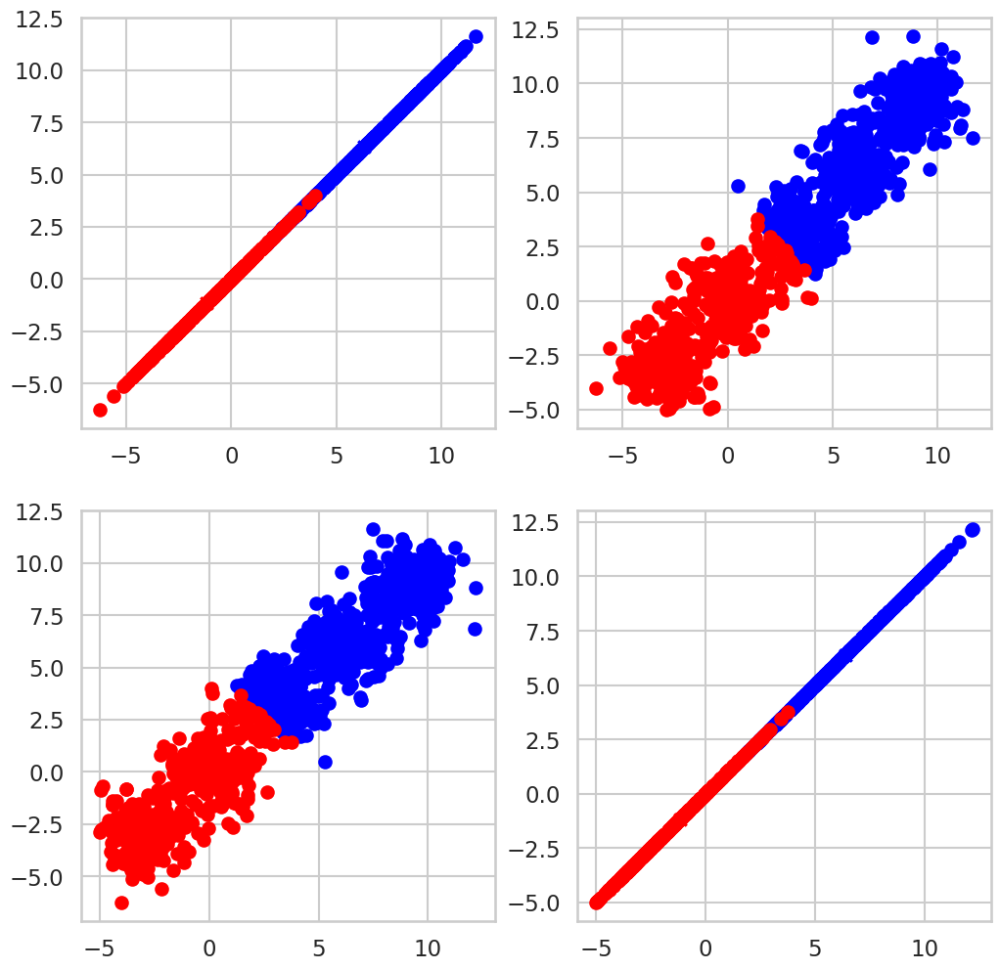

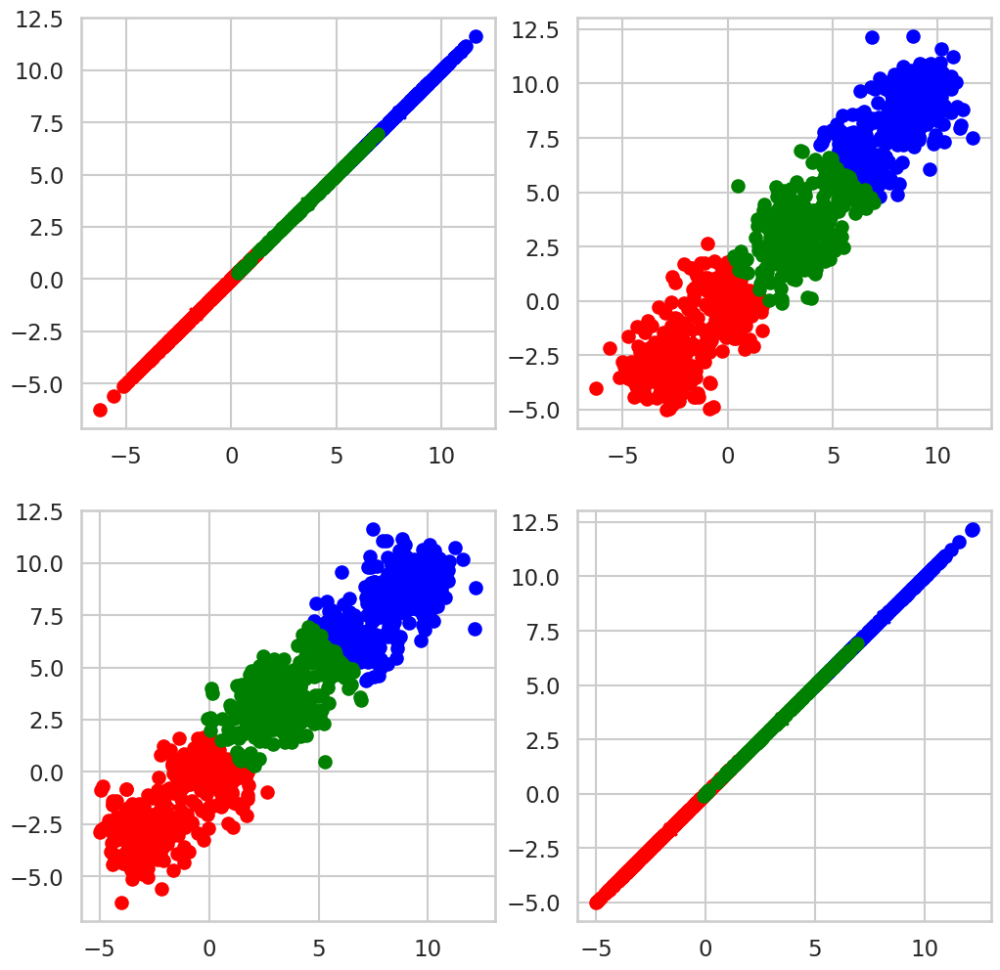

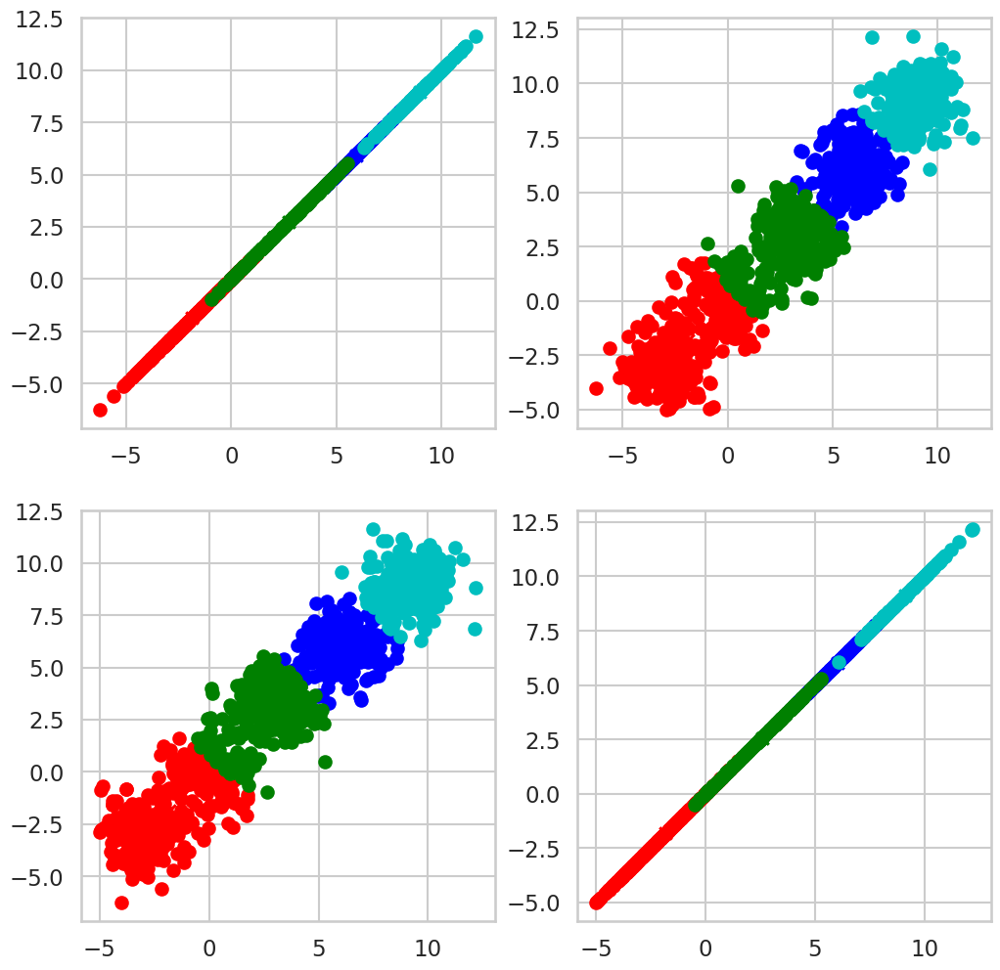

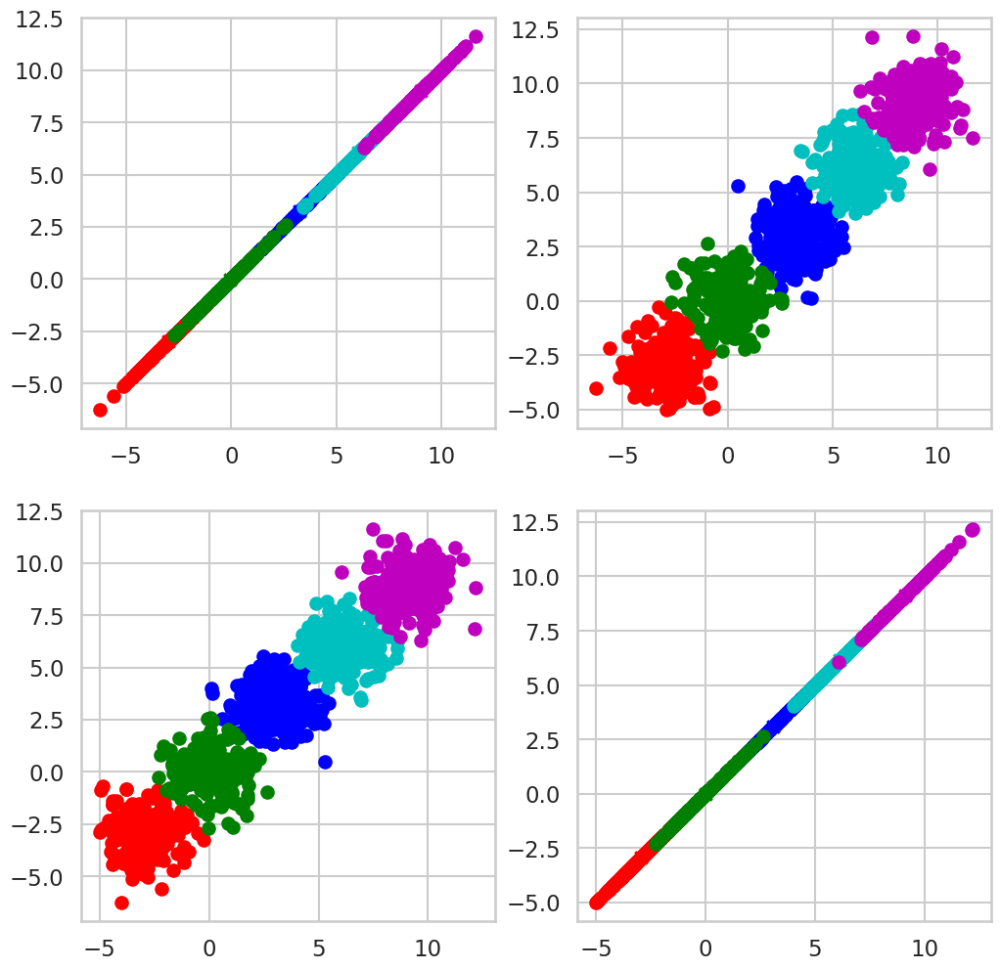

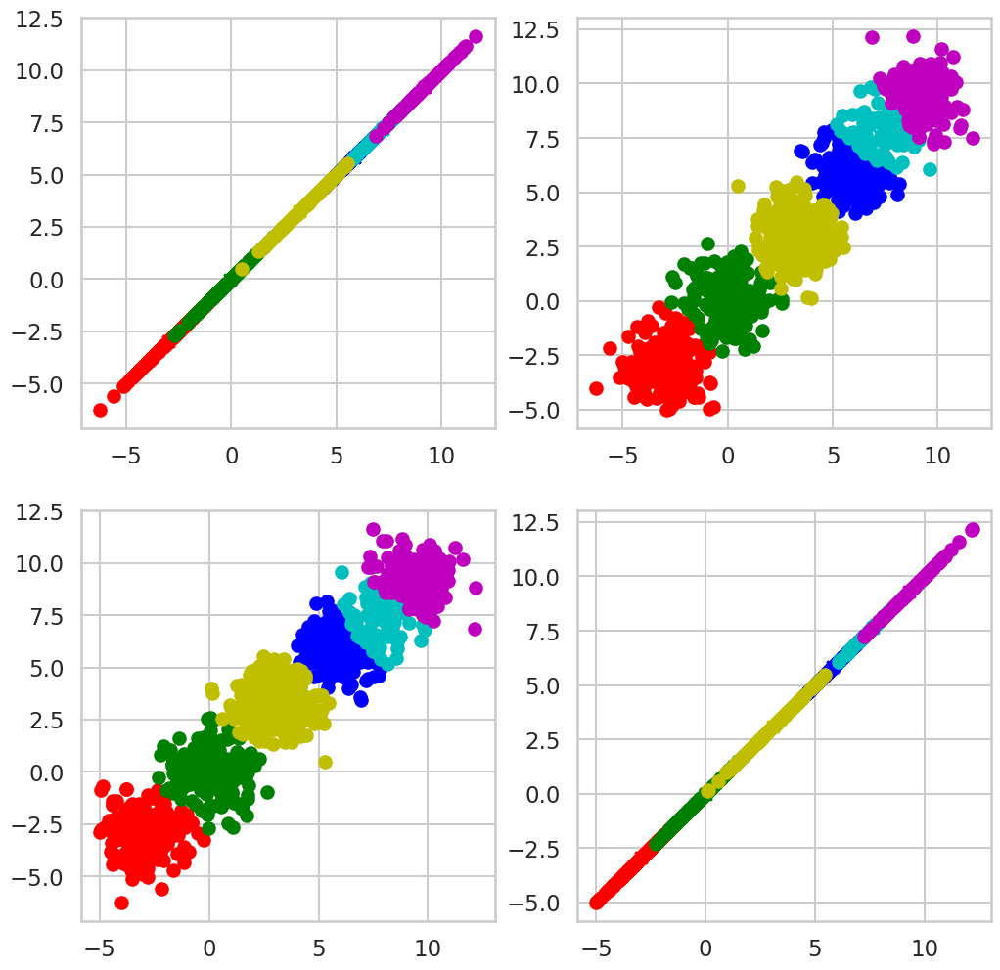

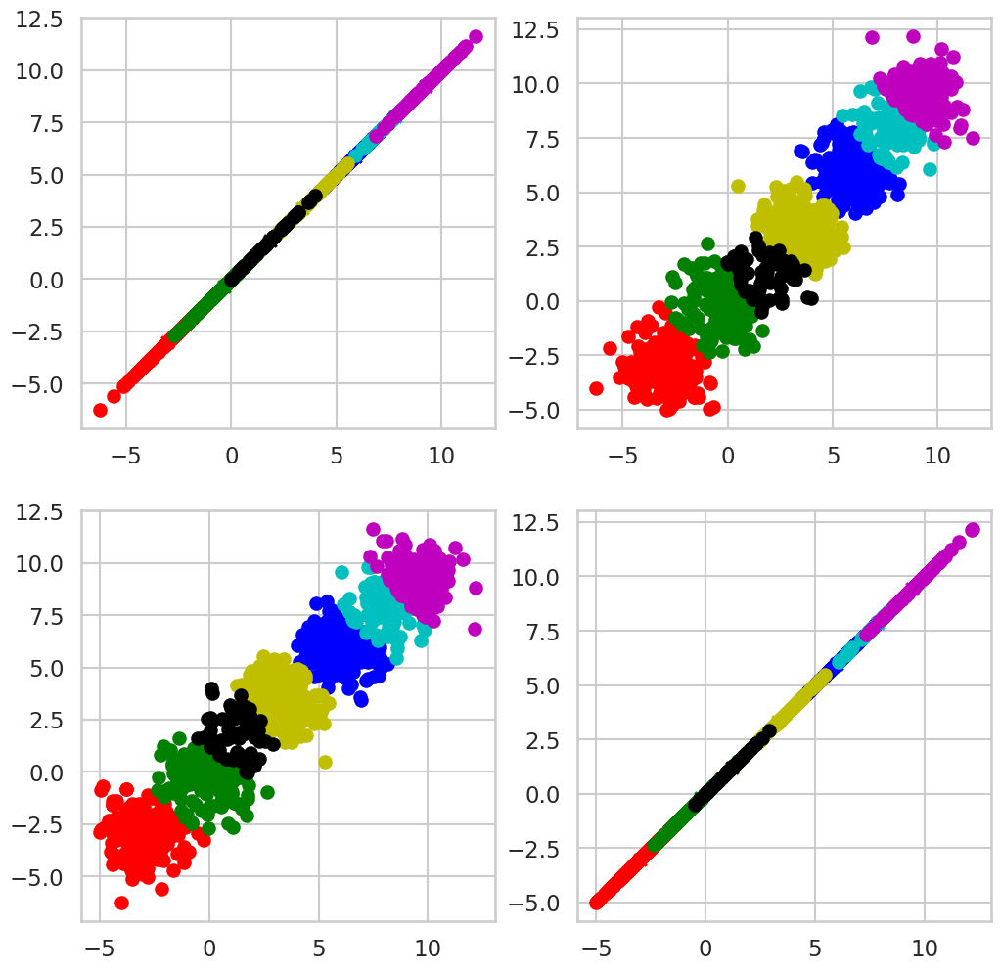

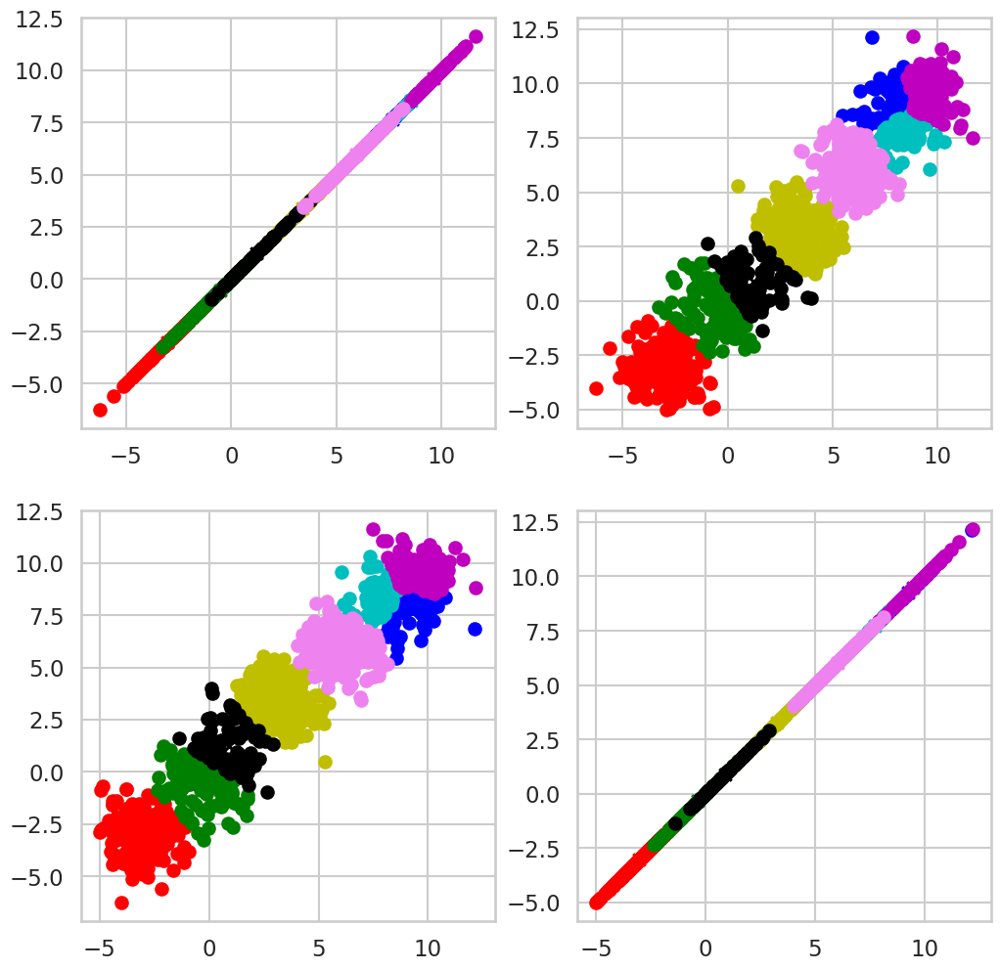

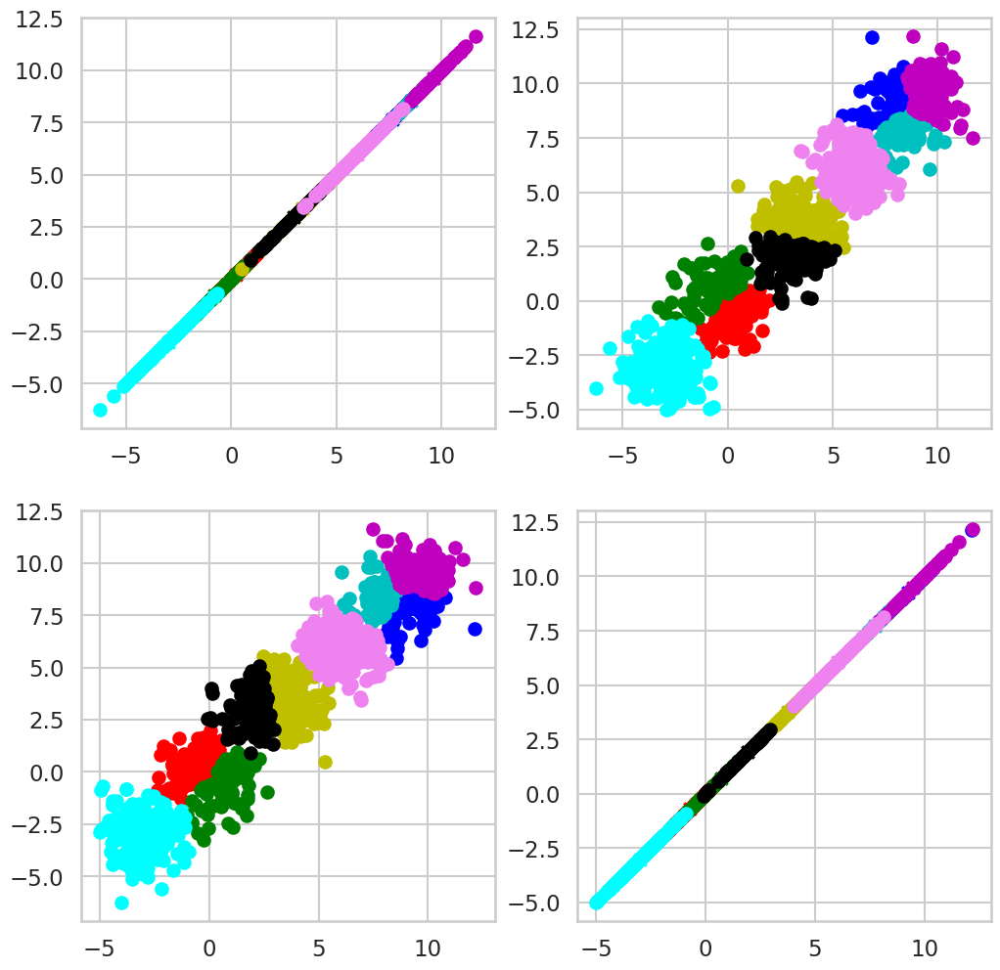

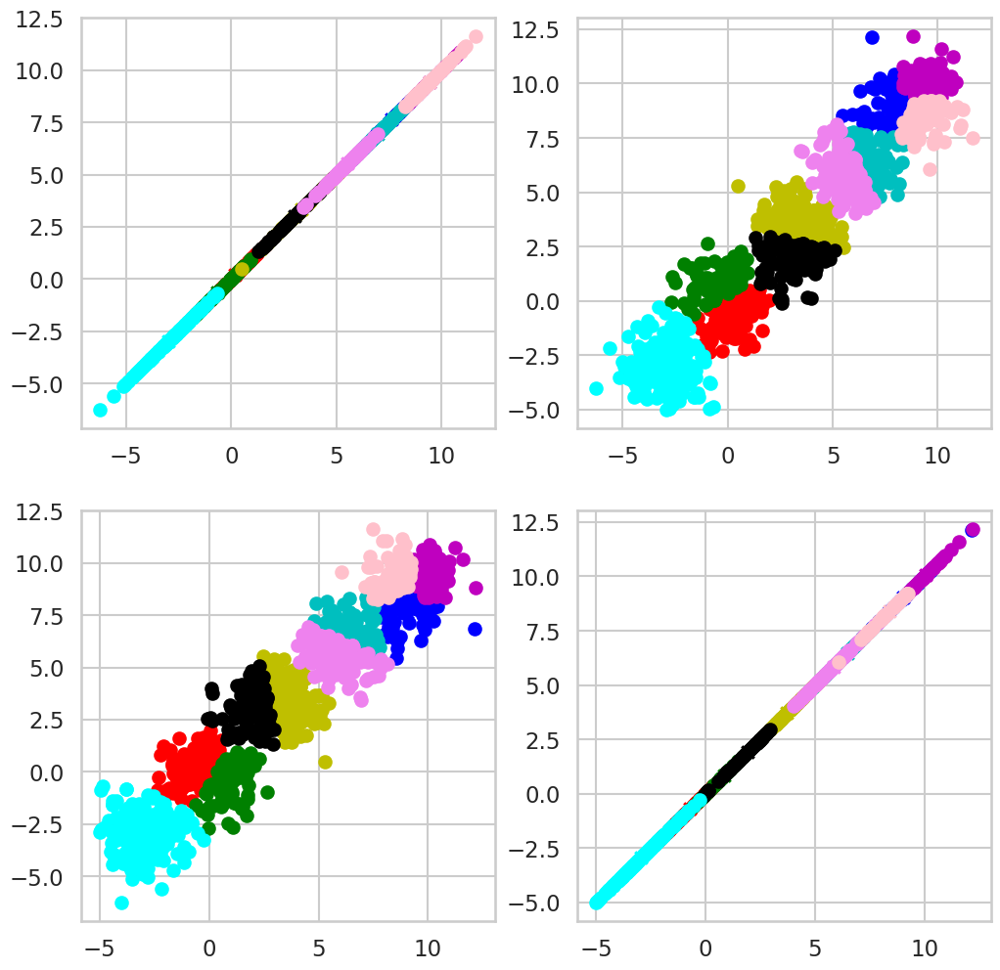

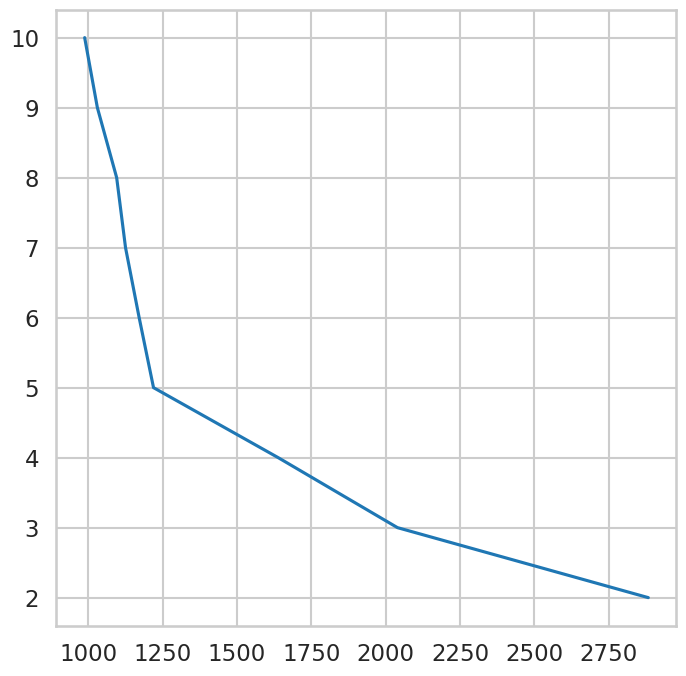

In [ ]:
n_samples = 1000
n_bins = 4
centers = [(-3, -3), (0, 0), (3, 3), (6, 6), (9,9)]
X, y = make_blobs(n_samples=n_samples, n_features=2, cluster_std=1.0,
                  centers=centers, shuffle=False, random_state=42)
distances=[]
a = [j for j in range (2,11)]
for i in range (2, 11):
  Number_of_Clusters = i
  Distance_Type = 'euclidean'
  Final_Cluster_Distance, Cluster_Metric = GUC_Kmean(X, Number_of_Clusters, Distance_Type)
  print("Final Cluster Distance:", Final_Cluster_Distance)
  print("Cluster Metric:", Cluster_Metric)
  distances.append(Final_Cluster_Distance)
  #display_cluster(X,Number_of_Clusters)
plt.figure()
plt.plot(distances,a)


2
mean of centroid :  0  is :  6.70413729457179
mean of centroid :  1  is :  -0.7633181095834125
2
mean of centroid :  0  is :  6.699027896989564
mean of centroid :  1  is :  -0.773249711300463
2
mean of centroid :  0  is :  6.70620176661751
mean of centroid :  1  is :  -0.7654668457942637
2
Final Cluster Distance: 973.035424590769
Cluster Metric: 973.035424590769
3
mean of centroid :  0  is :  6.75541769955556
mean of centroid :  1  is :  -0.08817363134779264
mean of centroid :  2  is :  -1.078778315837706
3
mean of centroid :  0  is :  6.770554380287645
mean of centroid :  1  is :  -0.10645758165967006
mean of centroid :  2  is :  -1.039286993533302
3
mean of centroid :  0  is :  6.770554380287645
mean of centroid :  1  is :  -0.1418312496784891
mean of centroid :  2  is :  -1.0242267908887235
3
mean of centroid :  0  is :  6.770554380287645
mean of centroid :  1  is :  -0.1418312496784891
mean of centroid :  2  is :  -1.0242267908887235
3
Final Cluster Distance: 972.9309975284899
Cl

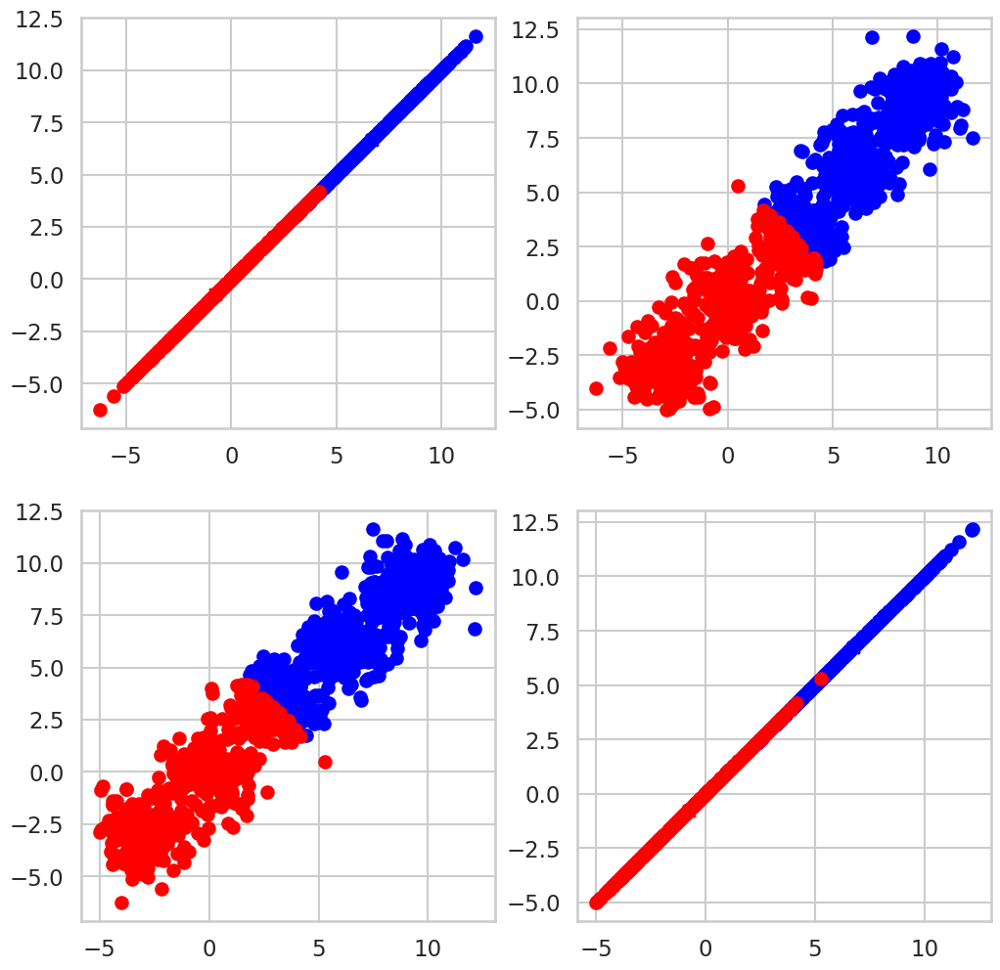

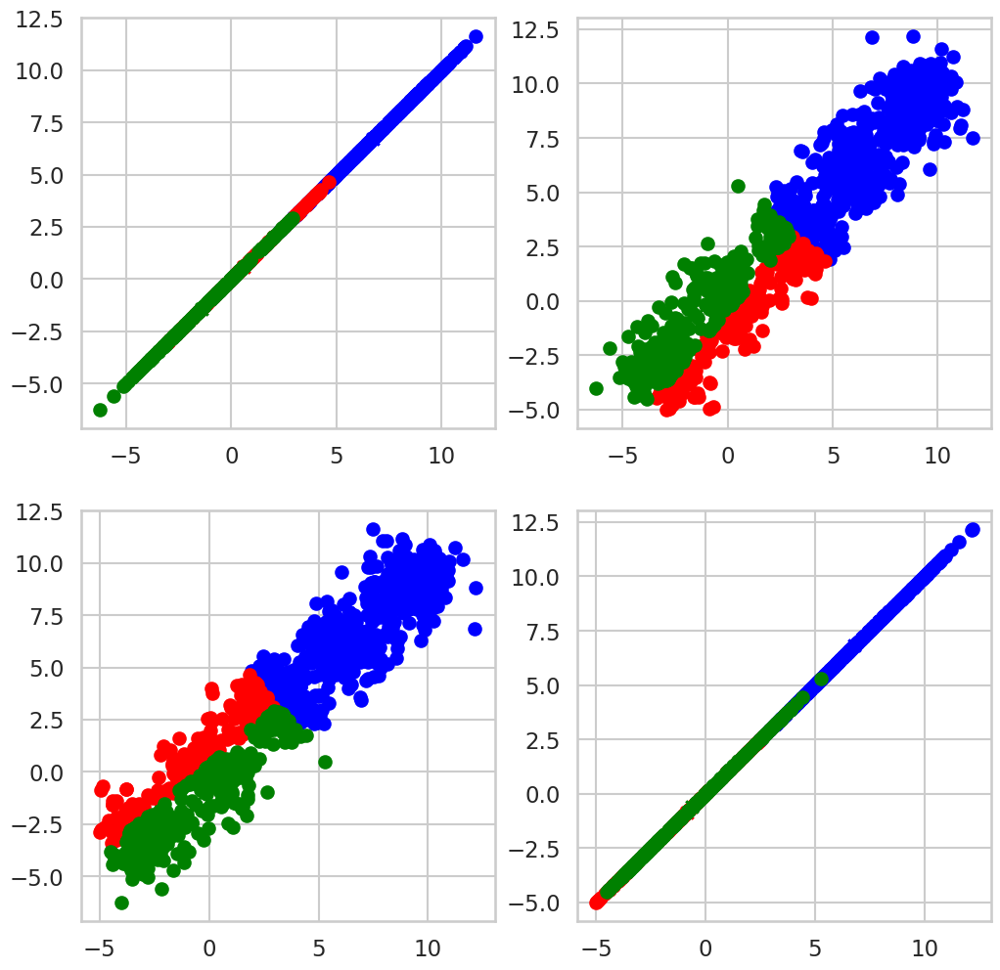

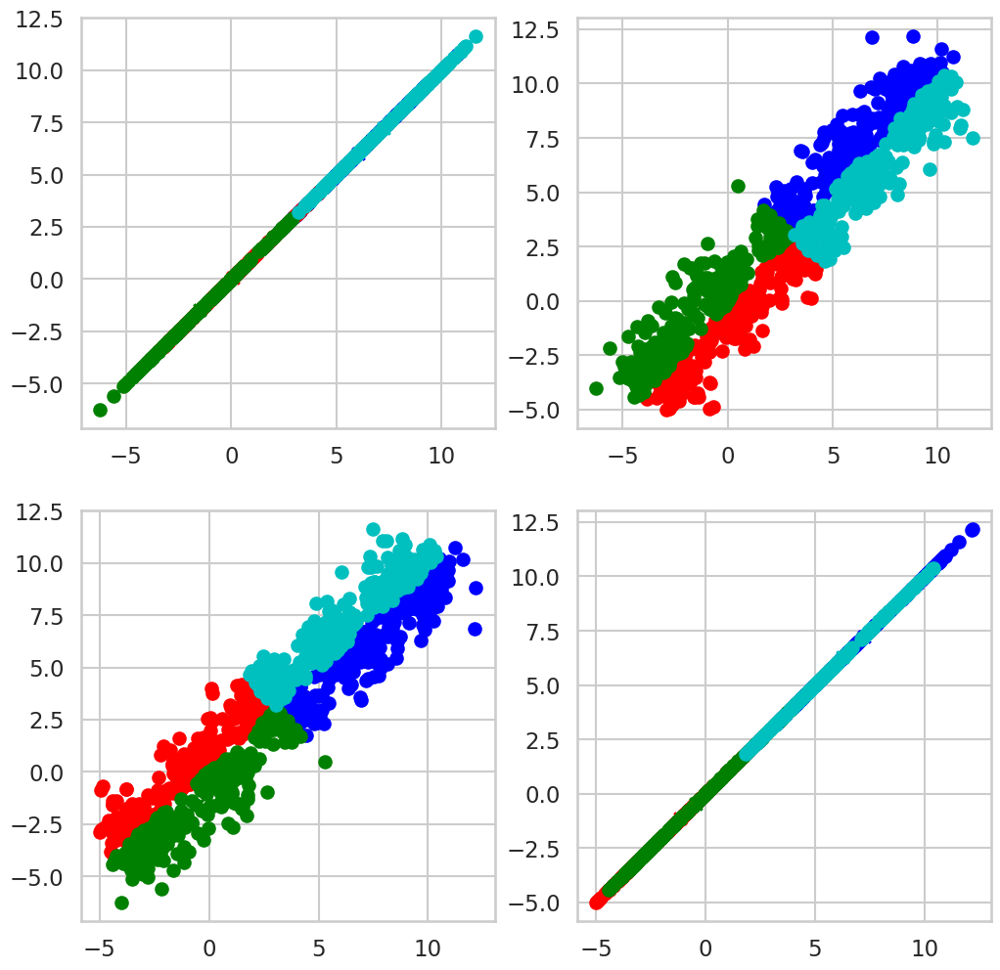

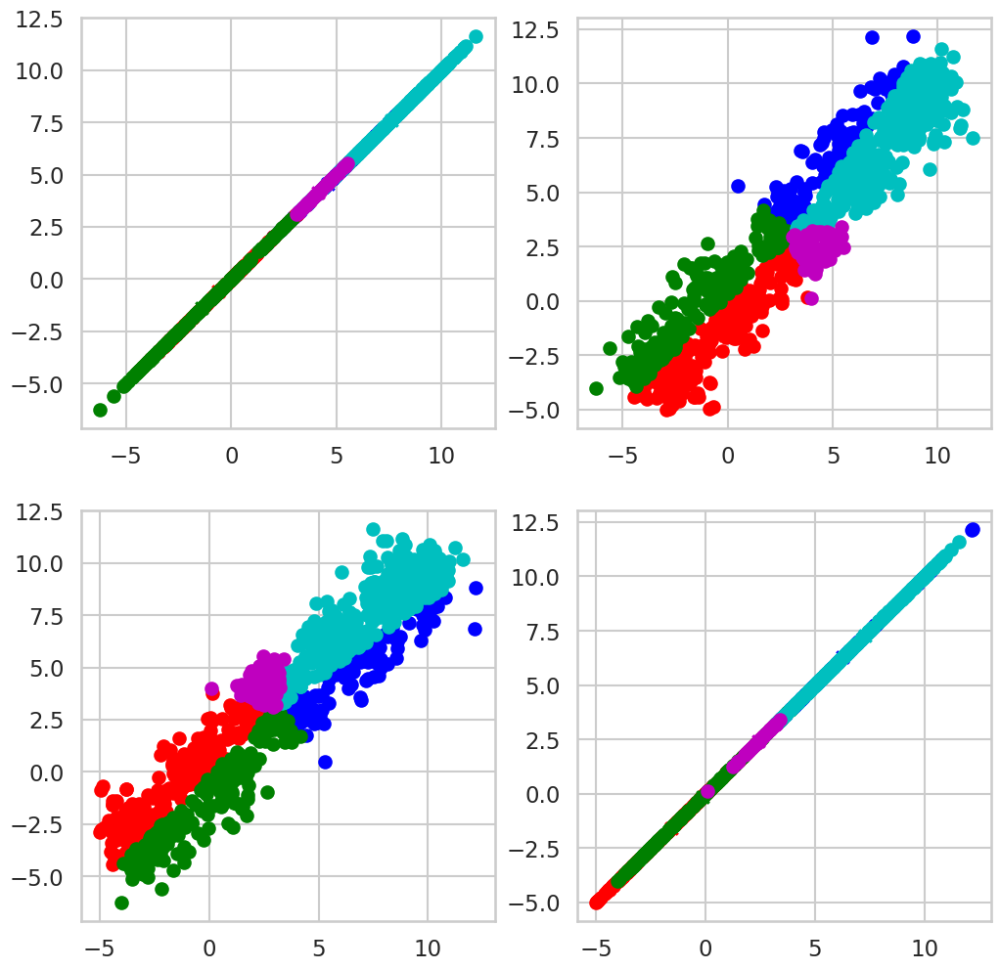

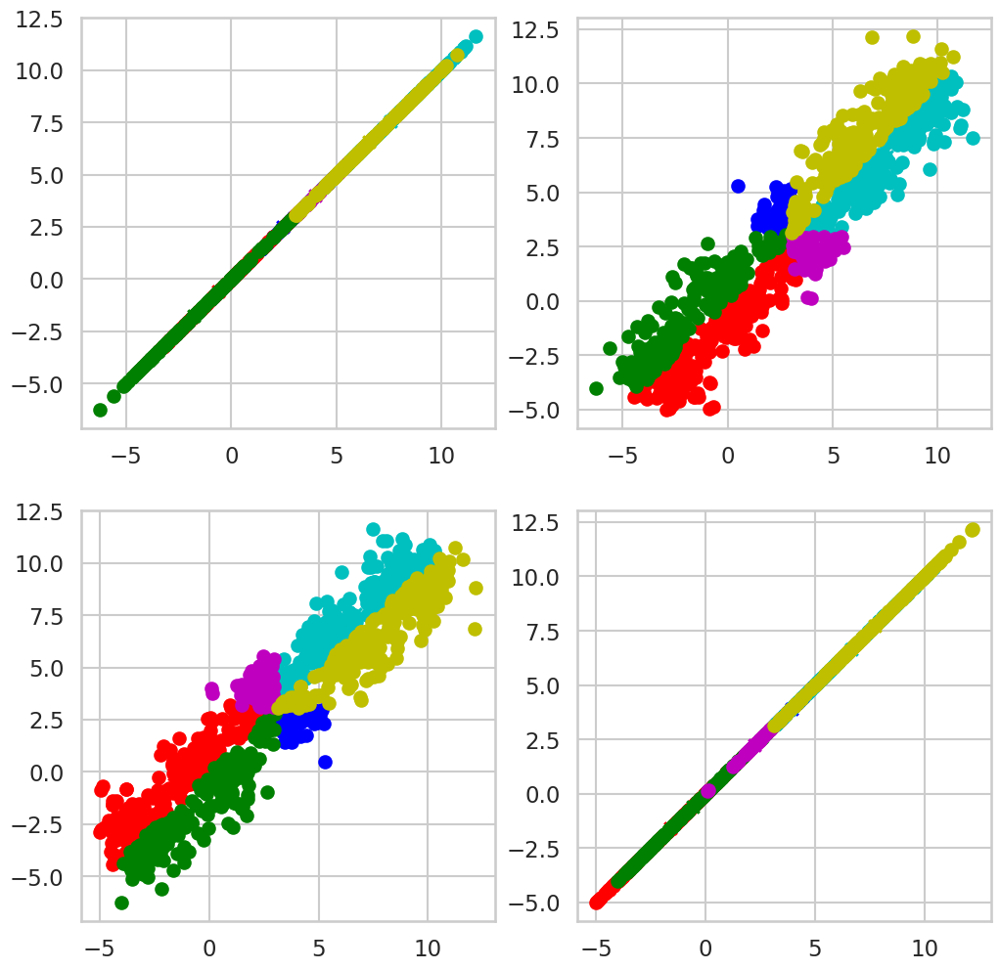

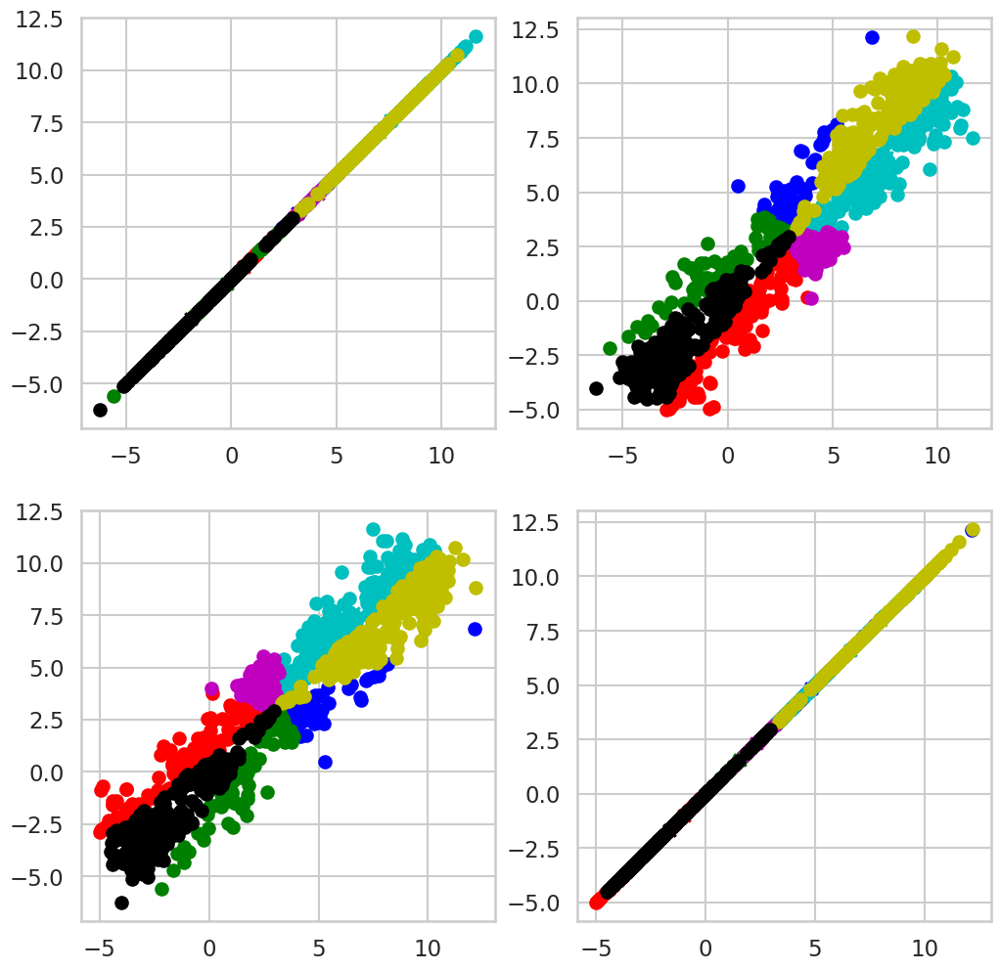

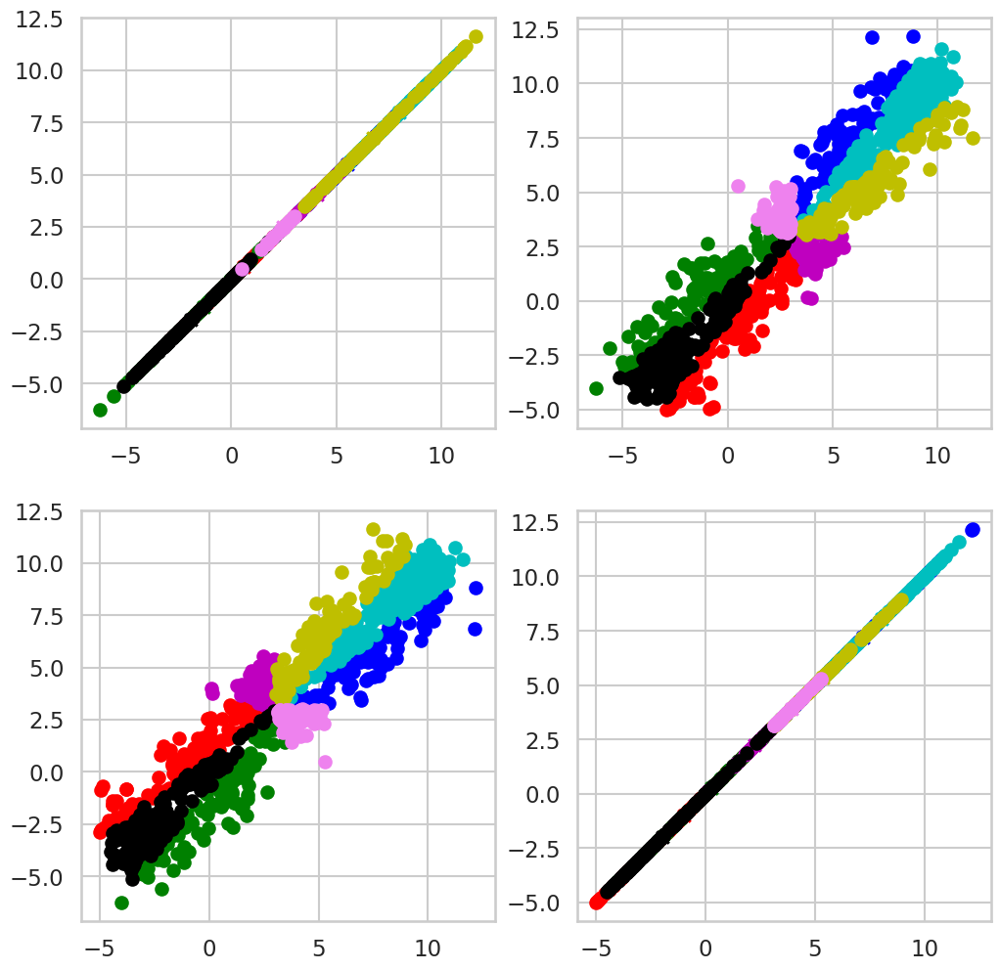

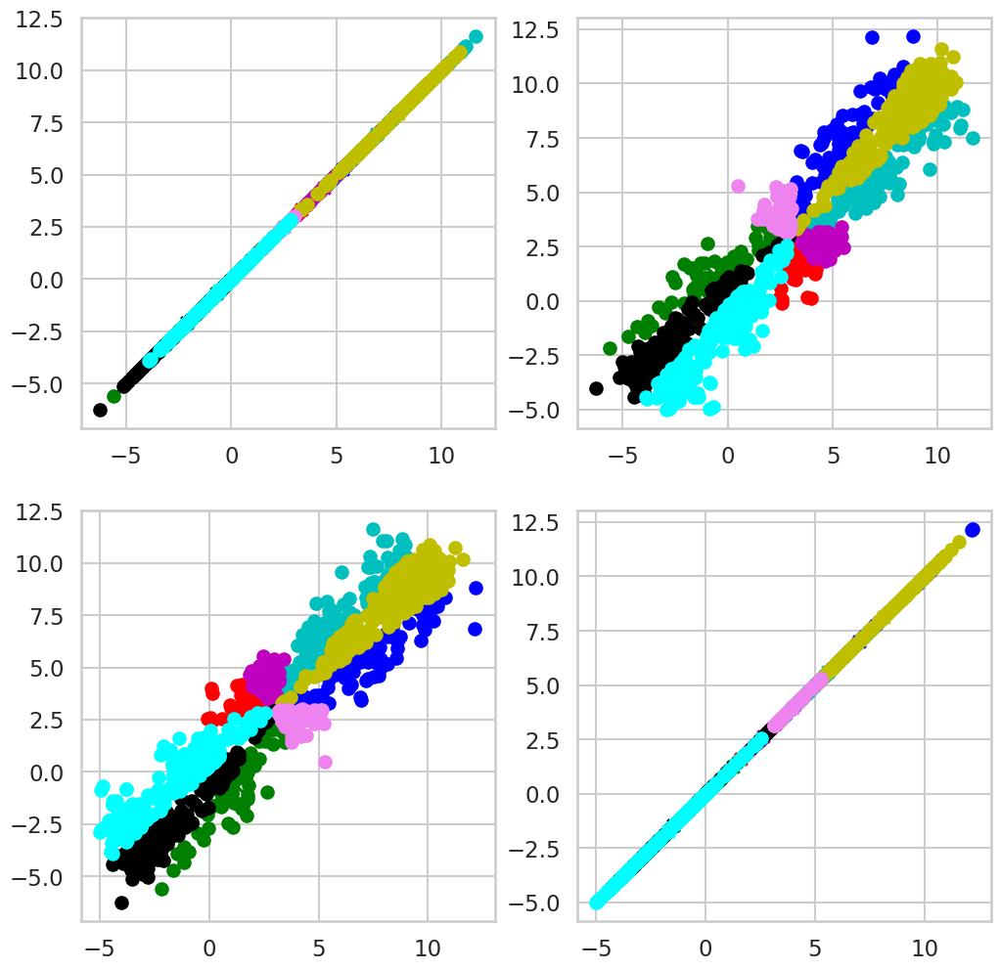

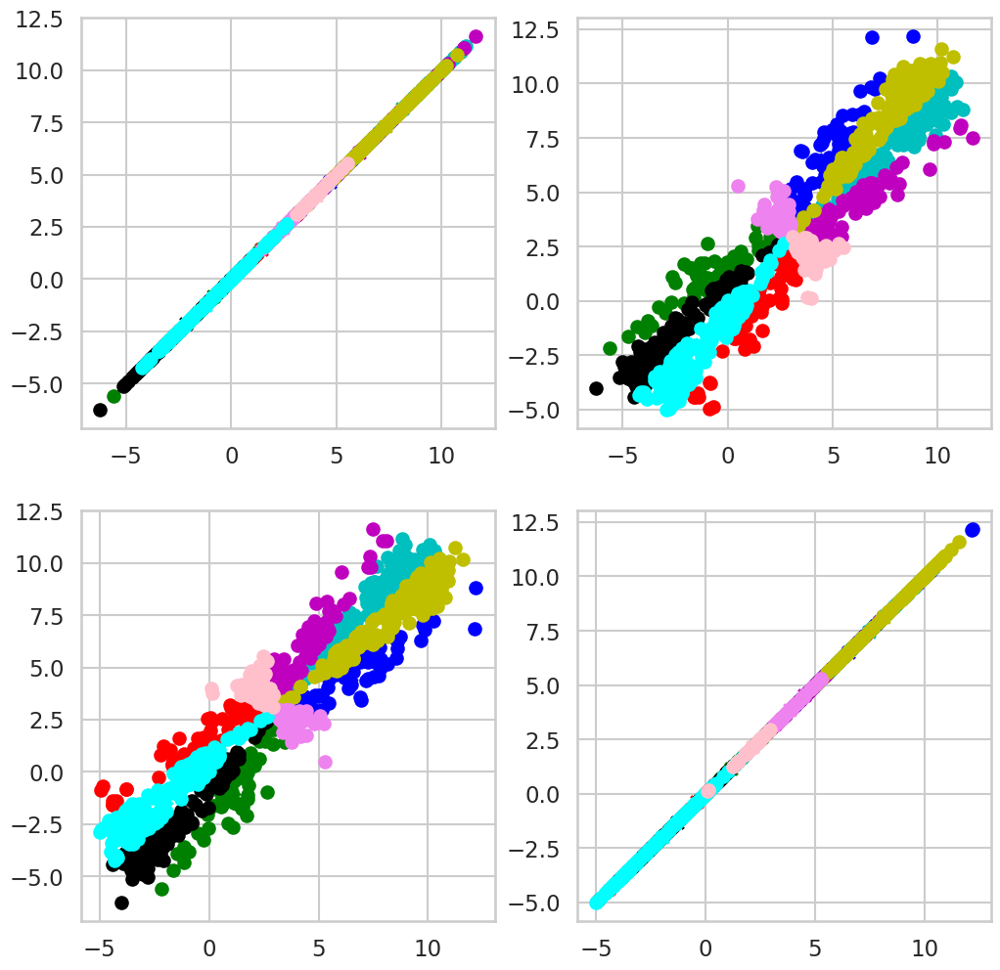

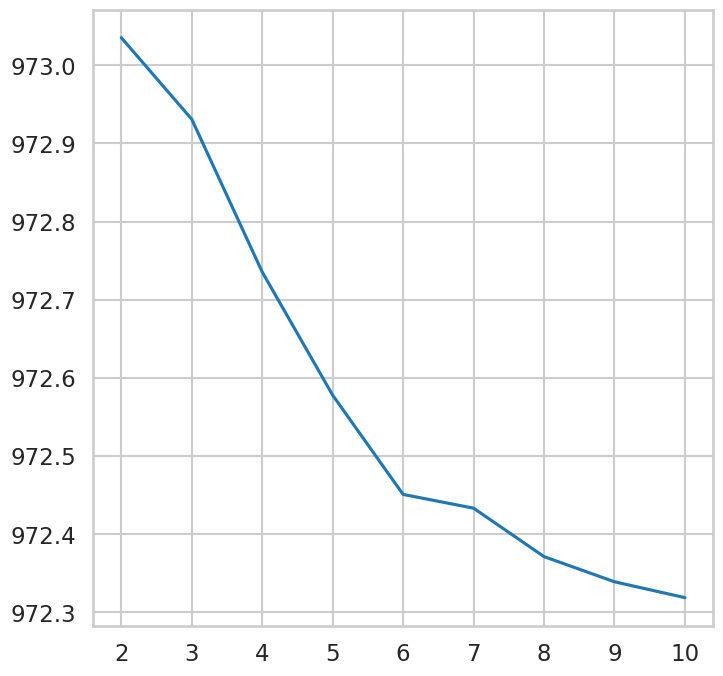

In [ ]:
n_samples = 1000
n_bins = 4
centers = [(-3, -3), (0, 0), (3, 3), (6, 6), (9,9)]
X, y = make_blobs(n_samples=n_samples, n_features=2, cluster_std=1.0,
                  centers=centers, shuffle=False, random_state=42)
distances=[]
a = [j for j in range (2,11)]
for i in range (2, 11):
  Number_of_Clusters = i
  Distance_Type = 'pearson'
  Final_Cluster_Distance, Cluster_Metric = GUC_Kmean(X, Number_of_Clusters, Distance_Type)
  print("Final Cluster Distance:", Final_Cluster_Distance)
  print("Cluster Metric:", Cluster_Metric)
  distances.append(Final_Cluster_Distance)
  #display_cluster(X,Number_of_Clusters)
plt.figure()
plt.plot(a,distances)


2
mean of centroid :  0  is :  0.25011911831928085
mean of centroid :  1  is :  0.6699749474565673
2
mean of centroid :  0  is :  0.22522270808560363
mean of centroid :  1  is :  0.616680286583437
2
mean of centroid :  0  is :  0.2089261450953879
mean of centroid :  1  is :  0.5892267045870755
2
mean of centroid :  0  is :  0.19700520983023023
mean of centroid :  1  is :  0.5711518865417526
2
mean of centroid :  0  is :  0.1903189609105356
mean of centroid :  1  is :  0.5643670810821135
2
mean of centroid :  0  is :  0.18578676274222528
mean of centroid :  1  is :  0.5629206809236983
2
mean of centroid :  0  is :  0.18262074974336592
mean of centroid :  1  is :  0.5638076783716816
2
mean of centroid :  0  is :  0.1817600880513471
mean of centroid :  1  is :  0.5631420322248257
2
mean of centroid :  0  is :  0.1817600880513471
mean of centroid :  1  is :  0.5631420322248257
2
Final Cluster Distance: 612.1857397044338
Cluster Metric: 612.1857397044338
3
mean of centroid :  0  is :  0.242

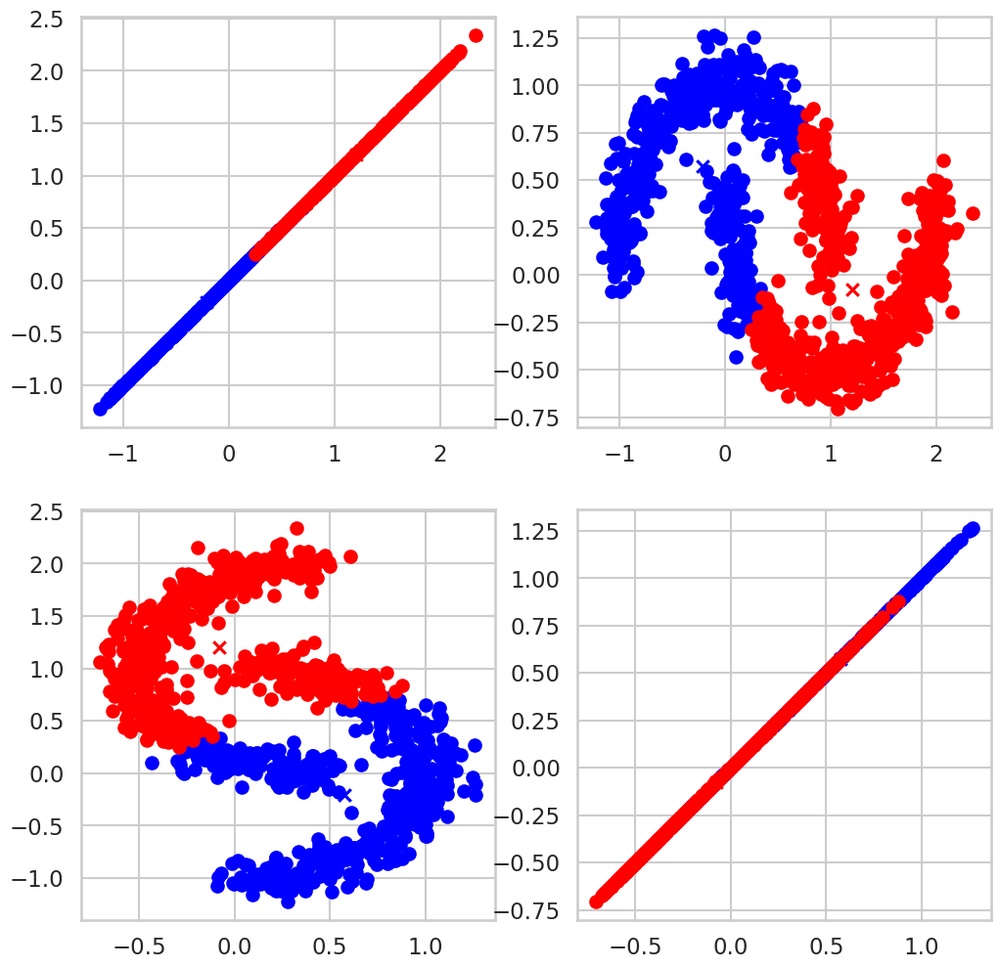

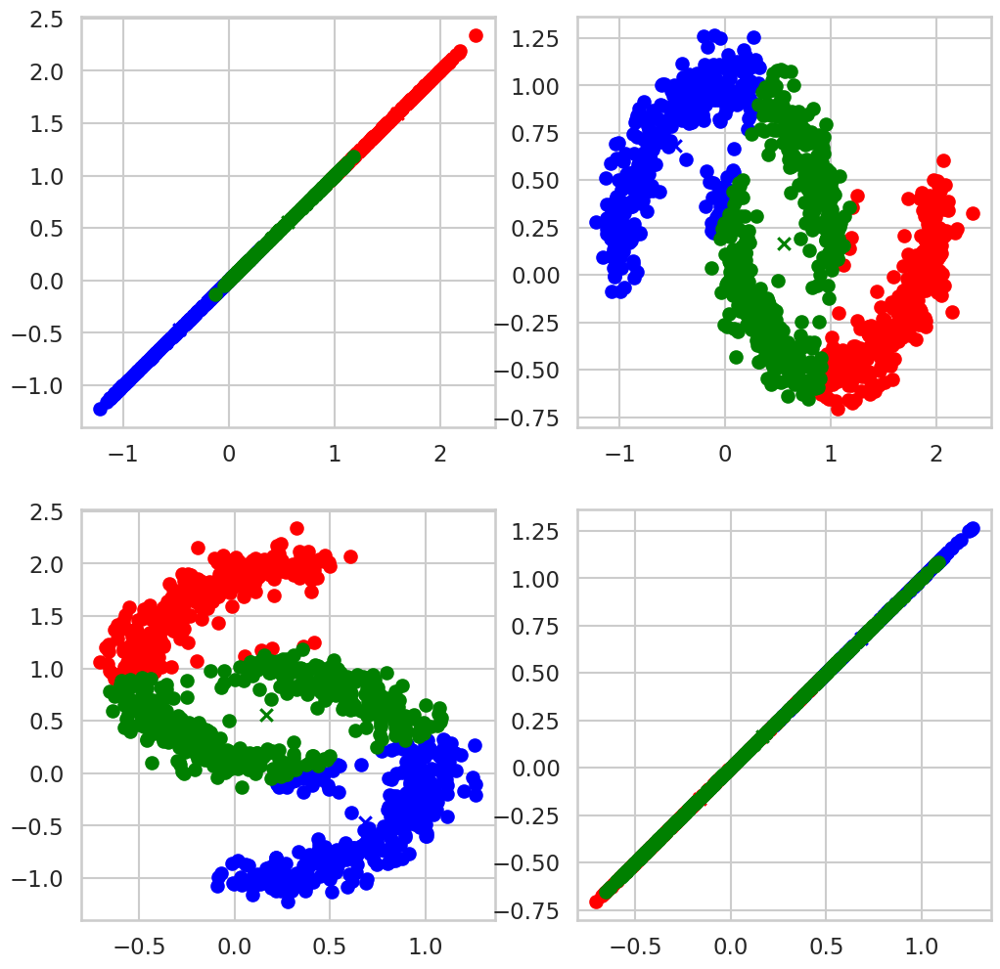

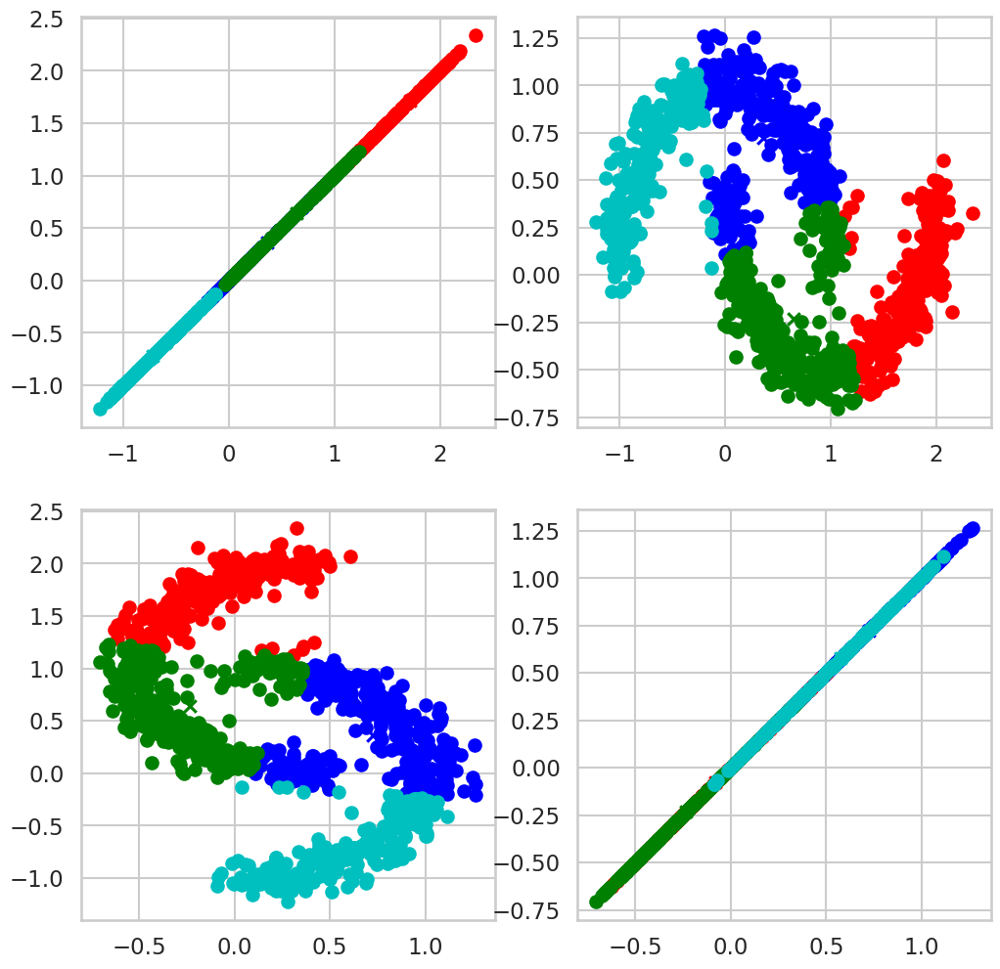

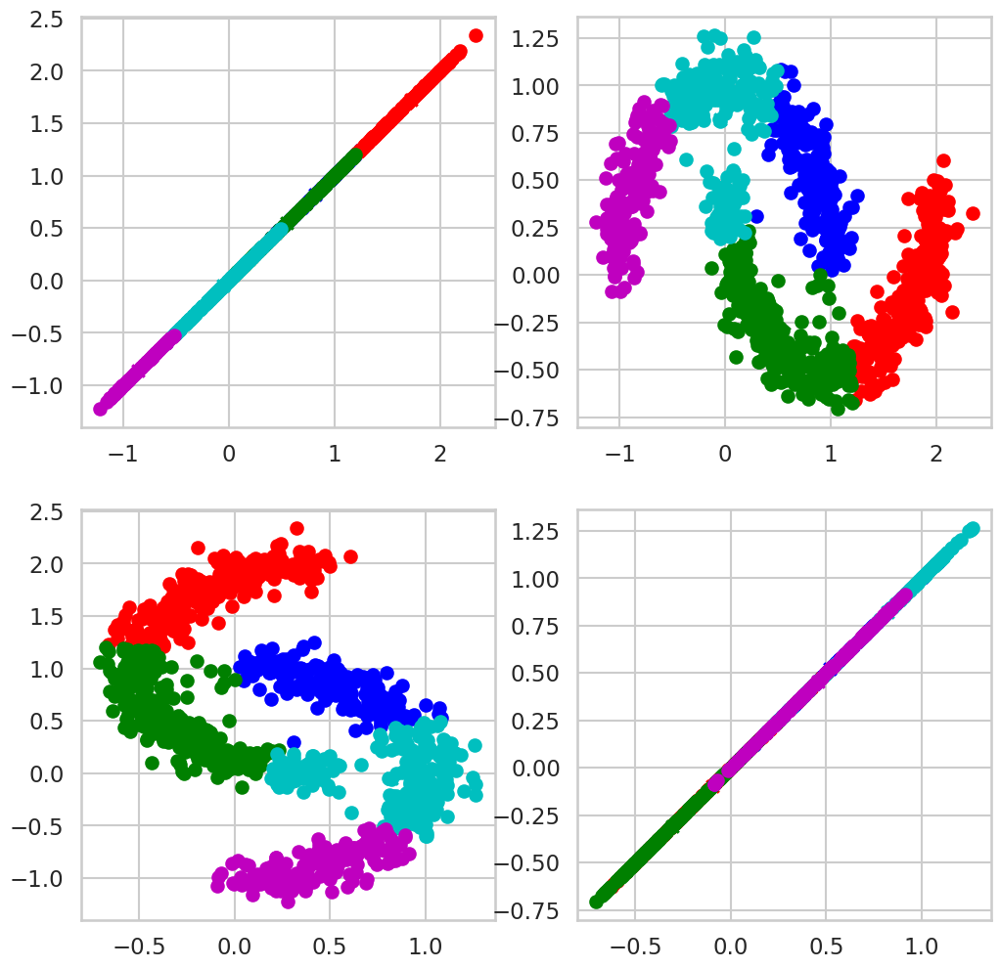

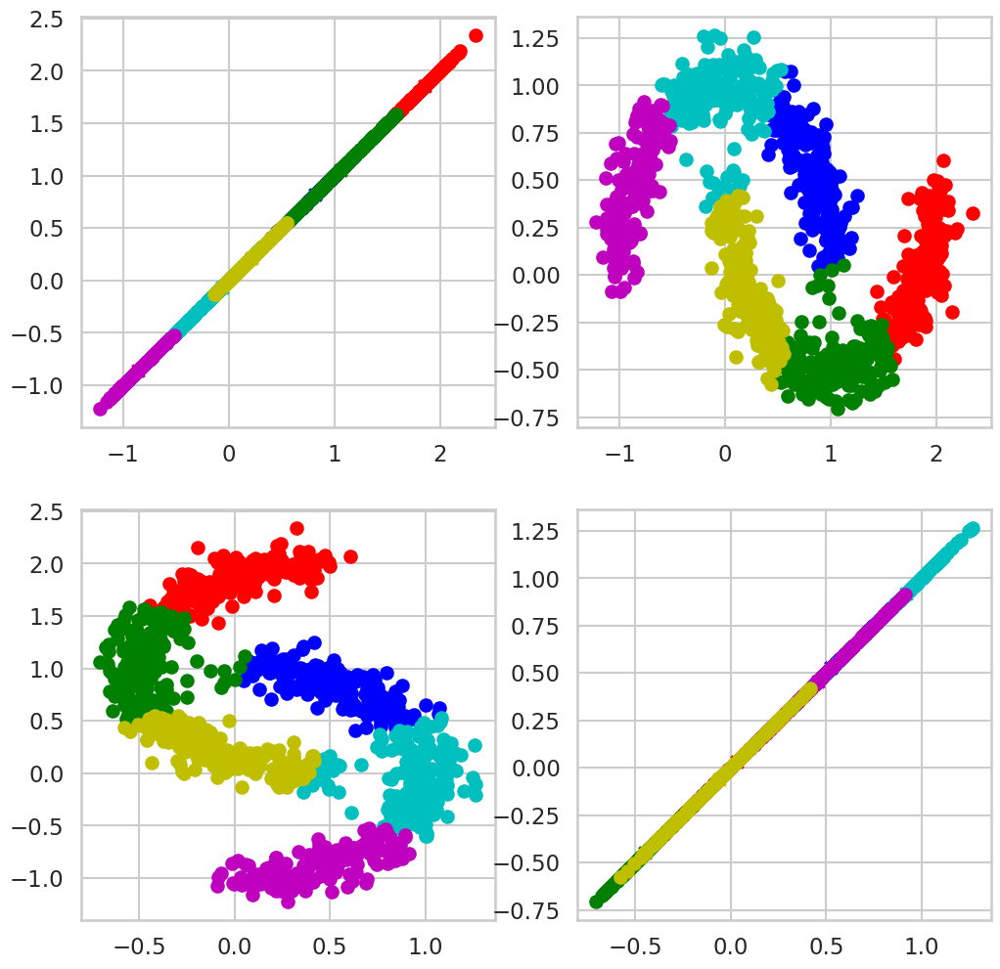

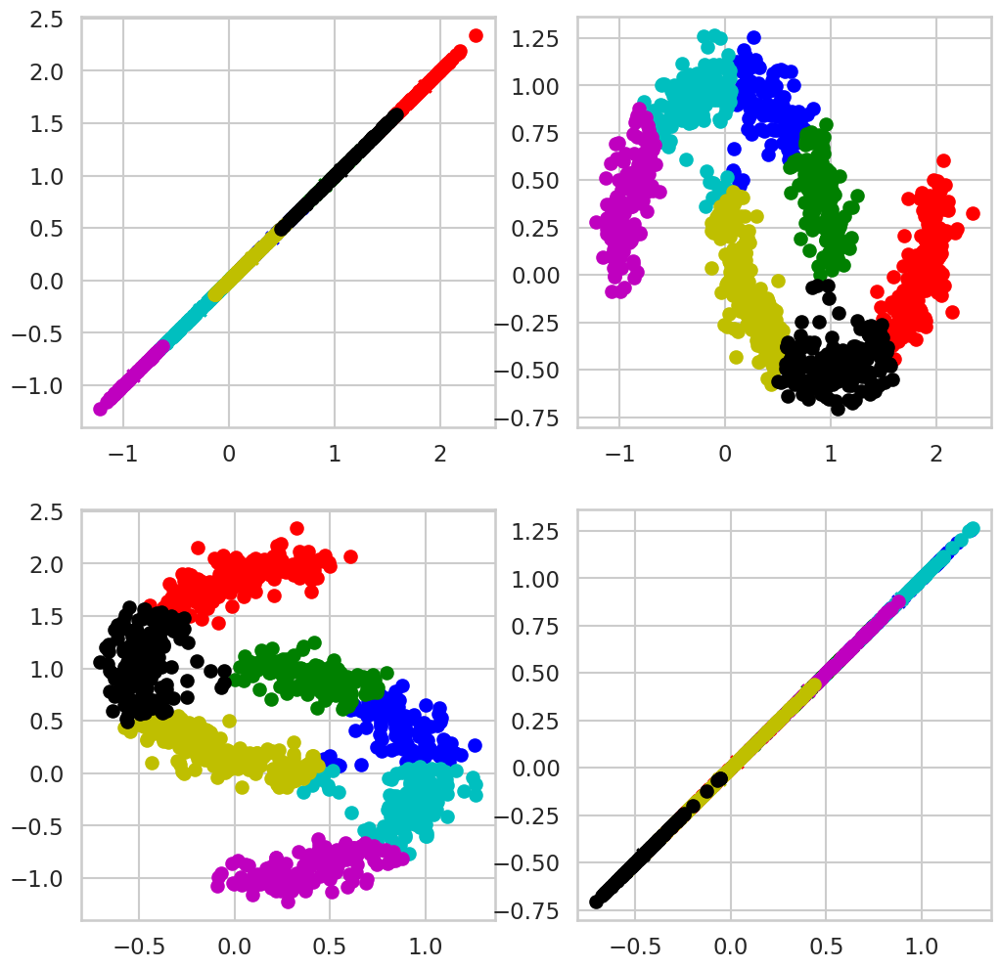

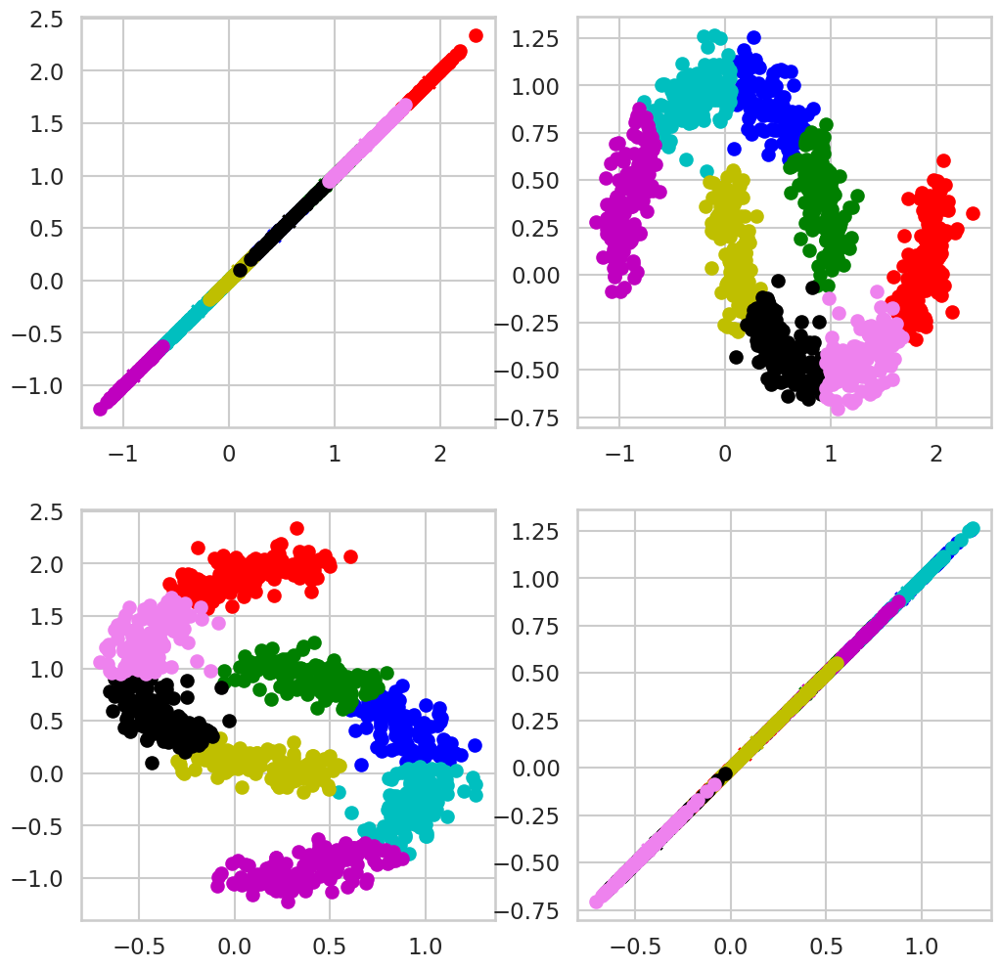

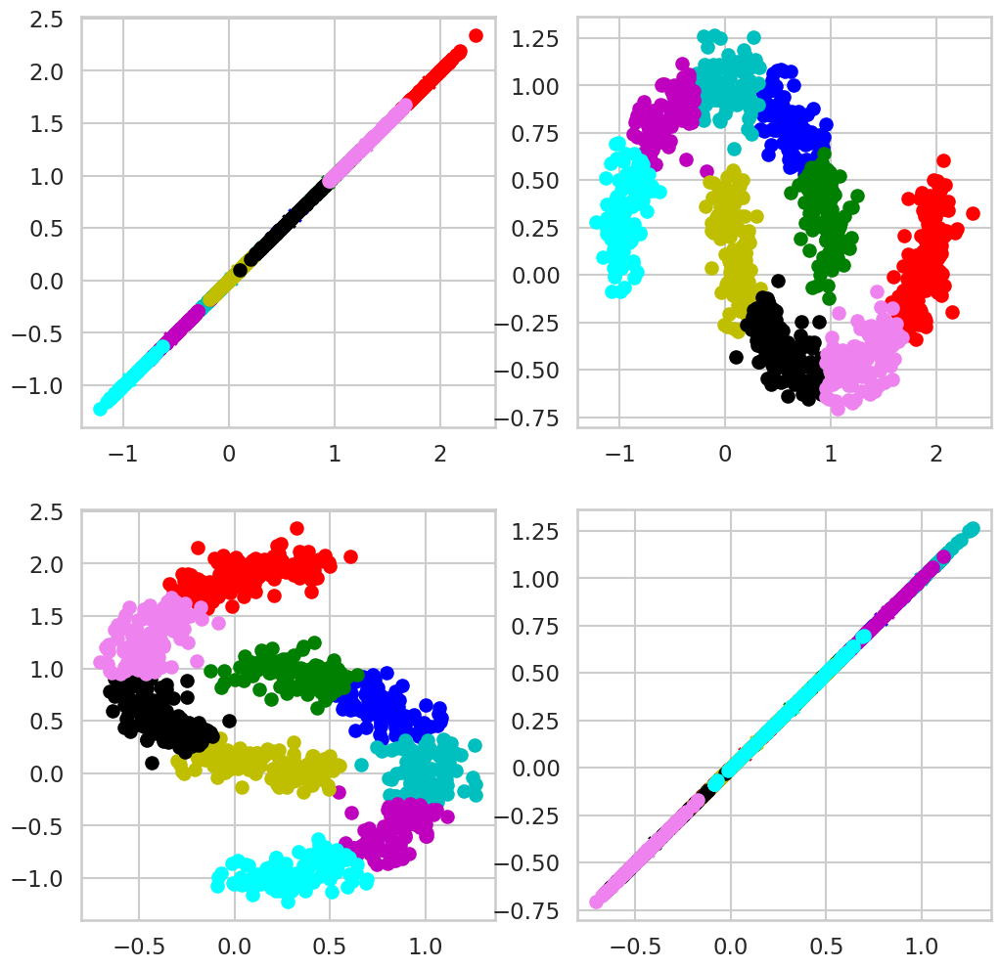

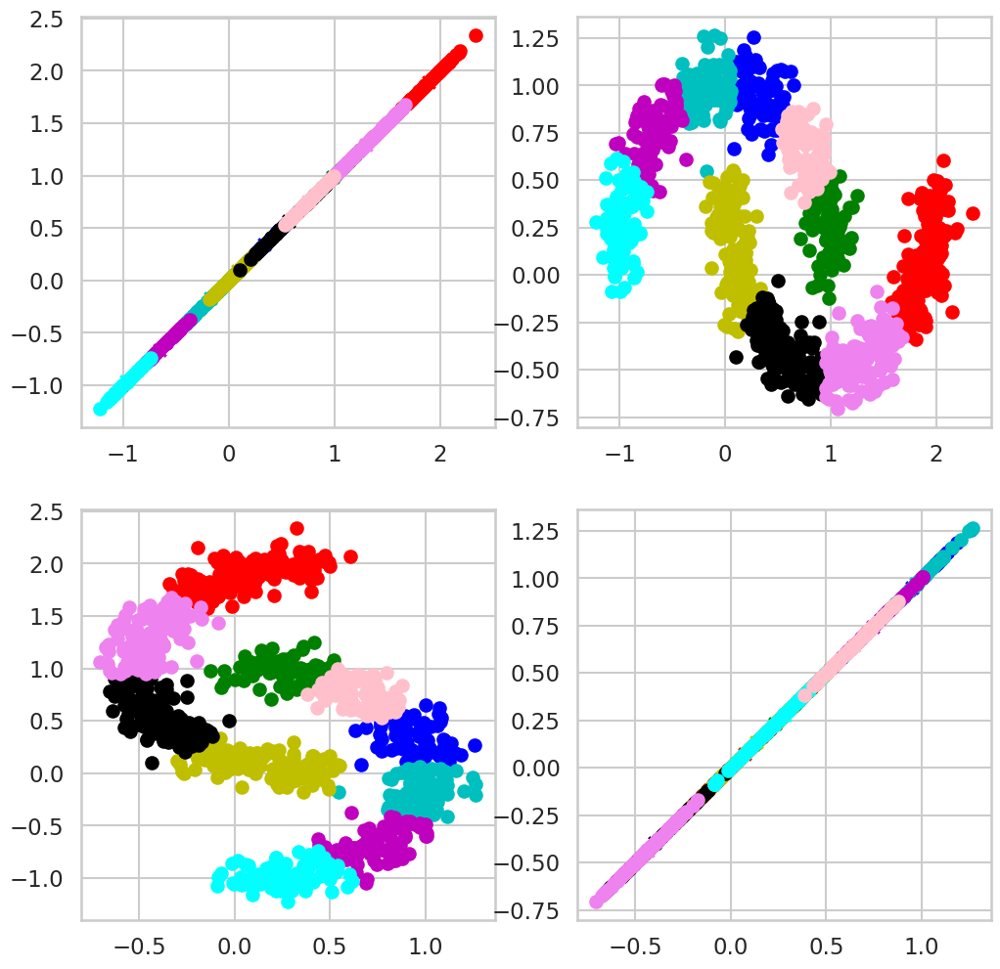

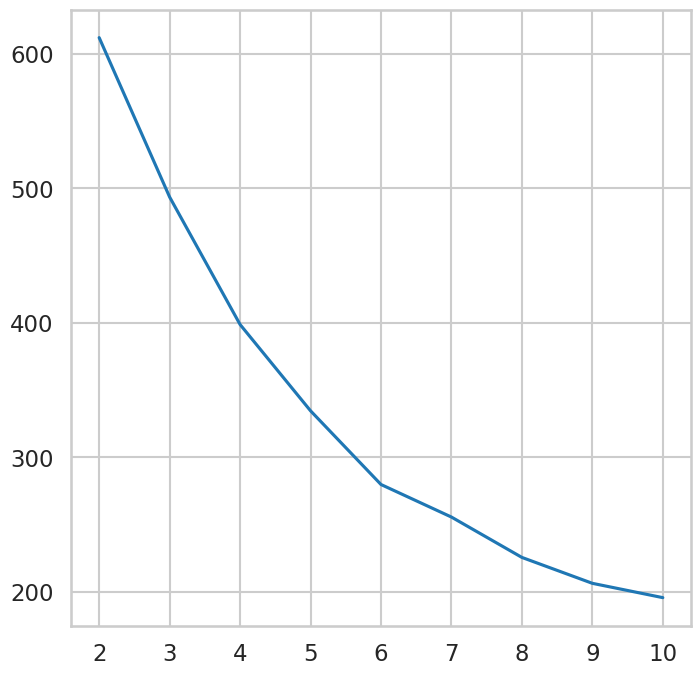

In [ ]:
n_samples = 1000
X, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)
distances=[]
a = [j for j in range (2,11)]
for i in range (2, 11):
  Number_of_Clusters = i
  Distance_Type = 'euclidean'
  Final_Cluster_Distance, Cluster_Metric = GUC_Kmean(X, Number_of_Clusters, Distance_Type)
  print("Final Cluster Distance:", Final_Cluster_Distance)
  print("Cluster Metric:", Cluster_Metric)
  distances.append(Final_Cluster_Distance)
  #display_cluster(X,Number_of_Clusters)
plt.figure()
plt.plot(a,distances)

2
mean of centroid :  0  is :  0.19012179865709747
mean of centroid :  1  is :  0.554913047184246
2
mean of centroid :  0  is :  0.18417941879314742
mean of centroid :  1  is :  0.5622614289956035
2
mean of centroid :  0  is :  0.18302635500890646
mean of centroid :  1  is :  0.5626490844440434
2
Final Cluster Distance: 975.6626473621878
Cluster Metric: 975.6626473621878
3
mean of centroid :  0  is :  0.3916507496176417
mean of centroid :  1  is :  0.5958144469786498
mean of centroid :  2  is :  -0.09831411318152047
3
mean of centroid :  0  is :  0.43989959911155213
mean of centroid :  1  is :  0.606376755800392
mean of centroid :  2  is :  -0.08653781391953852
3
mean of centroid :  0  is :  0.466378207071812
mean of centroid :  1  is :  0.59759477340312
mean of centroid :  2  is :  -0.08252449904304131
3
mean of centroid :  0  is :  0.5035828348103749
mean of centroid :  1  is :  0.588816517086227
mean of centroid :  2  is :  -0.07016797172506599
3
mean of centroid :  0  is :  0.53113

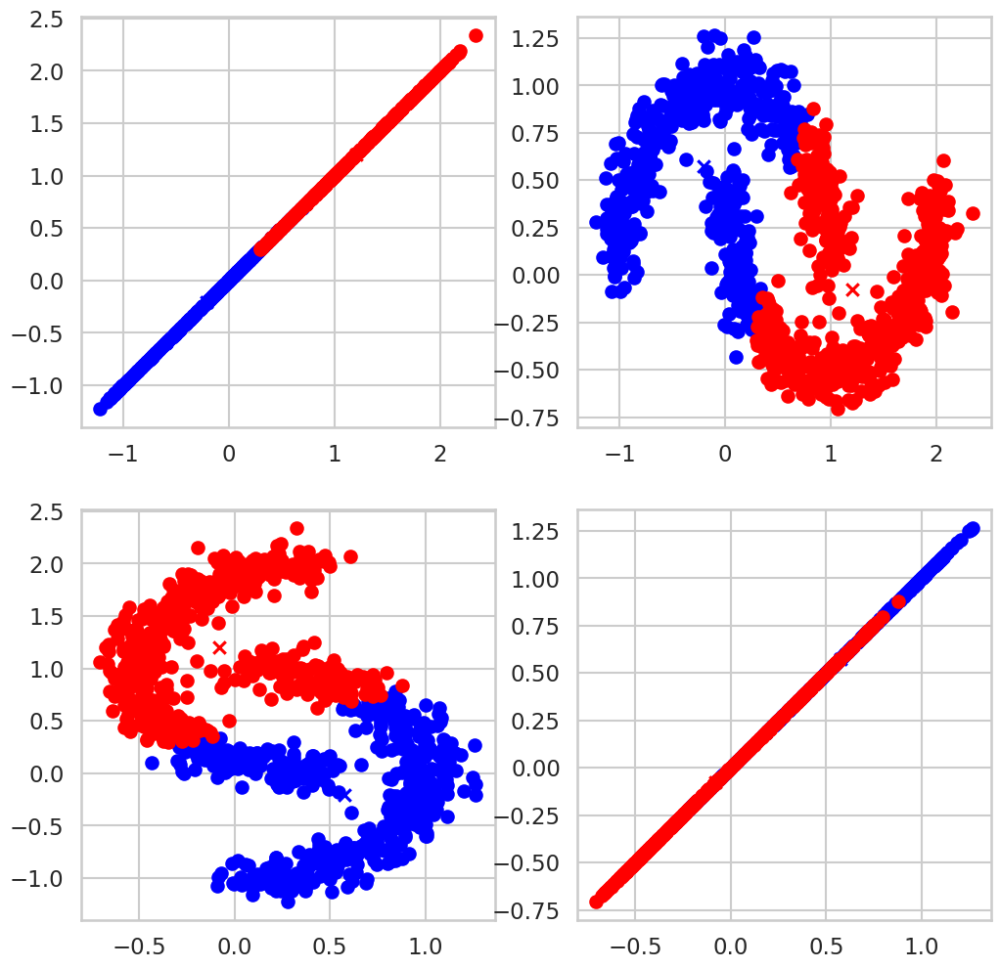

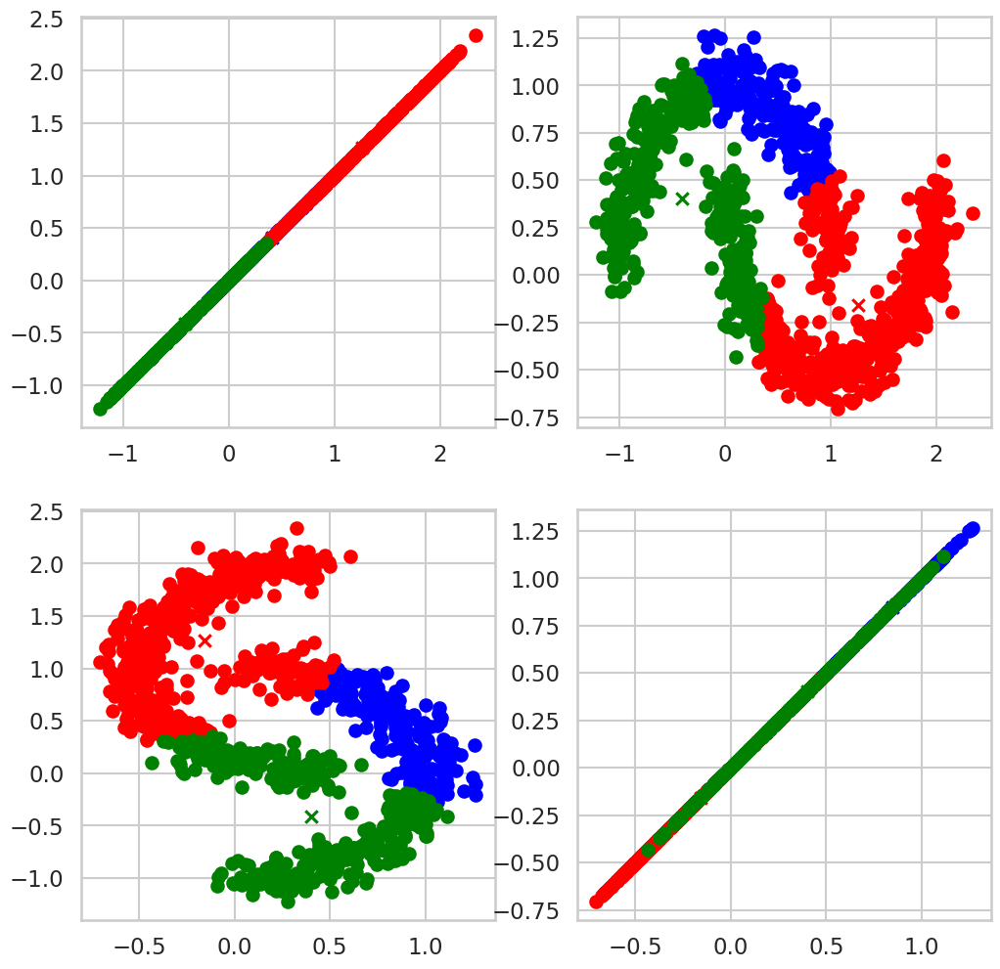

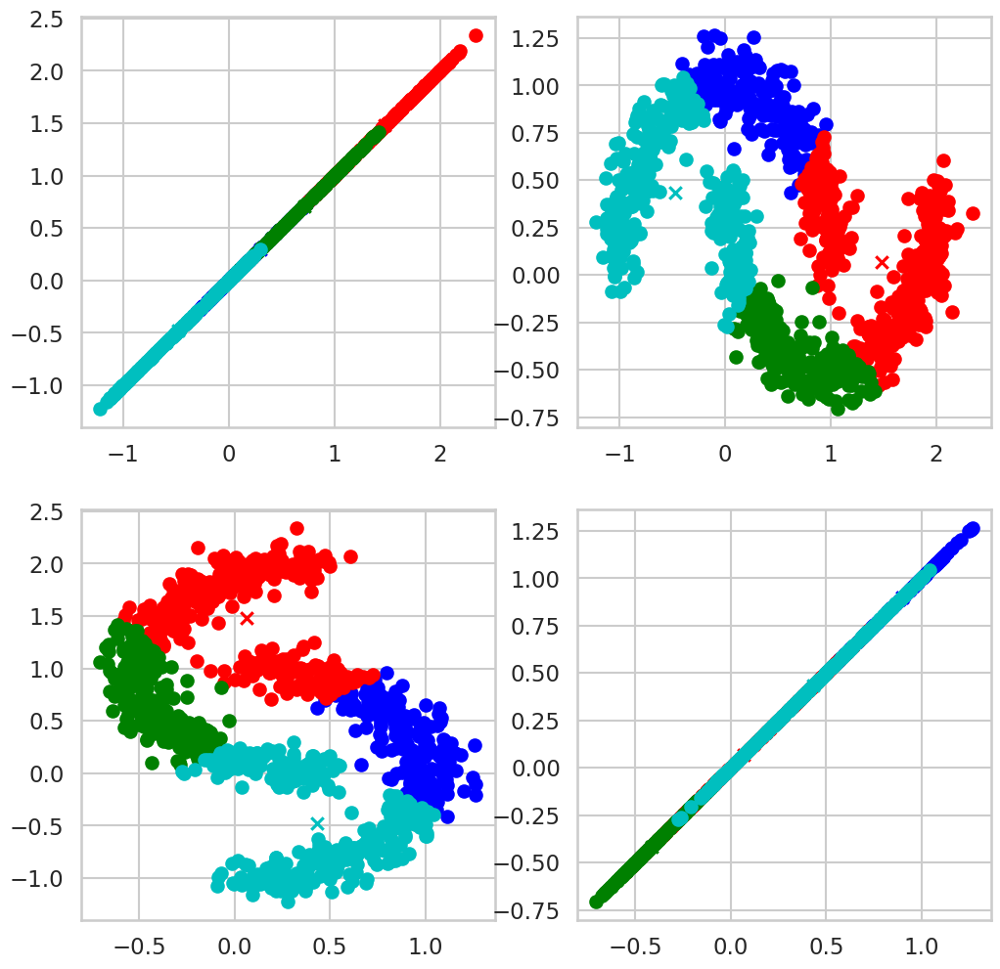

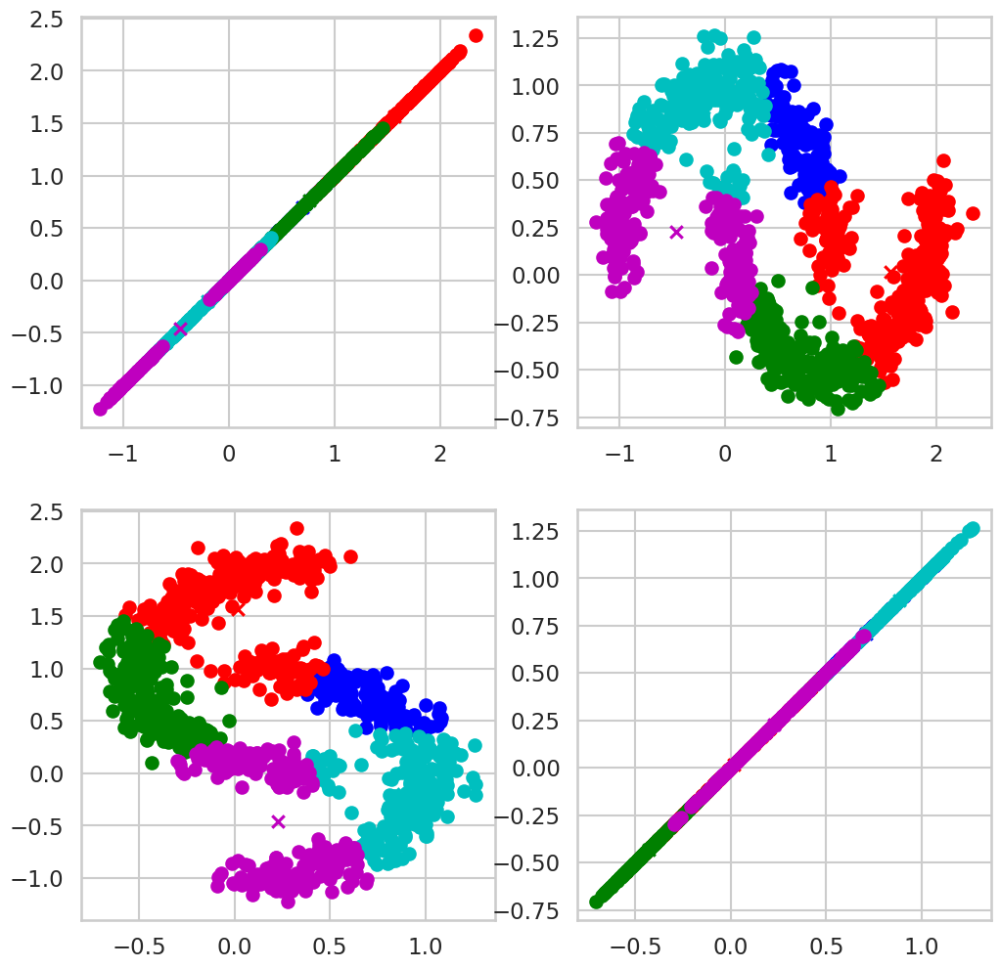

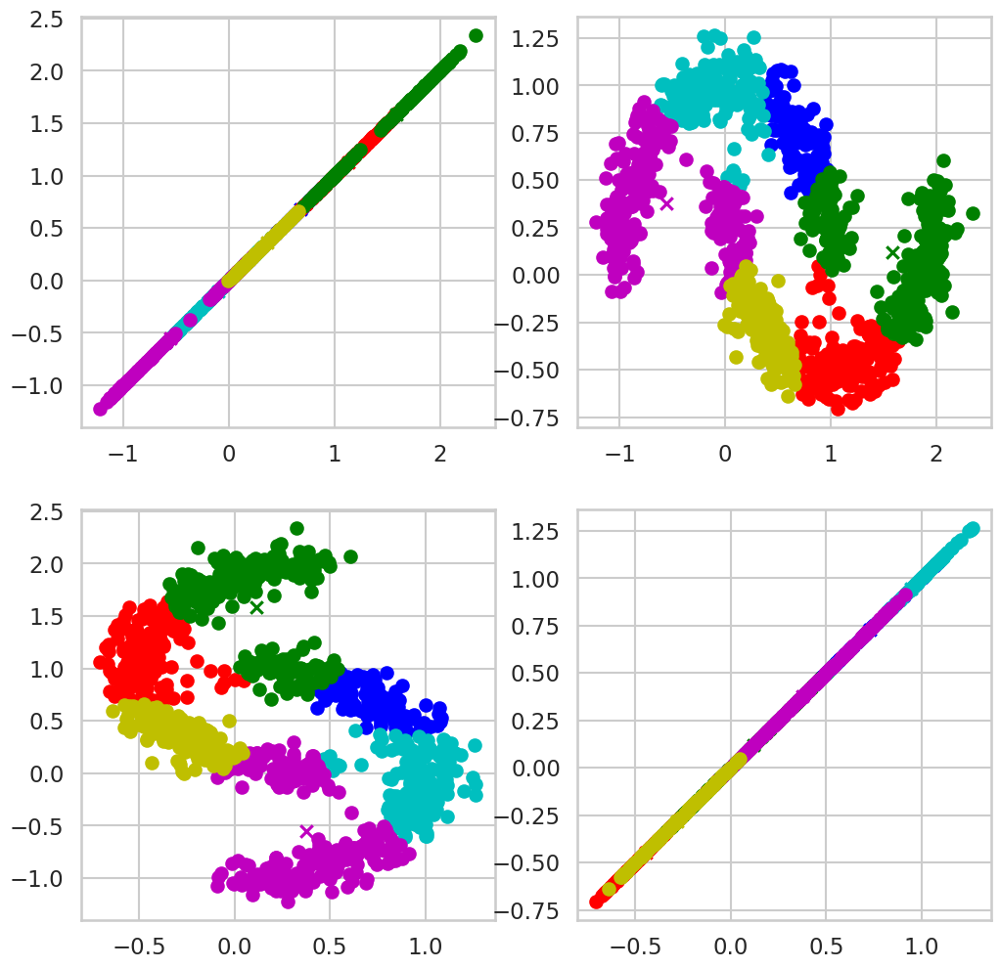

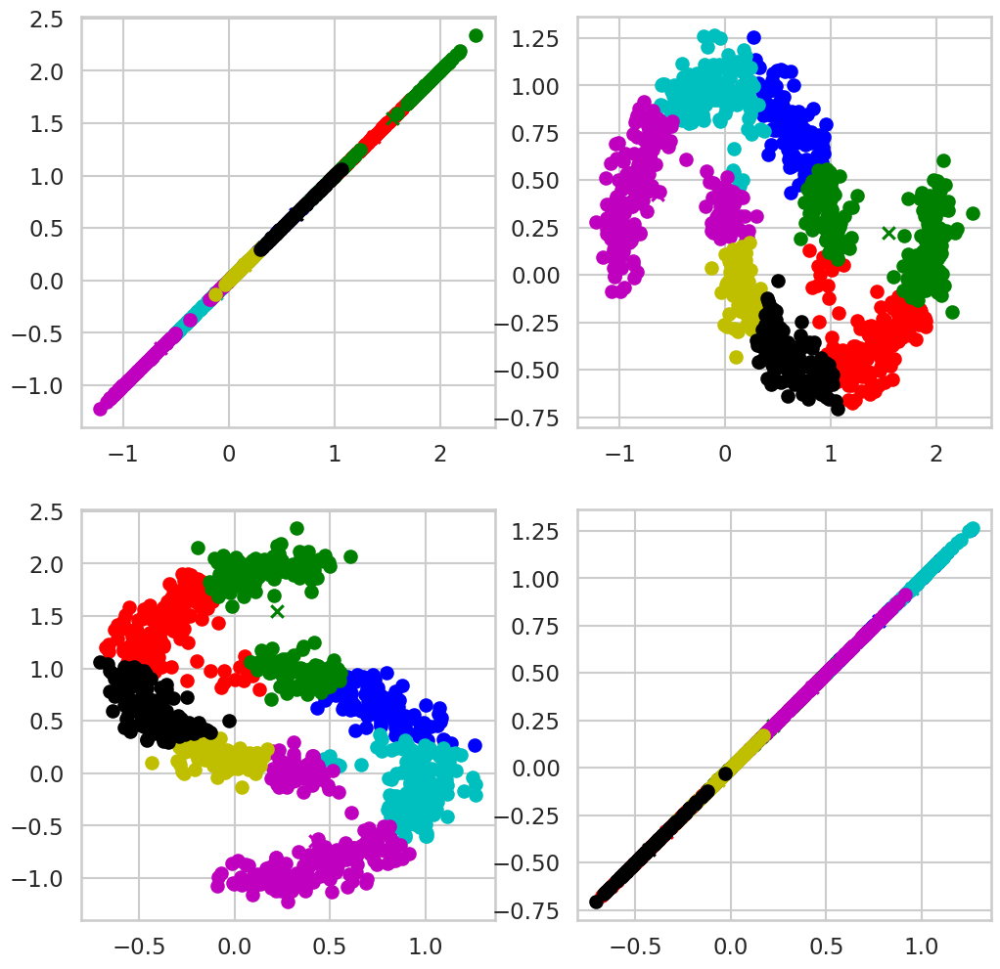

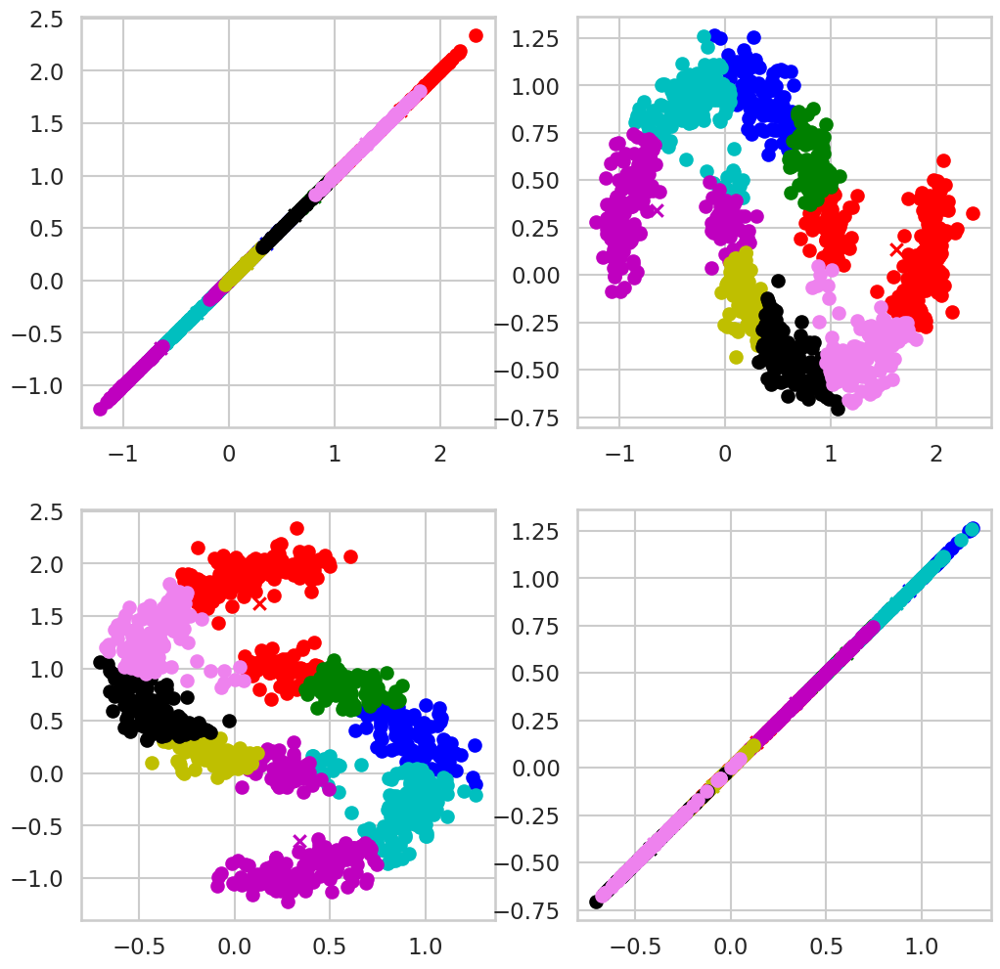

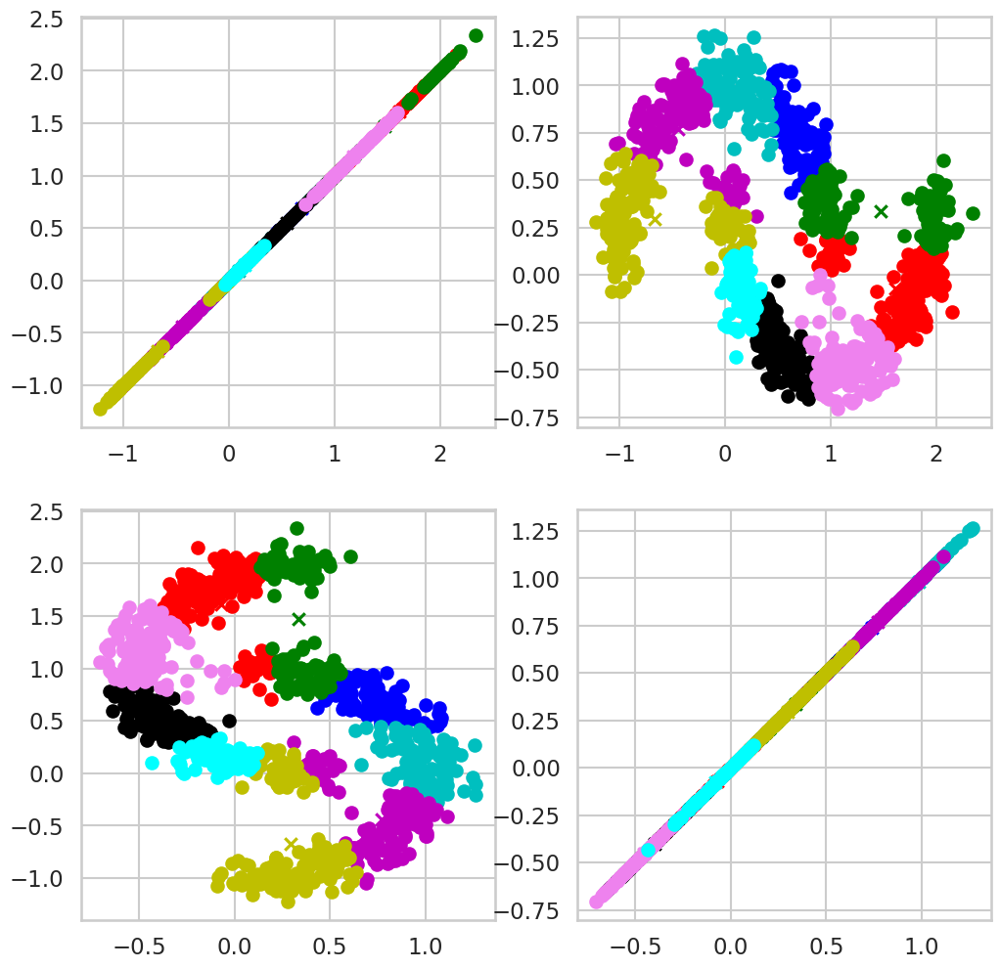

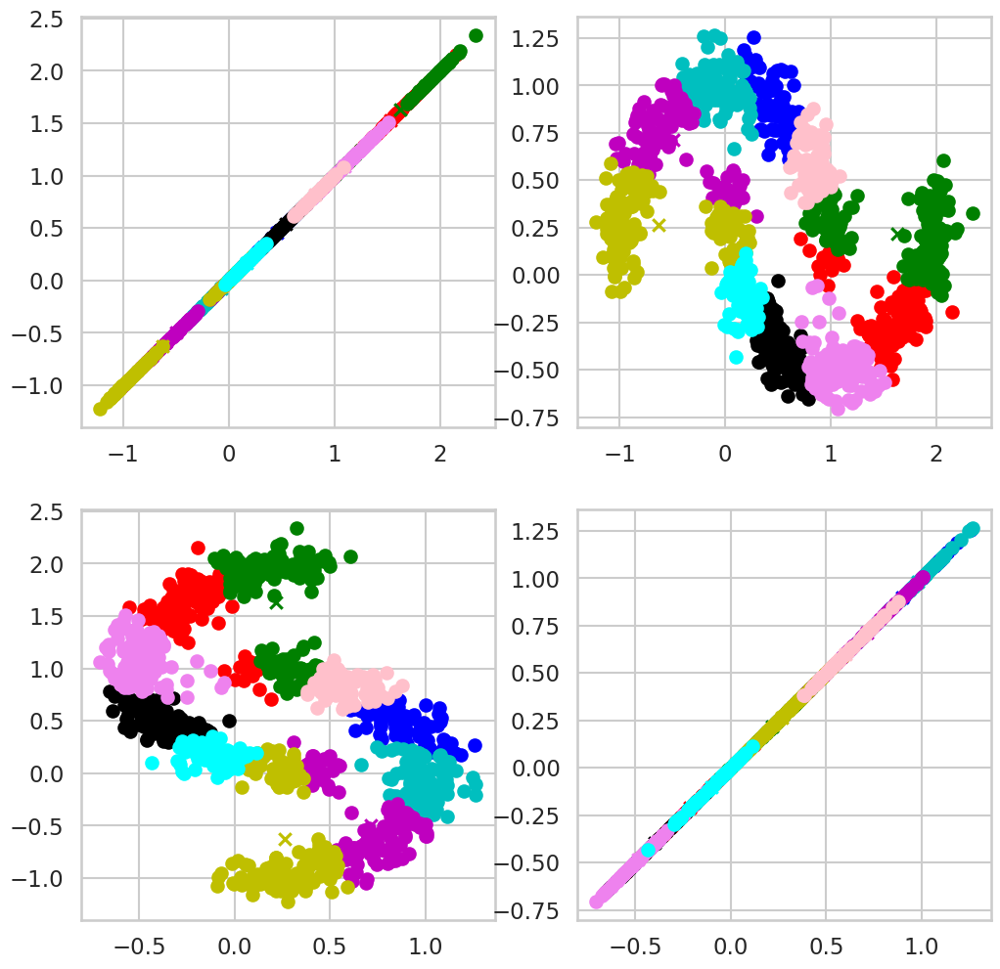

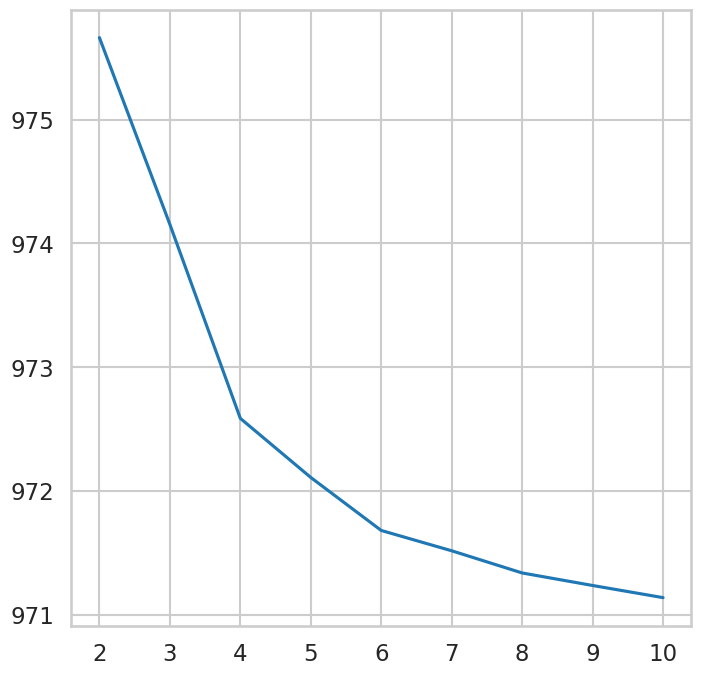

In [ ]:
n_samples = 1000
X, y = noisy_moons = make_moons(n_samples=n_samples, noise= .1)
distances=[]
a = [j for j in range (2,11)]
for i in range (2, 11):
  Number_of_Clusters = i
  Distance_Type = 'pearson'
  Final_Cluster_Distance, Cluster_Metric = GUC_Kmean(X, Number_of_Clusters, Distance_Type)
  print("Final Cluster Distance:", Final_Cluster_Distance)
  print("Cluster Metric:", Cluster_Metric)
  distances.append(Final_Cluster_Distance)
  #display_cluster(X,Number_of_Clusters)
plt.figure()
plt.plot(a,distances)

## 4. Using the GUC_Kmean function to segment customers int he provided customer dataset
1. Apply the GUC_Kmean fucntion to customer data  
2. Try a varing number of cluster that range from 2 to 10 cluster on each set
3. Display your results.
4. plot the Cluster Metric versus the number of clusters
4. Change the distance function and repeat the above steps

2
7
7
mean of centroid :  0  is :  16315.804499196573
mean of centroid :  1  is :  30887.743286788398
2
7
7
mean of centroid :  0  is :  15922.944894521537
mean of centroid :  1  is :  28360.328767123287
2
7
7
mean of centroid :  0  is :  15594.885966386555
mean of centroid :  1  is :  26861.235714285714
2
7
7
mean of centroid :  0  is :  15329.165833552574
mean of centroid :  1  is :  25871.875240662303
2
7
7
mean of centroid :  0  is :  15131.76986649714
mean of centroid :  1  is :  25216.400133824023
2
7
7
mean of centroid :  0  is :  15022.692036710856
mean of centroid :  1  is :  24879.539060068473
2
7
7
mean of centroid :  0  is :  14966.608361454819
mean of centroid :  1  is :  24707.070828331332
2
7
7
mean of centroid :  0  is :  14910.954592852404
mean of centroid :  1  is :  24541.31498116488
2
7
7
mean of centroid :  0  is :  14888.202666666666
mean of centroid :  1  is :  24474.745714285713
2
7
7
mean of centroid :  0  is :  14872.099187768754
mean of centroid :  1  is :  2

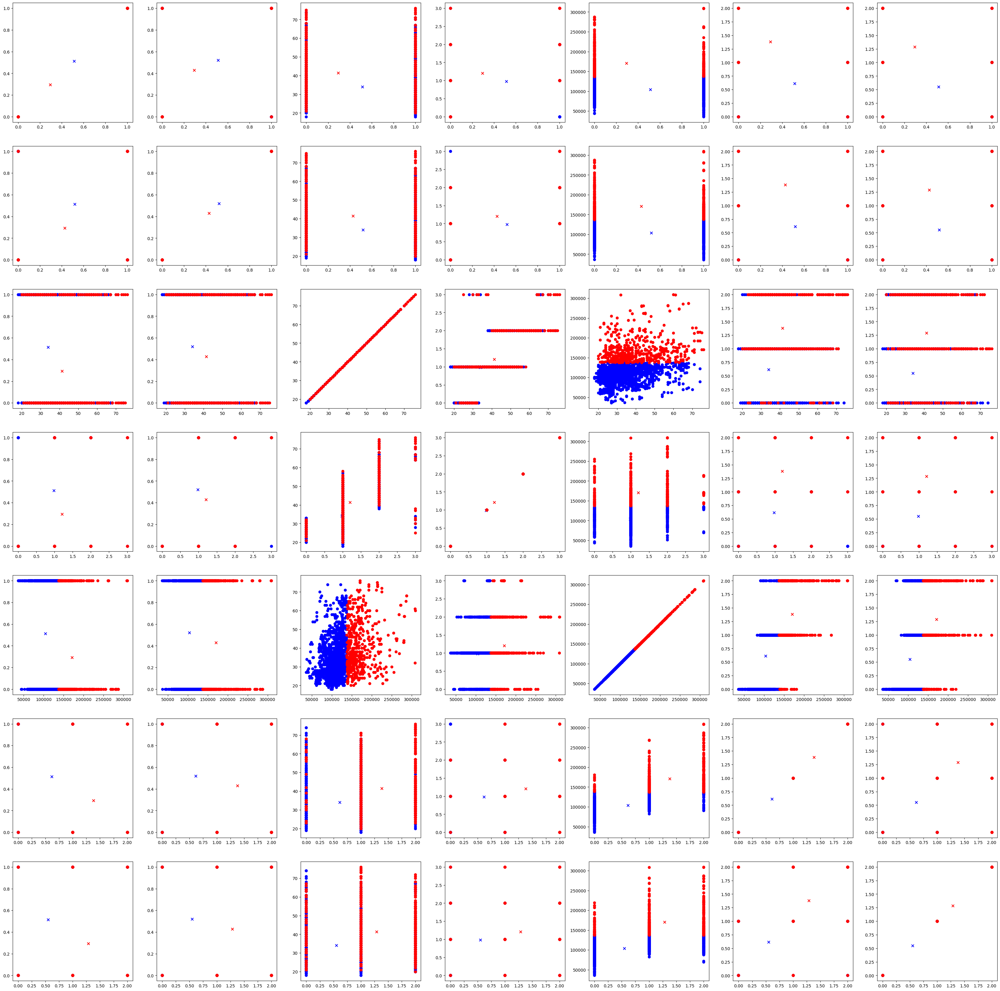

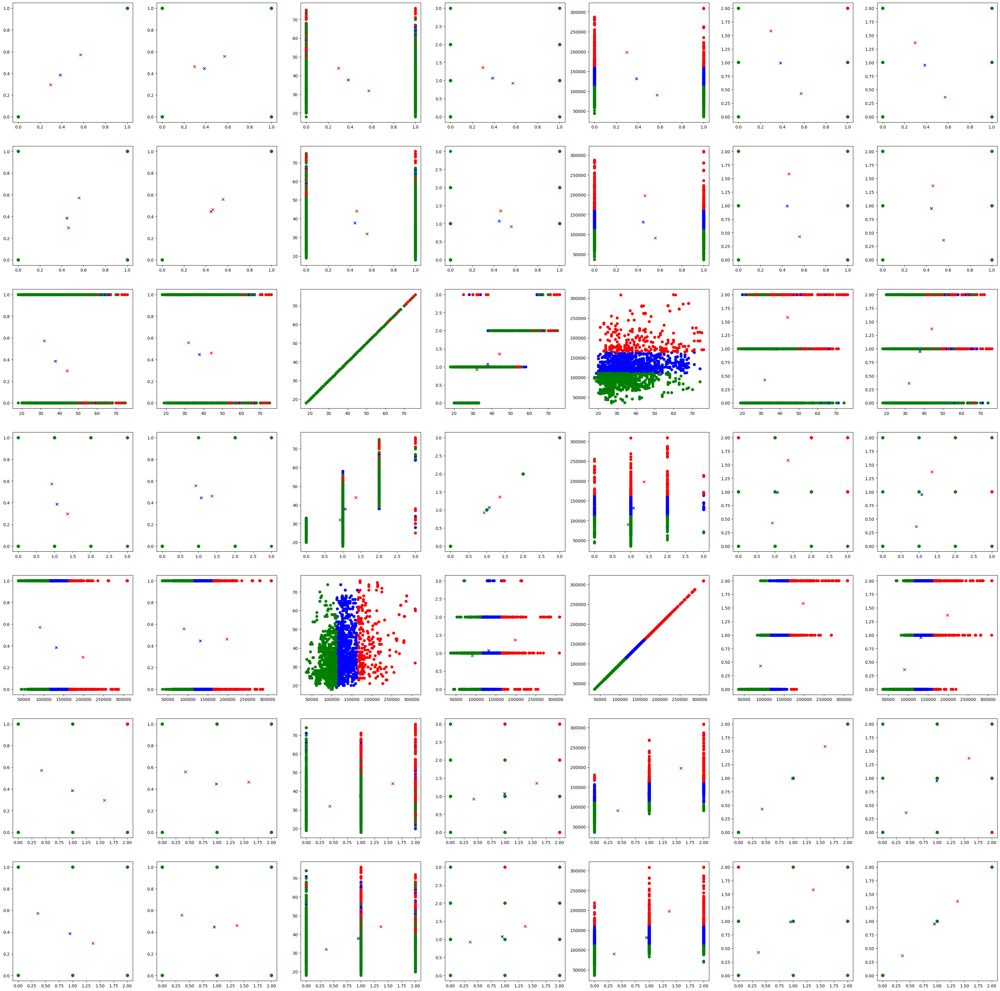

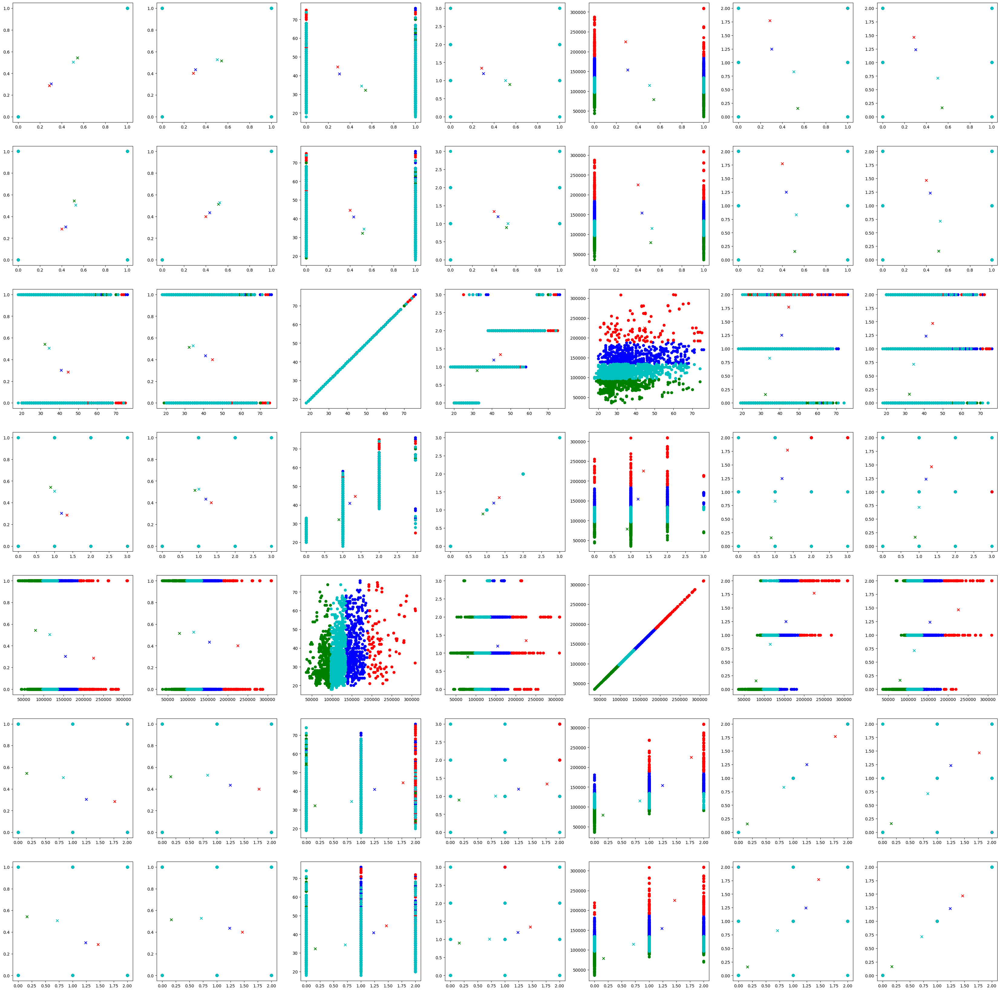

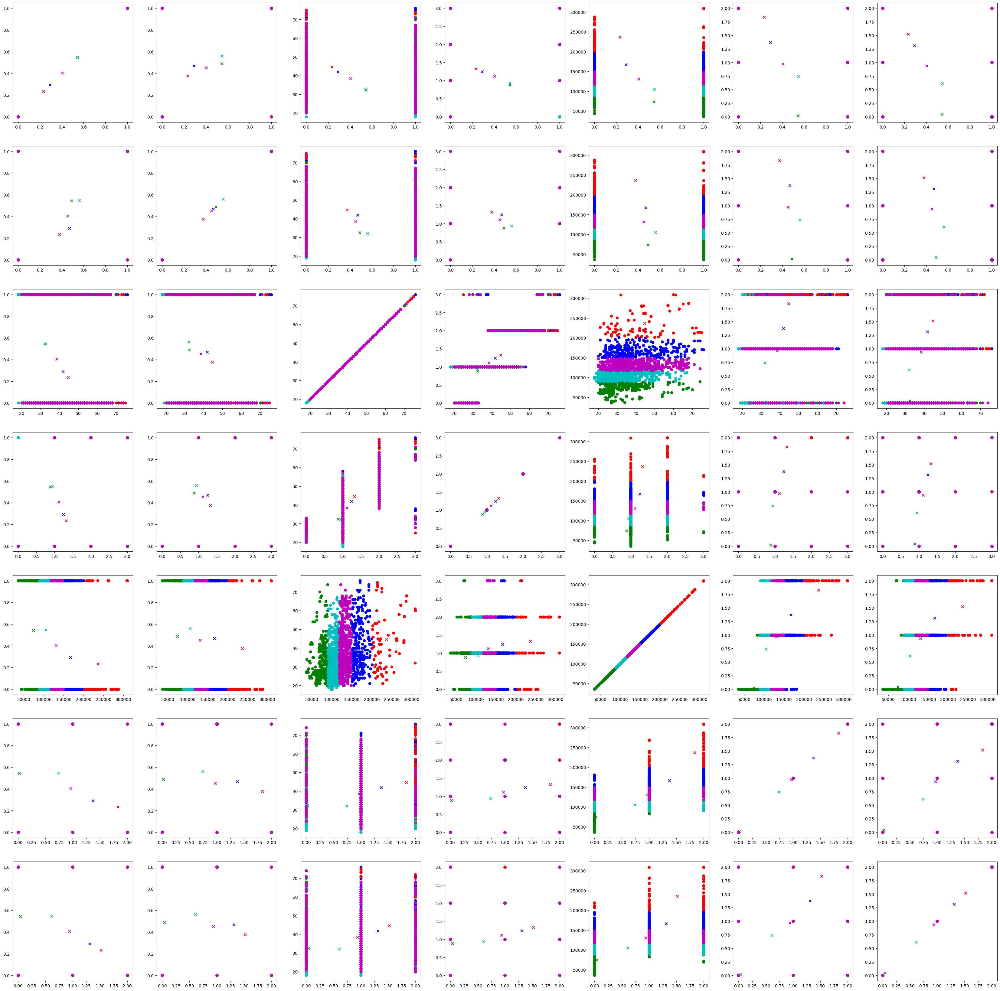

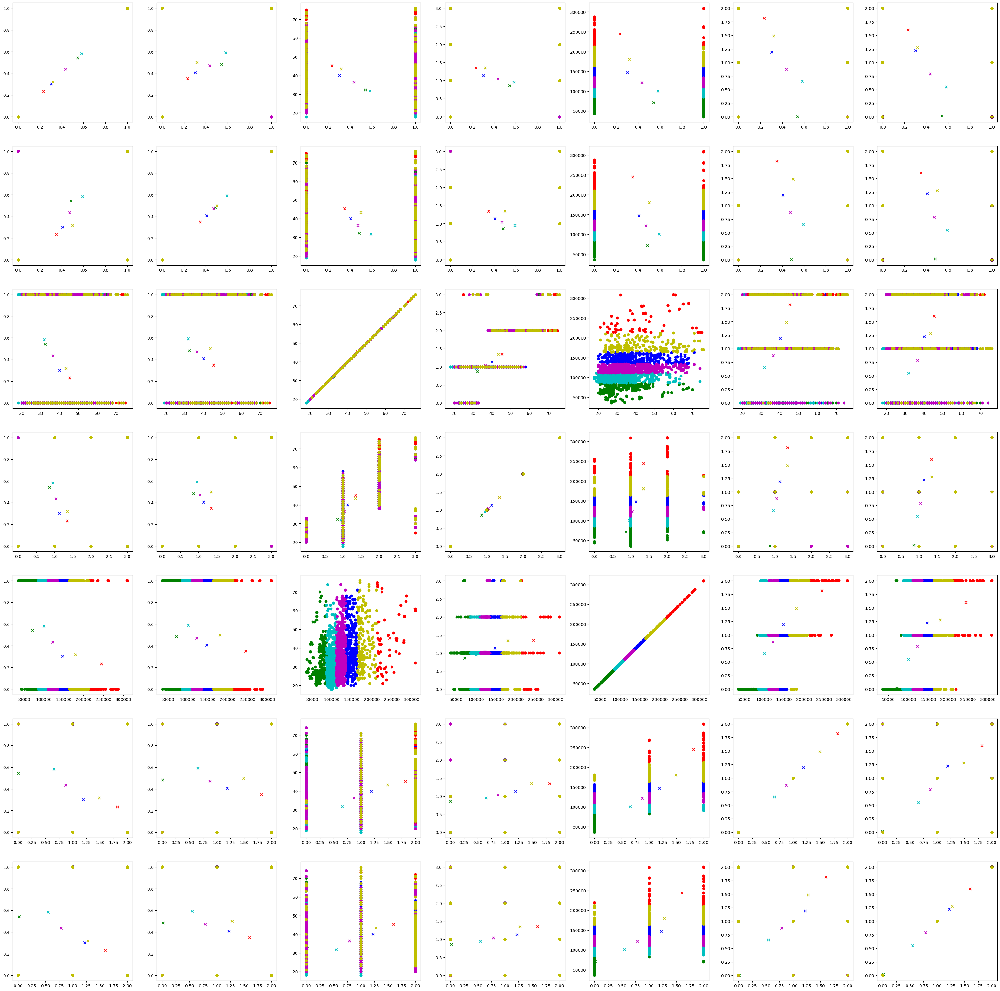

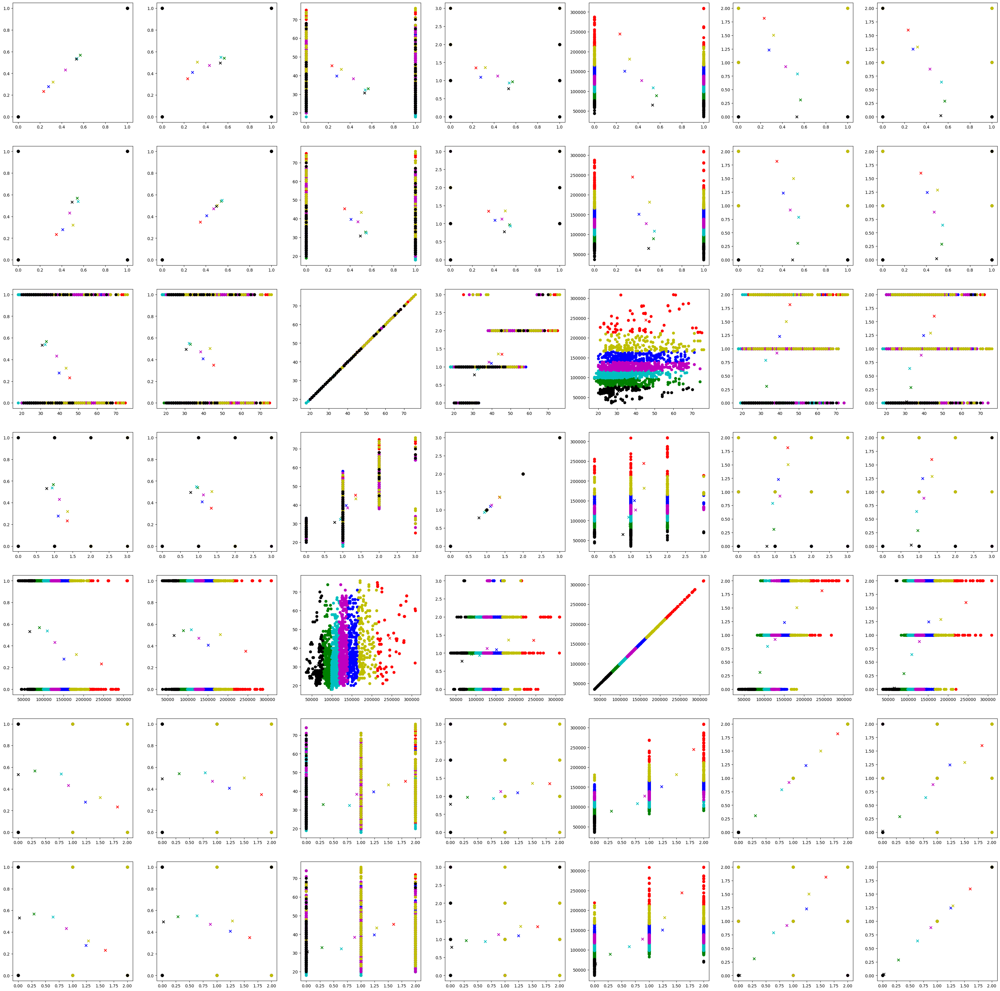

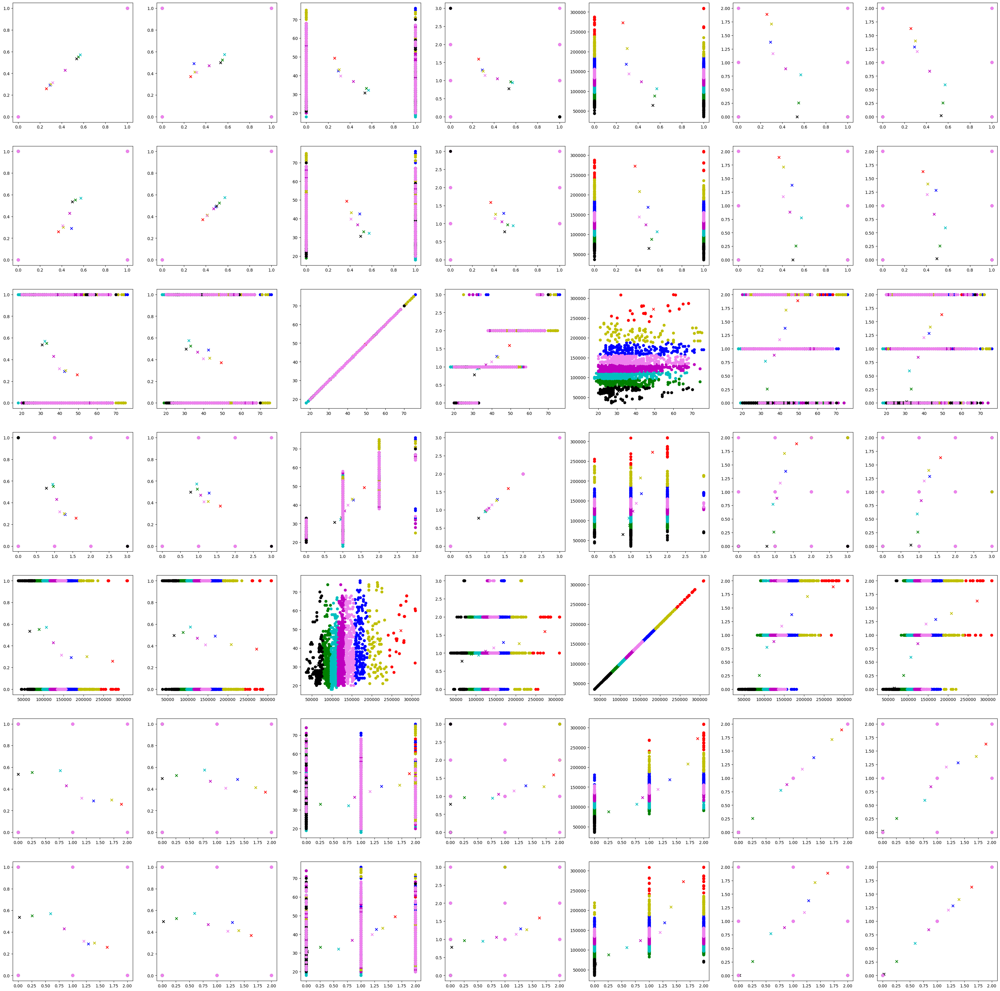

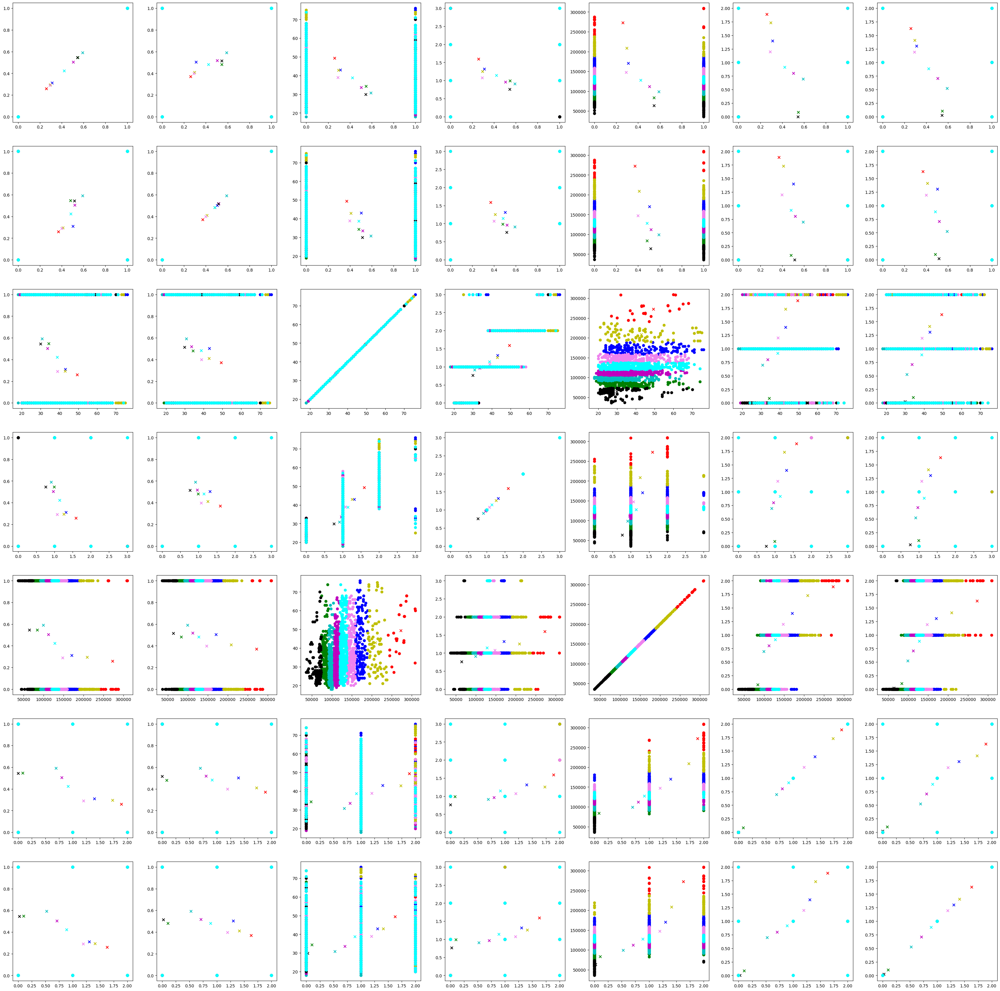

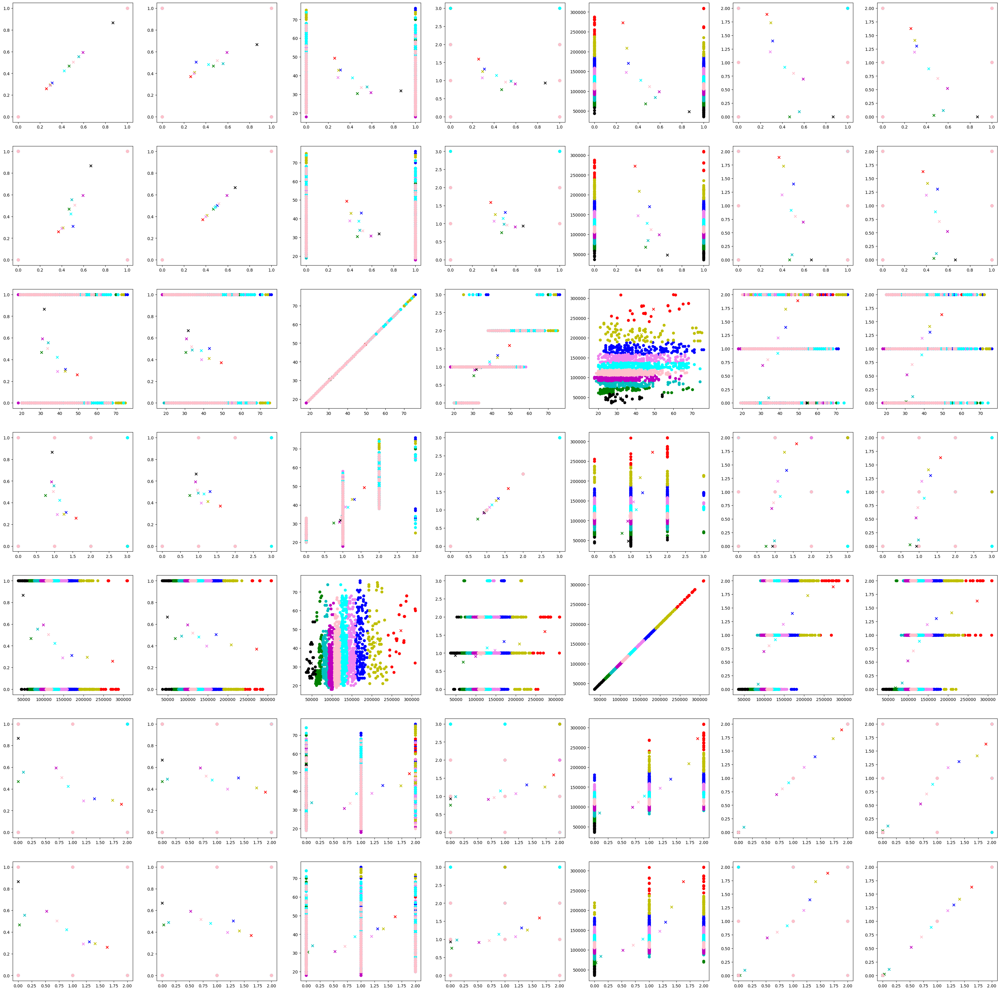

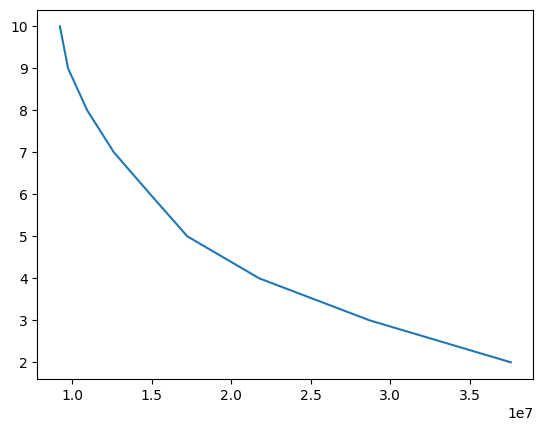

In [ ]:
# Load CSV file into a NumPy array
data_array = np.genfromtxt('/content/sample_data/Customer data.csv', delimiter=',')
data_array =data_array[1:,1:]
# print(data_array)
distances=[]
a = [j for j in range (2,11)]
for i in range (2, 11):
  Number_of_Clusters = i
  Distance_Type = 'euclidean'
  Final_Cluster_Distance, Cluster_Metric = GUC_Kmean(data_array, Number_of_Clusters, Distance_Type)
  # print("Final Cluster Distance:", Final_Cluster_Distance)
  # print("Cluster Metric:", Cluster_Metric)
  distances.append(Final_Cluster_Distance)
  #display_cluster(X,Number_of_Clusters)
plt.figure()
plt.plot(distances,a)

2
mean of centroid :  0  is :  13743.291919959473
mean of centroid :  1  is :  21866.10501310616
2
Final Cluster Distance: 1967.1808805046455
Cluster Metric: 1967.1808805046455
3
mean of centroid :  0  is :  12897.952380952382
mean of centroid :  1  is :  21866.10501310616
mean of centroid :  2  is :  15324.270447110142
3
Final Cluster Distance: 1967.1808798392535
Cluster Metric: 1967.1808798392535
4
mean of centroid :  0  is :  13517.526846729581
mean of centroid :  1  is :  20167.69235095613
mean of centroid :  2  is :  13887.139332365747
mean of centroid :  3  is :  22564.15811373093
4
Final Cluster Distance: 1967.1808787314856
Cluster Metric: 1967.1808787314856
5
mean of centroid :  0  is :  12943.76527093596
mean of centroid :  1  is :  18512.94964028777
mean of centroid :  2  is :  14589.506256517205
mean of centroid :  3  is :  21989.312591294187
mean of centroid :  4  is :  23529.384074941452
5
Final Cluster Distance: 1967.1808778185944
Cluster Metric: 1967.1808778185944
6
mean

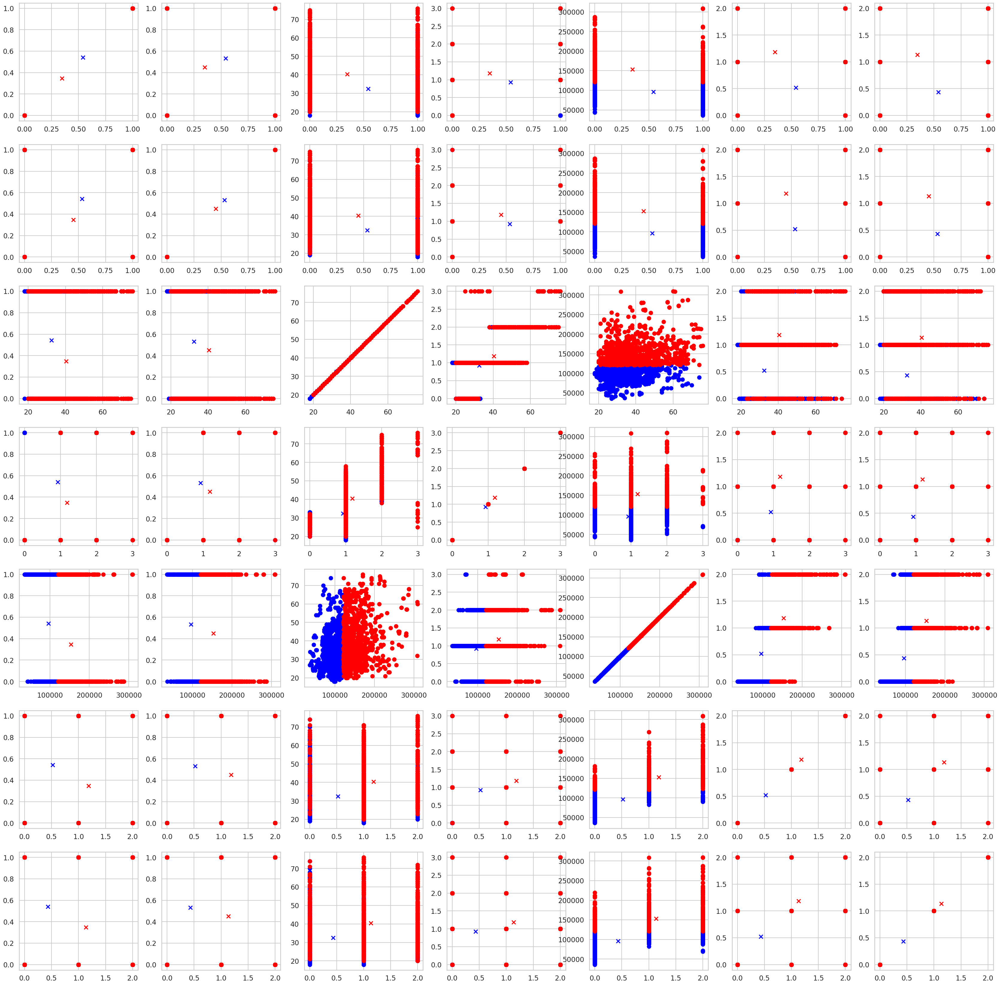

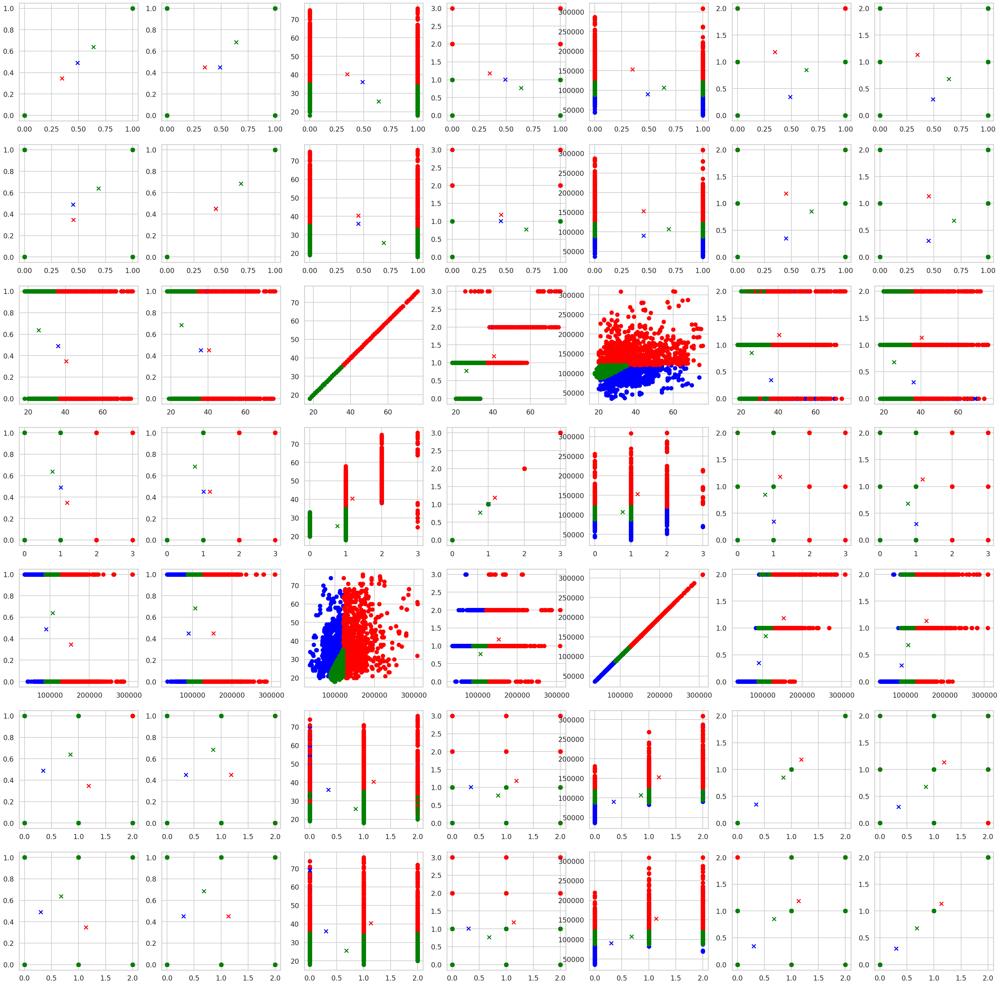

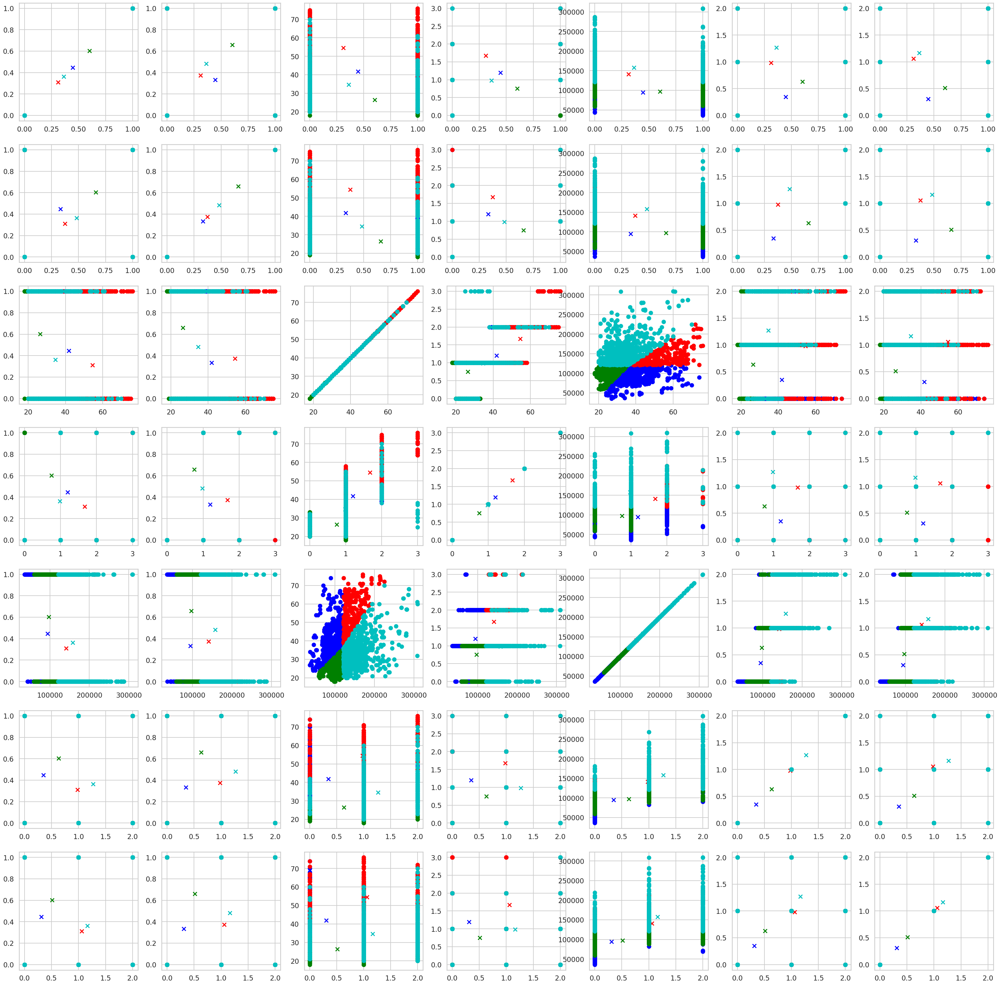

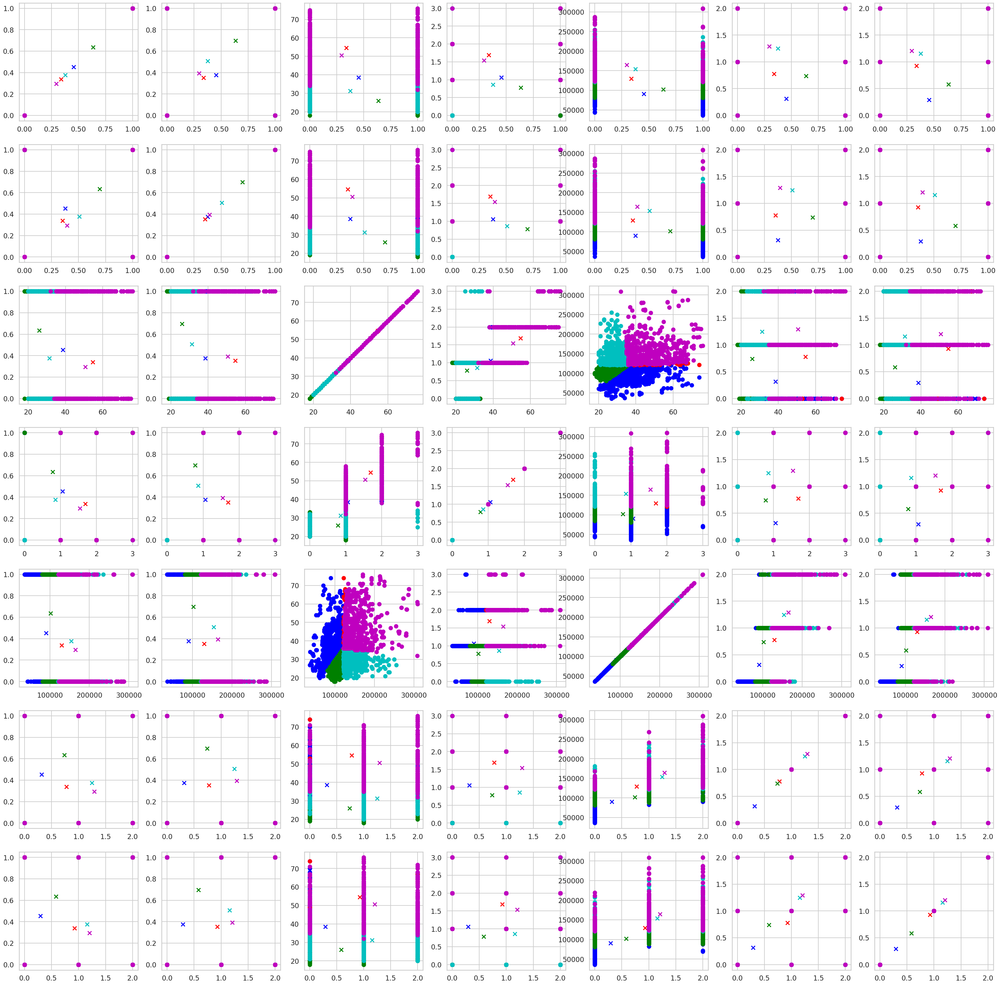

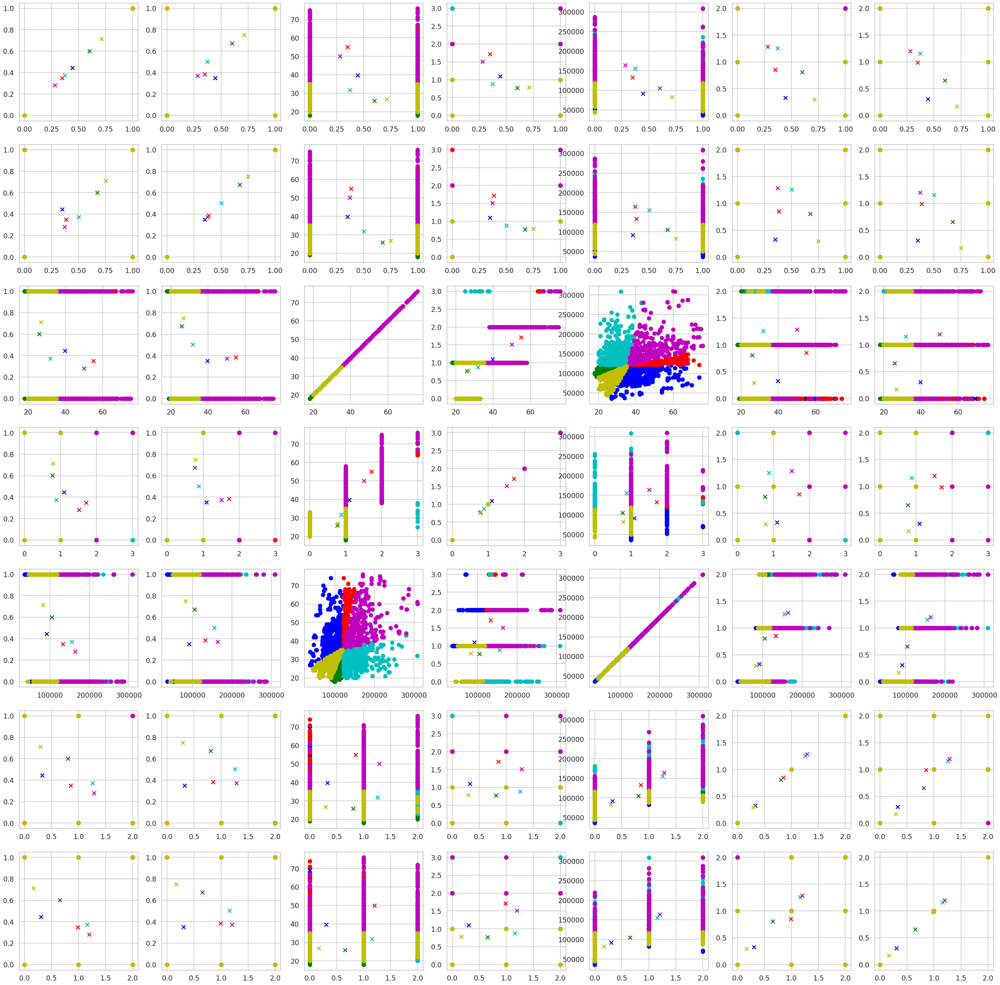

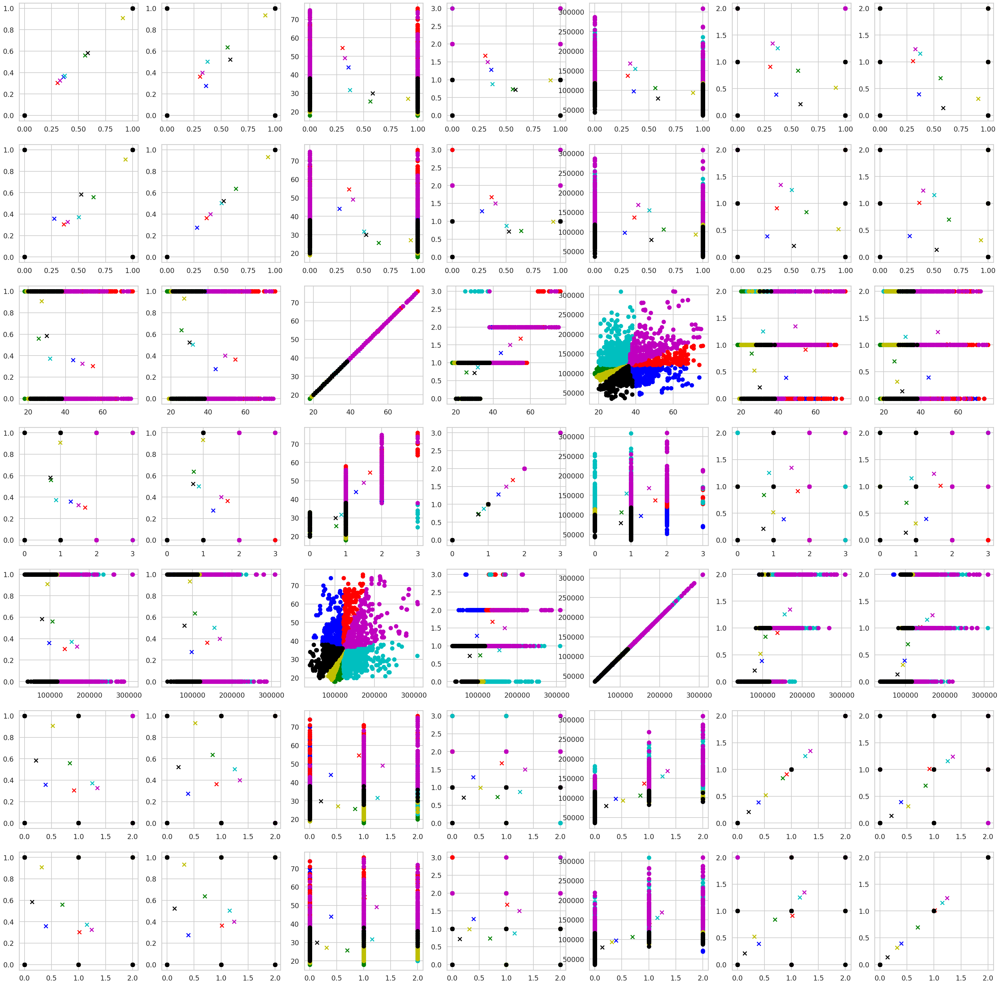

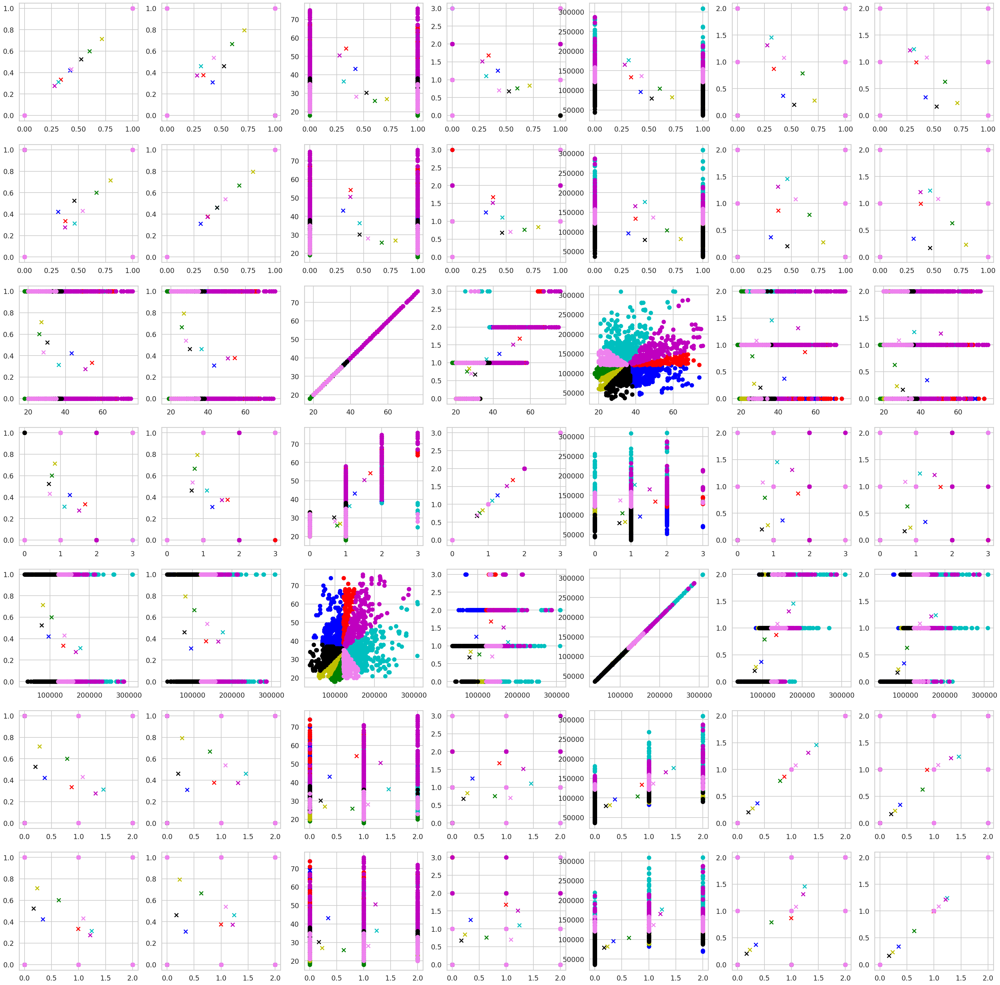

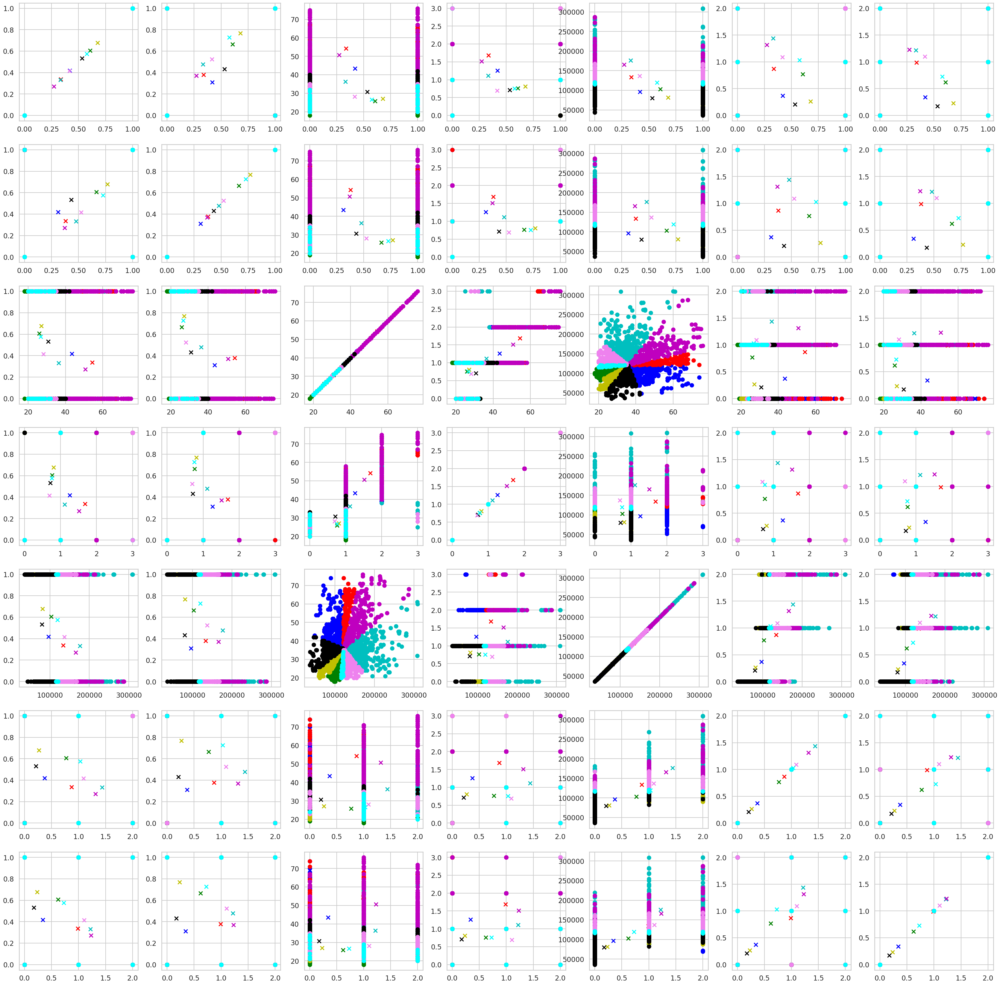

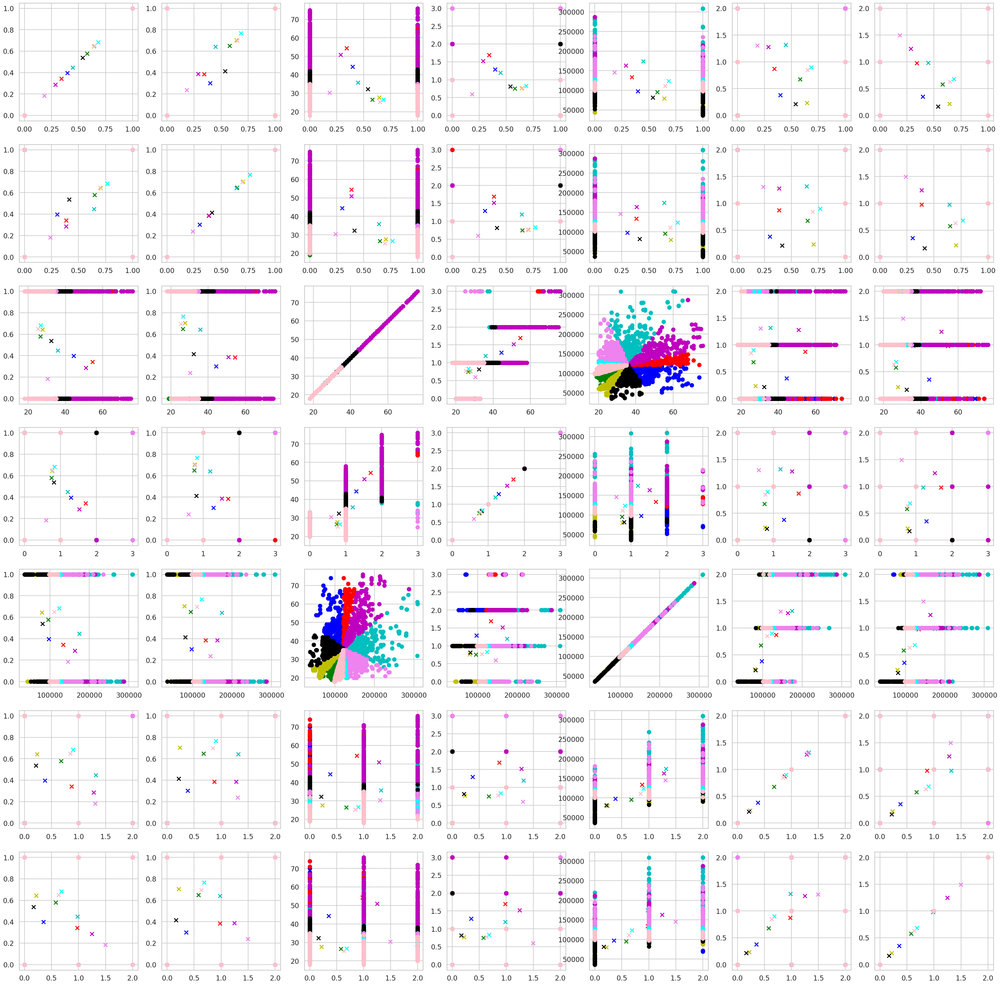

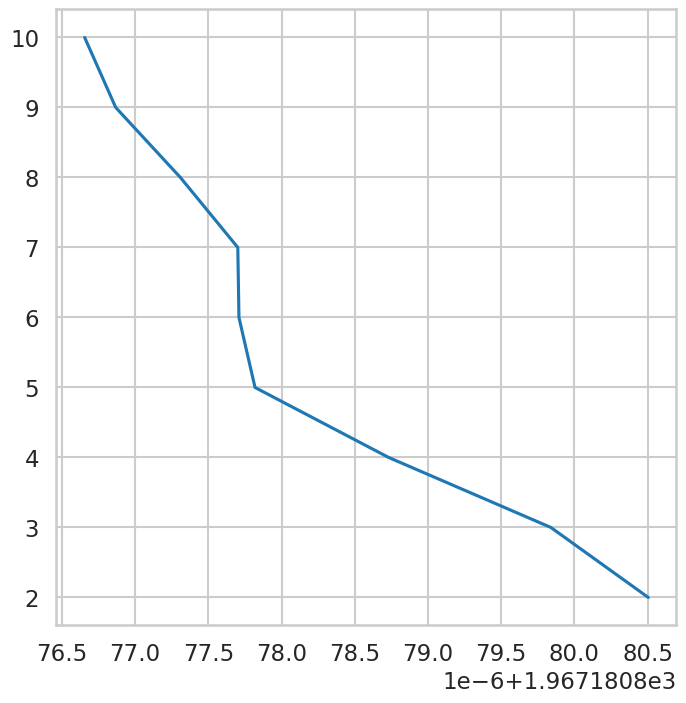

In [ ]:
# Load CSV file into a NumPy array
data_array = np.genfromtxt('/content/sample_data/Customer data.csv', delimiter=',')
data_array =data_array[1:,1:]
# print(data_array)
distances=[]
a = [j for j in range (2,11)]
for i in range (2, 11):
  Number_of_Clusters = i
  Distance_Type = 'pearson'
  Final_Cluster_Distance, Cluster_Metric = GUC_Kmean(data_array, Number_of_Clusters, Distance_Type)
  print("Final Cluster Distance:", Final_Cluster_Distance)
  print("Cluster Metric:", Cluster_Metric)
  distances.append(Final_Cluster_Distance)
  #display_cluster(X,Number_of_Clusters)
plt.figure()
plt.plot(distances,a)